In [157]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pylab import *

In [158]:
IMAGE_DIM = 128

In [164]:
def get_trajectory(img, weight_factor):
    
    # Iterative algorithm. Begins at bottom of image and computes middle of green
    # area for each succesive row. The weight of that decision becomes less and 
    # less as the row index "decreases" -> gets farther away from car, scaled the weight_factor passed in. 
    # A lower weight_factor (< 1 leads to problems) leads to more sensitive changes. Stops when first all 
    # "red" row encountered or reached top of image and returns (x, y) coordinates of trajectory vector
    
    weight, scaling_factor = 1, weight_factor
    left, right = 0, IMAGE_DIM - 1
    center, trajectory_x, trajectory_y = 0, 0, 0
    
    for i in np.arange(IMAGE_DIM - 1, -1, -1):
        for j in np.arange(IMAGE_DIM):
            
            if img[i][j] == 1 and left is 0:
                left = j
            elif img[i][j] == 0 and right is IMAGE_DIM - 1 and left is not 0:
                right = j - 1
                
        if left is 0 and img[i][0] == 0: # reached all "red" row
            trajectory_y = i + 1 # this seems weird but it's because we are iterating through rows in reverse
            break
            
        mid = (left + right) / 2
        if i == IMAGE_DIM - 1:
            center = mid
            trajectory_x = center
            
        trajectory_x = trajectory_x + ((mid - trajectory_x) * weight)
        left, right = 0, IMAGE_DIM - 1
        weight /= scaling_factor
        
    return [(trajectory_x, trajectory_y), center]
    

In [165]:
def get_arrow_info(trajectory, center):
    x = center
    y = IMAGE_DIM - 1
    dx = trajectory[0] - x
    dy = -1 * (y - trajectory[1])
    
    return [x, y, dx, dy]

# Frame 1

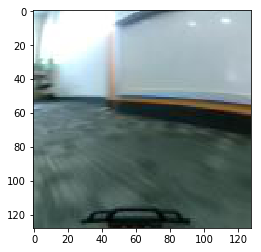

In [166]:
img1 = mpimg.imread("../donkey_car/tub/273_cam-image_array_.jpg")
imgplot = plt.imshow(img1)
plt.show()

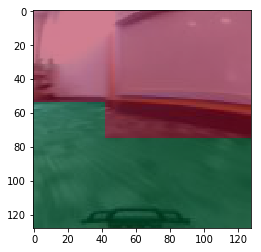

In [167]:
# Constructing approximate bitmap for now, this step will be replaced with MACHINE LEARNING

mask1 = np.zeros((128, 128))
left_wall = 0
right_wall = 0
sky = 75
for i in np.arange(128):
    for j in np.arange(128):
        if j < left_wall or j > IMAGE_DIM - right_wall or i < sky:
            mask1[i][j] = 0
        else:
            mask1[i][j] = 1
        if i > 53 and i < sky and j < 42:
            mask1[i][j] = 1
        
            
plt.figure()
plt.imshow(mask1, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img1, alpha = 0.5)
plt.show()

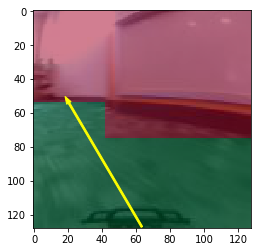

Feedback Trajectory:  (20.5, 54)


In [168]:
# Get and plot trajectory

feedback_trajectory, feedback_center = get_trajectory(mask1, 1.0001)
x1, y1, dx1, dy1 = get_arrow_info(feedback_trajectory, feedback_center)
plt.figure()
plt.arrow(x1, y1, dx1, dy1, width = 1, color = "yellow")
plt.imshow(mask1, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img1, alpha = 0.5)
plt.show()

print("Feedback Trajectory: ", feedback_trajectory)

# Frame 2

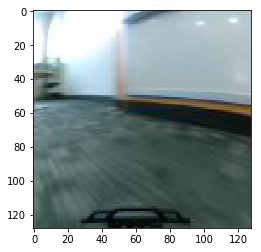

In [169]:
img2 = mpimg.imread("../donkey_car/tub/274_cam-image_array_.jpg")
img2plot = plt.imshow(img2)
plt.show()

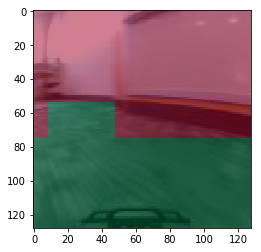

In [170]:
# Constructing approximate bitmap for now, this step will be replaced with MACHINE LEARNING

mask2 = np.zeros((128, 128))
left_wall = 0
right_wall = 0
sky = 75
for i in np.arange(128):
    for j in np.arange(128):
        if j < left_wall or j > IMAGE_DIM - right_wall or i < sky:
            mask2[i][j] = 0
        else:
            mask2[i][j] = 1
        if i > 53 and i < sky and j > 8 and j < 48:
            mask2[i][j] = 1
            
plt.figure()
plt.imshow(mask2, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img2, alpha = 0.5)
plt.show()

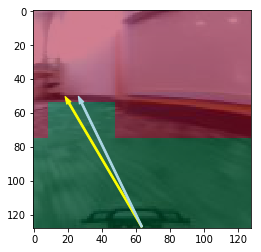

Target trajectory:  (28.0, 54)


In [171]:
# Get and plot trajectory

target_trajectory, target_center = get_trajectory(mask2, 1.00001)
x2, y2, dx2, dy2 = get_arrow_info(target_trajectory, target_center)
plt.figure()

plt.arrow(x1, y1, dx1, dy1, width = 1, color = "yellow")
plt.arrow(x2, y2, dx2, dy2, width = 1, color = "lightblue")

plt.imshow(mask2, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img2, alpha = 0.5)
plt.show()

print("Target trajectory: ", target_trajectory)

# Get actual trajectory from PID Controller

In [172]:
# Implement PID Controller itself, but first we need to scale error by dimensions of image
feedback = feedback_trajectory[0] / IMAGE_DIM
target = target_trajectory[0] / IMAGE_DIM

print("Scaled feedback trajectory:", feedback)
print("Scaled target trajectory:", target)

# Use x-value to control steering angle
# Use y-value to control throttle

Scaled feedback trajectory: 0.16015625
Scaled target trajectory: 0.21875


In [173]:
import time
class PIDController():
    
    def __init__(self, P = 0, I = 0, D = 0):
        
        # Constants to be tuned
        self.Kp = P
        self.Ki = I
        self.Kd = D
        
        # For integral term
        self.cumulative_error = 0
        
        # Initializing the time to time.time() leads to non-determinism
        self.prev_time = time.time()
        self.curr_time = 0
        
        # Error values
        self.prev_error = 0
        self.curr_error = 0
        
        
    def update(self, target, feedback, debug = False):
        
        self.curr_error = target - feedback
        de = self.curr_error - self.prev_error
        
        self.curr_time = time.time()
        dt = self.curr_time - self.prev_time
        
        p = self.Kp * self.curr_error
        
        self.cumulative_error += self.curr_error * dt
        i = self.Ki * self.cumulative_error
        
        d = self.Kd * (de / dt)
        
        output = p + i + d
        
        self.prev_error = self.curr_error
        self.prev_time = self.curr_time
        
        if debug:
            print('p:', p)
            print('i:', i)
            print('d:', d)
            print('de:', de)
            print('dt:', dt)

        return output     

In [174]:
P = 1.2
I = 1
D = 0.00001

In [175]:
pid = PIDController(P, I, D)
output = pid.update(target, feedback, debug = False)

In [176]:
# Scale back to actual shift and get pid trajectory
actual = output * IMAGE_DIM
pid_trajectory = (actual + feedback_trajectory[0], feedback_trajectory[1])
print("PID trajectory:", pid_trajectory)

PID trajectory: (31.37275755026681, 54)


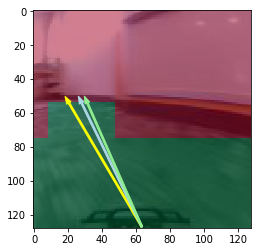

Feedback Trajectory (yellow): 20.5
Target Trajectory (blue): 28.0
PID Trajectory (green): 31.37275755026681


In [177]:
x_pid, y_pid, dx_pid, dy_pid = get_arrow_info(pid_trajectory, target_center)
plt.figure()

plt.arrow(x1, y1, dx1, dy1, width = 1, color = "yellow")
plt.arrow(x2, y2, dx2, dy2, width = 1, color = "lightblue")
plt.arrow(x_pid, y_pid, dx_pid, dy_pid, width = 1, color = "lightgreen")

plt.imshow(mask2, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img2, alpha = 0.5)
plt.show()

print("Feedback Trajectory (yellow):", feedback_trajectory[0])
print("Target Trajectory (blue):", target_trajectory[0])
print("PID Trajectory (green):", pid_trajectory[0])

# Experimenting with Canny Edge Detection as a means for replacing lane classification (for now)

In [178]:
import cv2
np.set_printoptions(threshold=np.nan)

In [179]:
def edges_to_mask(edges):
    mask = np.ones((IMAGE_DIM, IMAGE_DIM))
    bad_cols = []
    buffer_x = np.arange(20, 100) ### NOT WORKING FOR SOME REASON
    buffer_y = np.arange(110, IMAGE_DIM) # Buffer so that front bumper is considered ok to drive towards
    
    for i in np.arange(IMAGE_DIM - 1, -1, -1):
        for j in np.arange(IMAGE_DIM):
            
            if j in bad_cols:
                mask[i][j] = 0
            
            if edges[i][j] and i not in buffer_y:
                mask[i][j] = 0
                # If an edge is detected, nowhere "ahead" in that path can be driven towards, 
                # so mask all further rows in that column
                bad_cols.append(j)
            
                
    return mask

In [180]:
edges_list = []
mask_list = []


# for x in range(35, 1024):
for x in range(273, 274):

    filename = "../donkey_car/tub/" + str(x) + "_cam-image_array_.jpg"
    img = cv2.imread(filename, 0) # second arg: >0 = color, 0 = greyscale

    edges = cv2.Canny(img, 100, 200)
    edges_list += [edges]
        
    mask = edges_to_mask(edges)

# 	cv2.imshow("Grey", img)
# 	cv2.imshow("Edges", edges)

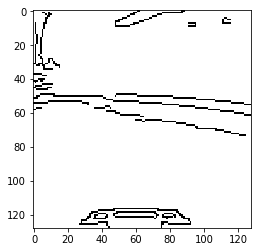

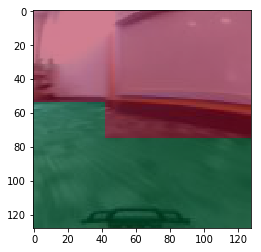

In [181]:
# for edges in edges_list:
plt.figure()
plt.imshow(edges, cmap = "binary", interpolation='none')
plt.figure()
plt.imshow(mask1, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img1, alpha = 0.5)
#     plt.figure()
#     plt.imshow(img_fast, cmap = "binary", interpolation = 'none')
#     plt.figure()
#     plt.imshow(st_corner, cmap = "binary", interpolation = 'none')

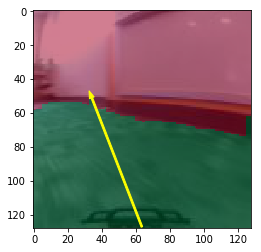

Feedback Trajectory:  (33.999993534686716, 51)


<Figure size 432x288 with 0 Axes>

In [182]:
feedback_trajectory, feedback_center = get_trajectory(mask, 1.0001)
x1, y1, dx1, dy1 = get_arrow_info(feedback_trajectory, feedback_center)
plt.figure()
plt.arrow(x1, y1, dx1, dy1, width = 1, color = "yellow")
plt.imshow(mask, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img1, alpha = 0.5)
plt.show()
plt.savefig("temp.png")

print("Feedback Trajectory: ", feedback_trajectory)

# Now everything together!

In [183]:
edges_list = []
mask_list = []
img_list = []

for x in range(35, 1024):
# for x in range(273, 280):

    filename = "../donkey_car/tub/" + str(x) + "_cam-image_array_.jpg"
    img = cv2.imread(filename, 0) # second arg: >0 = color, 0 = greyscale
    img_list += [img]

    edges = cv2.Canny(img, 100, 200)
    edges_list += [edges]
        
    mask = edges_to_mask(edges)
    mask_list += [mask]

# 	cv2.imshow("Grey", img)
# 	cv2.imshow("Edges", edges)

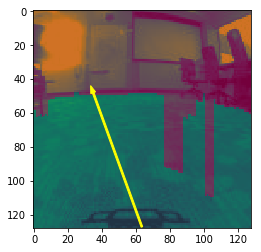

Feedback Trajectory:  (34.807995277776755, 48)


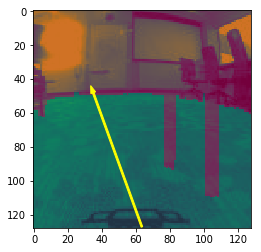

Feedback Trajectory:  (34.841990333305354, 48)


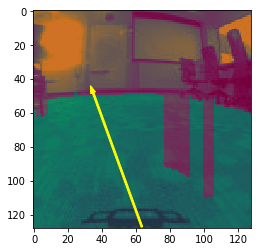

Feedback Trajectory:  (34.74900577025645, 48)


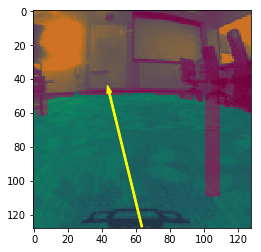

Feedback Trajectory:  (44.25399263212731, 48)


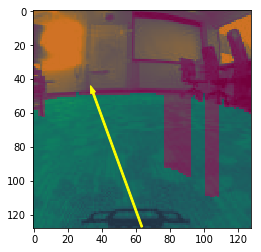

Feedback Trajectory:  (34.734792677080534, 48)


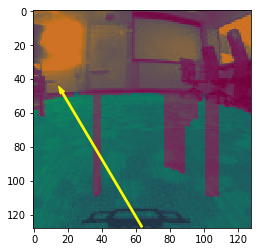

Feedback Trajectory:  (16.702838009388802, 48)


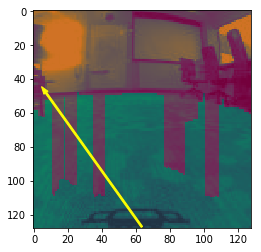

Feedback Trajectory:  (7.0048617258632655, 48)


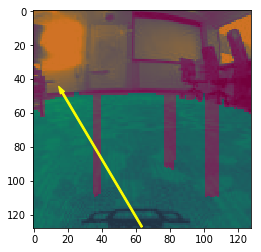

Feedback Trajectory:  (16.71623877101191, 48)


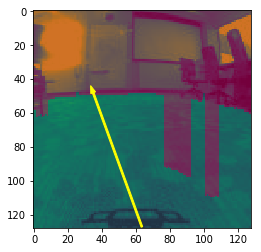

Feedback Trajectory:  (34.80776423927837, 48)


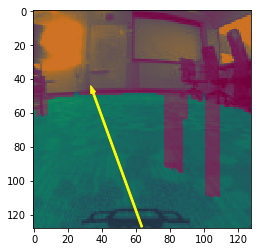

Feedback Trajectory:  (34.807995277776755, 48)


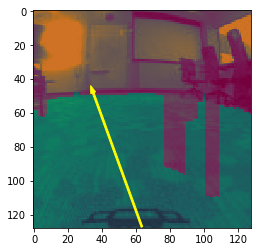

Feedback Trajectory:  (34.80690135010637, 48)


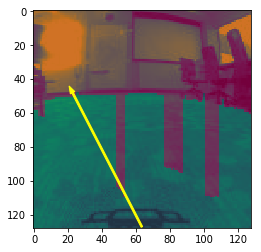

Feedback Trajectory:  (22.687533317078163, 48)


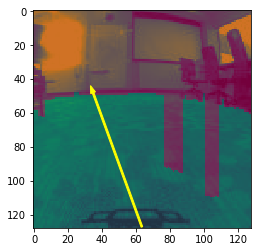

Feedback Trajectory:  (34.74524569892627, 48)


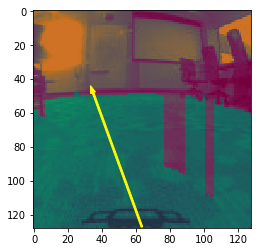

Feedback Trajectory:  (34.74295759486494, 48)


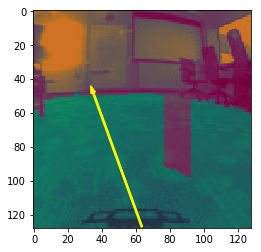

Feedback Trajectory:  (34.81857748054948, 48)


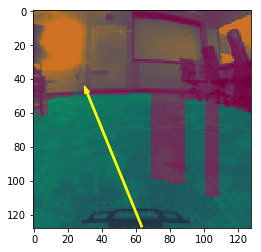

Feedback Trajectory:  (31.26410910647712, 48)


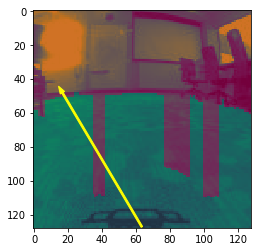

Feedback Trajectory:  (16.702838009388802, 48)


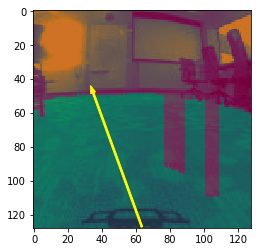

Feedback Trajectory:  (34.78305313621226, 48)


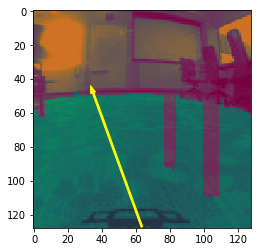

Feedback Trajectory:  (34.76454089149852, 48)


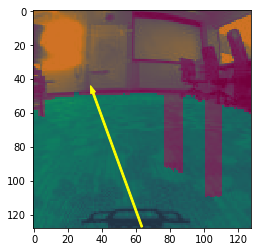

Feedback Trajectory:  (34.74325697280942, 48)


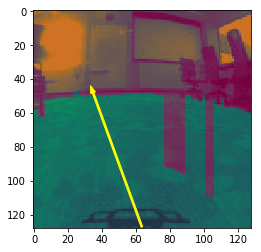

Feedback Trajectory:  (34.72922736392771, 48)


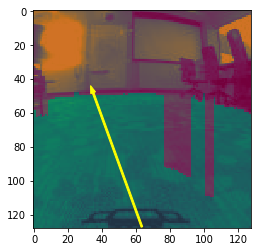

Feedback Trajectory:  (34.7751074360972, 48)


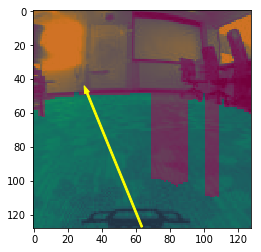

Feedback Trajectory:  (31.170457448823694, 48)


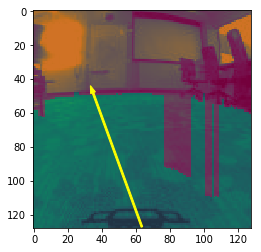

Feedback Trajectory:  (34.70551793812516, 48)


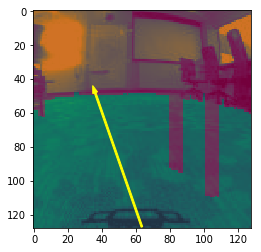

Feedback Trajectory:  (35.97775315083098, 48)


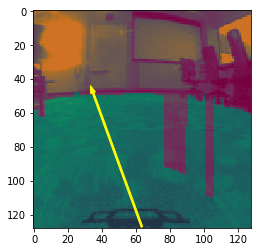

Feedback Trajectory:  (34.719756257381476, 48)


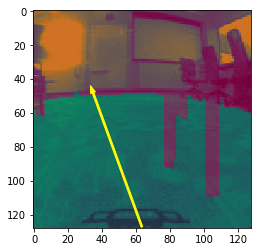

Feedback Trajectory:  (34.7231408567735, 48)


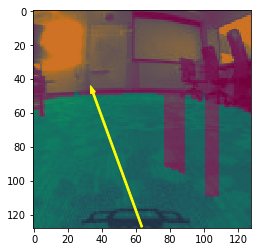

Feedback Trajectory:  (34.71947832827359, 48)


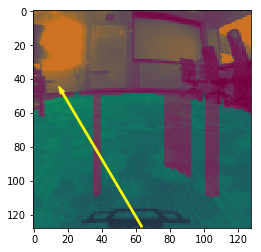

Feedback Trajectory:  (16.71457764268448, 48)


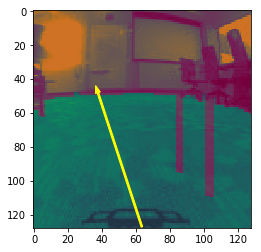

Feedback Trajectory:  (37.61460538522446, 48)


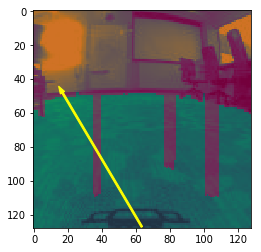

Feedback Trajectory:  (16.747234445865647, 48)


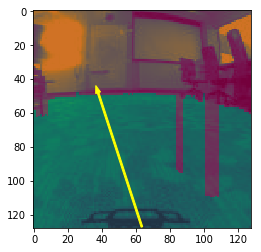

Feedback Trajectory:  (37.719120213127106, 48)


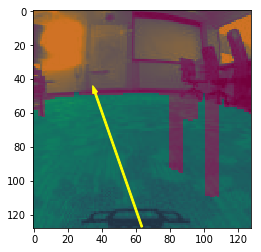

Feedback Trajectory:  (35.96791938360954, 48)


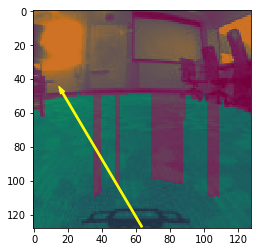

Feedback Trajectory:  (16.795308738201502, 48)


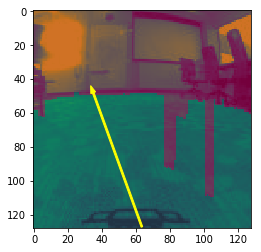

Feedback Trajectory:  (34.828397402467026, 48)


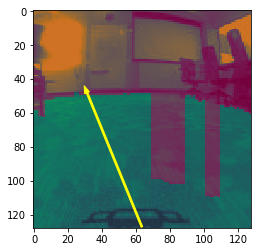

Feedback Trajectory:  (31.194051014126824, 48)


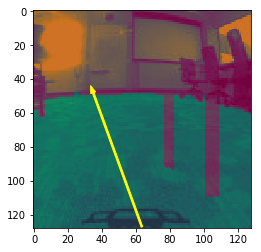

Feedback Trajectory:  (34.80491813587568, 48)


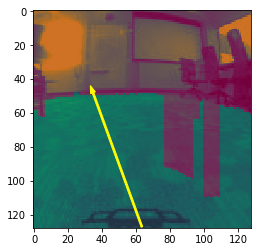

Feedback Trajectory:  (34.69386152059397, 48)


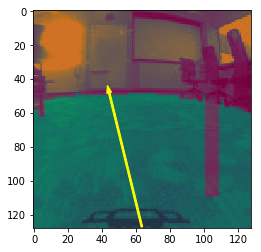

Feedback Trajectory:  (44.22879957063211, 48)


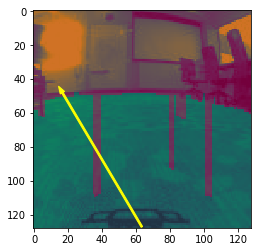

Feedback Trajectory:  (16.702838009388802, 48)


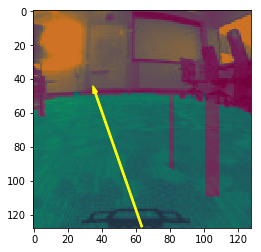

Feedback Trajectory:  (36.03280380271417, 48)


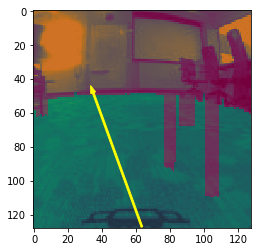

Feedback Trajectory:  (34.80992579590093, 48)


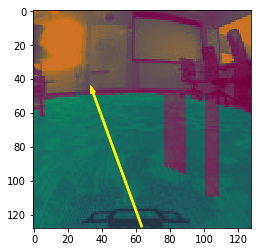

Feedback Trajectory:  (34.7379840160174, 48)


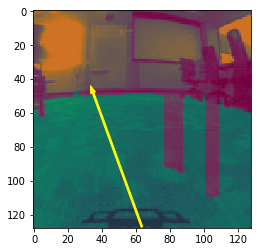

Feedback Trajectory:  (34.738405779804715, 48)


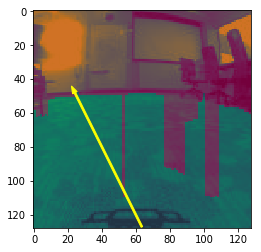

Feedback Trajectory:  (24.01683579985996, 48)


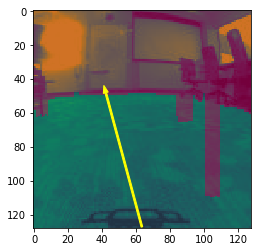

Feedback Trajectory:  (42.23347561417262, 48)


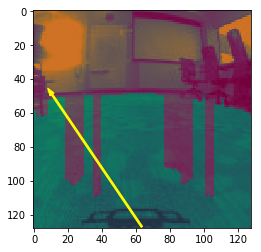

Feedback Trajectory:  (10.563630998401639, 49)


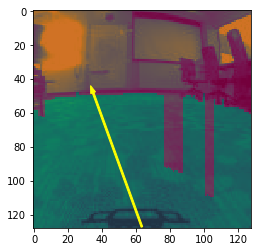

Feedback Trajectory:  (34.77599663603322, 48)


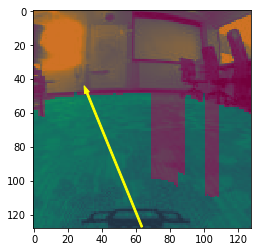

Feedback Trajectory:  (31.151275217636428, 48)


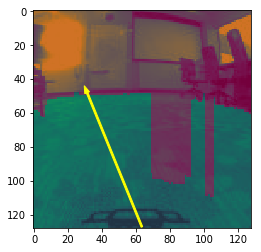

Feedback Trajectory:  (31.24990506324356, 48)


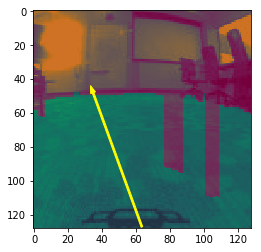

Feedback Trajectory:  (34.74031164587894, 48)


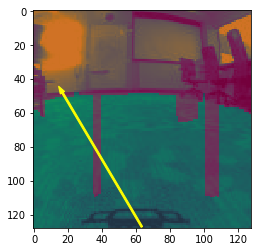

Feedback Trajectory:  (16.729995131839157, 48)


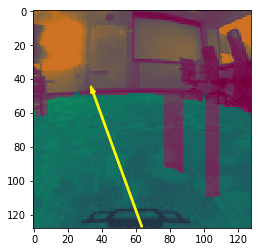

Feedback Trajectory:  (34.80981828380833, 48)


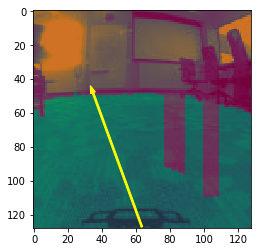

Feedback Trajectory:  (34.685832547740624, 48)


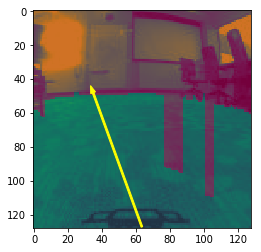

Feedback Trajectory:  (34.767468768329294, 48)


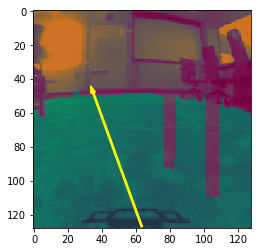

Feedback Trajectory:  (34.80519606498357, 48)


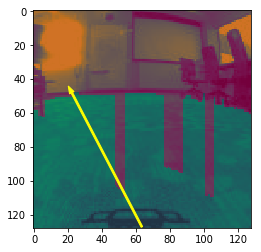

Feedback Trajectory:  (22.219923541517744, 48)


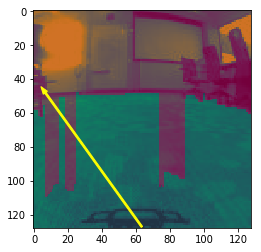

Feedback Trajectory:  (6.649489057528435, 48)


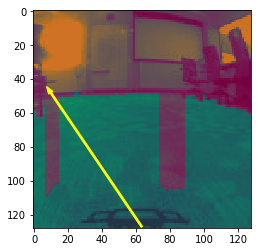

Feedback Trajectory:  (9.848569655360267, 48)


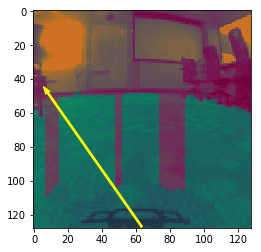

Feedback Trajectory:  (8.066103512376202, 48)


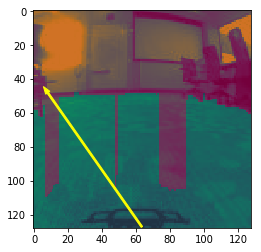

Feedback Trajectory:  (8.066103512376202, 48)


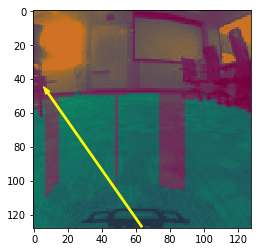

Feedback Trajectory:  (8.066103512376202, 48)


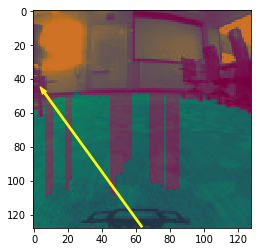

Feedback Trajectory:  (6.121880253735115, 48)


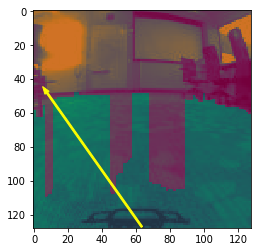

Feedback Trajectory:  (7.627501447223542, 48)


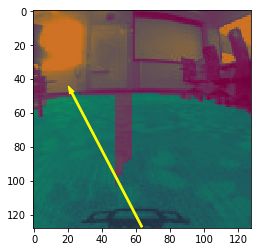

Feedback Trajectory:  (22.234224123003962, 48)


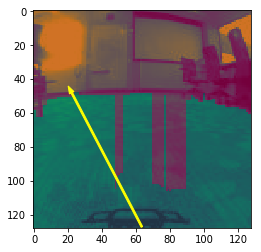

Feedback Trajectory:  (22.156648608658216, 48)


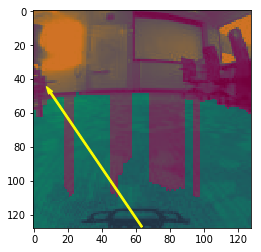

Feedback Trajectory:  (9.742465750847503, 48)


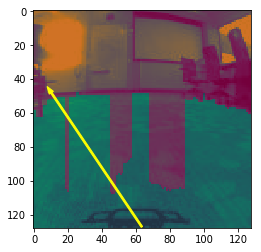

Feedback Trajectory:  (10.164200602553741, 48)


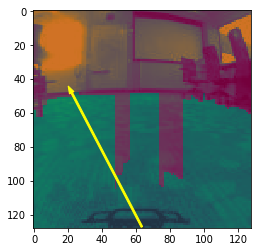

Feedback Trajectory:  (22.16380050788941, 48)


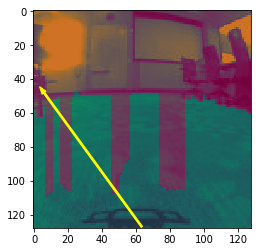

Feedback Trajectory:  (5.898805852345678, 48)


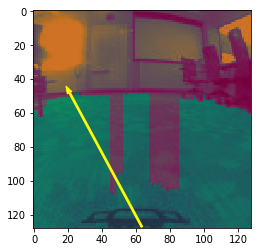

Feedback Trajectory:  (20.921021109026242, 48)


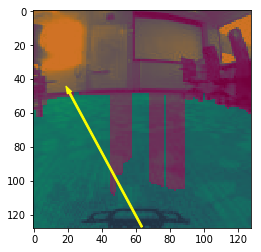

Feedback Trajectory:  (20.863230477533524, 48)


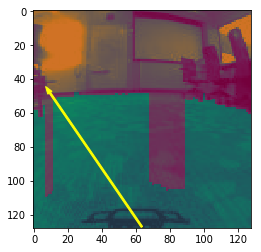

Feedback Trajectory:  (9.318735328092652, 48)


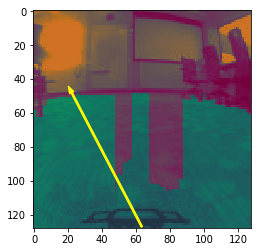

Feedback Trajectory:  (22.18501427230066, 48)


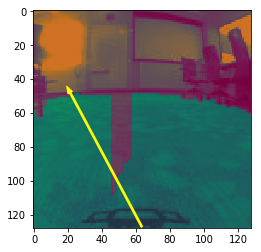

Feedback Trajectory:  (21.29083562650182, 48)


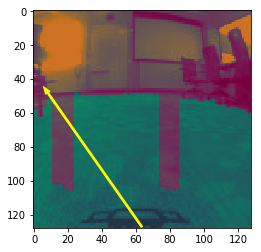

Feedback Trajectory:  (8.054763657802791, 48)


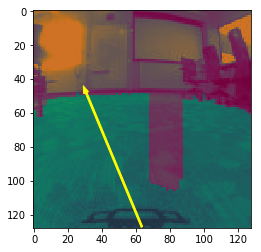

Feedback Trajectory:  (30.672404276868644, 48)


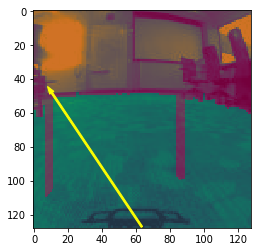

Feedback Trajectory:  (10.435888842293213, 48)


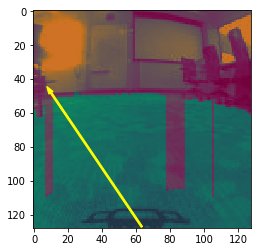

Feedback Trajectory:  (9.97619656343689, 48)


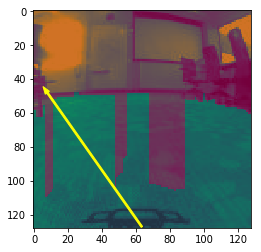

Feedback Trajectory:  (7.8410191850611195, 48)


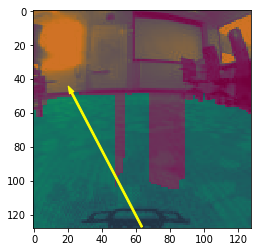

Feedback Trajectory:  (22.17006214273531, 48)


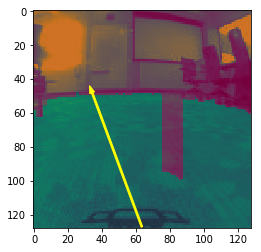

Feedback Trajectory:  (34.211823535926726, 48)


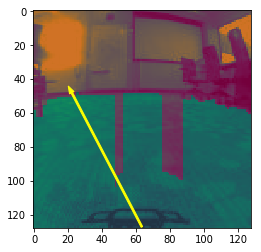

Feedback Trajectory:  (22.212616368737446, 48)


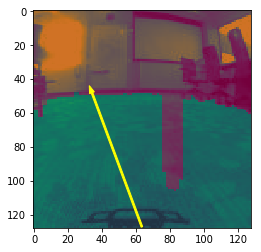

Feedback Trajectory:  (34.09659748255768, 48)


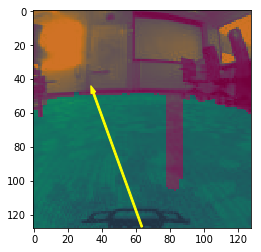

Feedback Trajectory:  (34.92694602766649, 48)


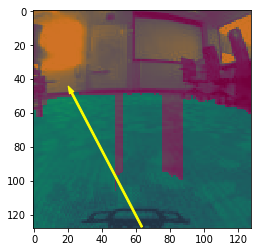

Feedback Trajectory:  (22.15235746911949, 48)


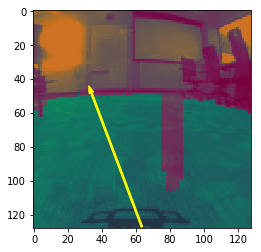

Feedback Trajectory:  (33.74808816497112, 48)


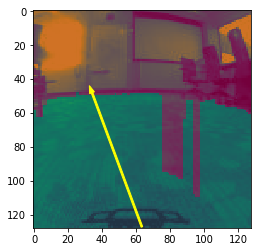

Feedback Trajectory:  (34.13392651543823, 48)


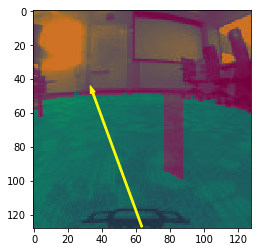

Feedback Trajectory:  (34.57584742055112, 48)


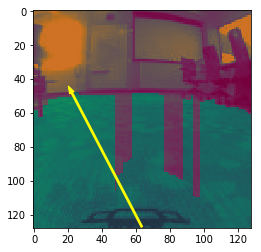

Feedback Trajectory:  (22.235401739522114, 48)


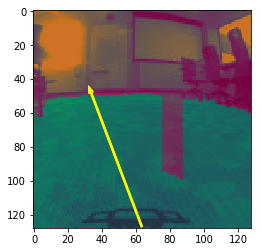

Feedback Trajectory:  (33.573743425269164, 48)


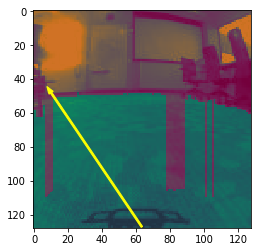

Feedback Trajectory:  (10.041510169799233, 48)


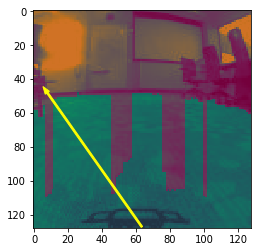

Feedback Trajectory:  (7.818252190312765, 48)


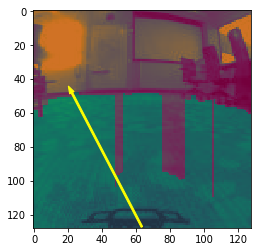

Feedback Trajectory:  (22.257642493489453, 48)


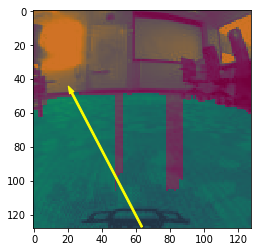

Feedback Trajectory:  (22.20662202656718, 48)


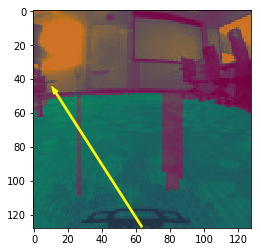

Feedback Trajectory:  (12.815980378090304, 48)


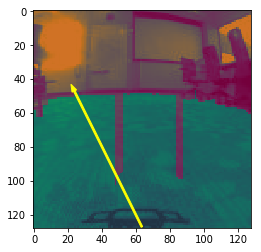

Feedback Trajectory:  (23.707155501186477, 47)


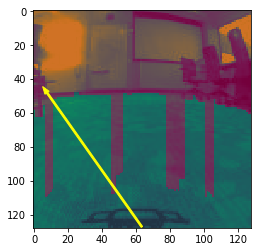

Feedback Trajectory:  (7.644409469055047, 48)


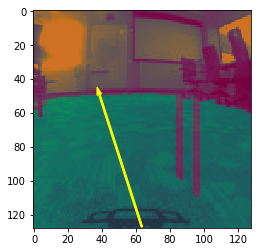

Feedback Trajectory:  (38.42463656732278, 49)


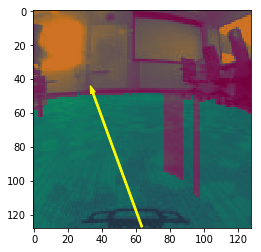

Feedback Trajectory:  (34.62937899304511, 48)


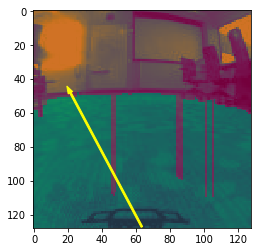

Feedback Trajectory:  (21.406141975883155, 48)


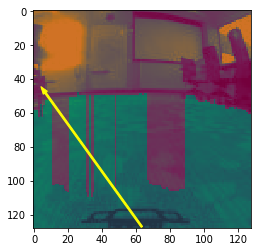

Feedback Trajectory:  (6.637734462545027, 48)


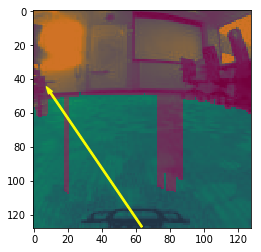

Feedback Trajectory:  (9.659709758023824, 48)


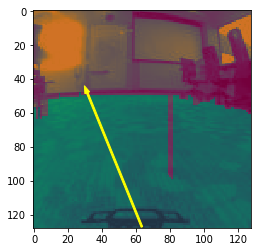

Feedback Trajectory:  (31.316480322157027, 48)


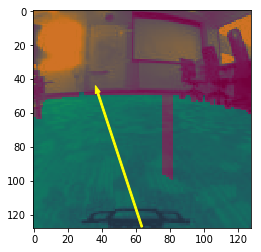

Feedback Trajectory:  (37.50669924762622, 48)


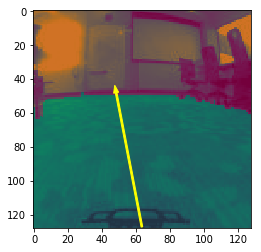

Feedback Trajectory:  (48.33835985835944, 48)


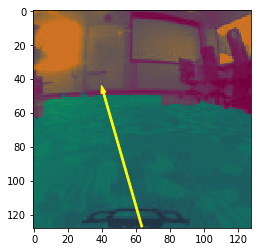

Feedback Trajectory:  (40.87201698926027, 48)


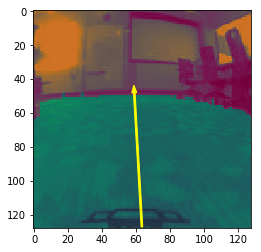

Feedback Trajectory:  (58.99980460048539, 48)


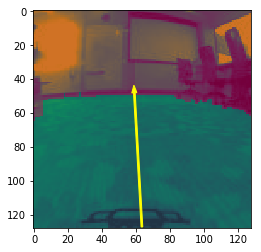

Feedback Trajectory:  (59.038771939145605, 48)


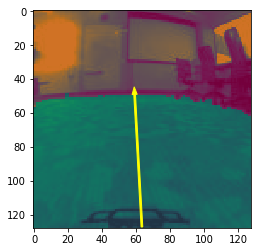

Feedback Trajectory:  (59.211959909398054, 49)


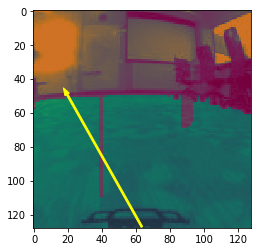

Feedback Trajectory:  (19.474239900993712, 49)


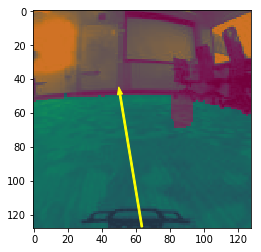

Feedback Trajectory:  (50.59577760592943, 49)


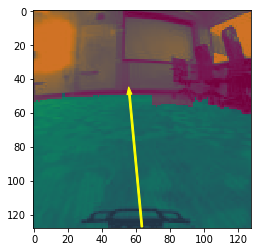

Feedback Trajectory:  (56.14218195156661, 49)


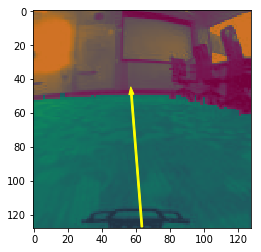

Feedback Trajectory:  (57.297336037147176, 49)


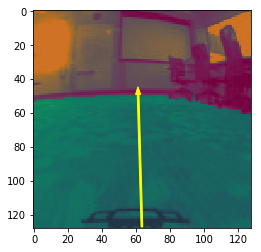

Feedback Trajectory:  (61.26046909529419, 49)


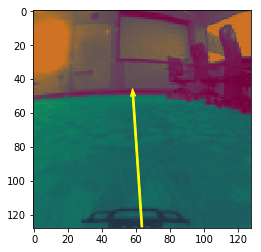

Feedback Trajectory:  (58.26950230913922, 50)


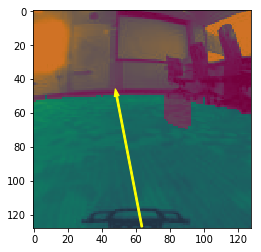

Feedback Trajectory:  (48.661112061840406, 50)


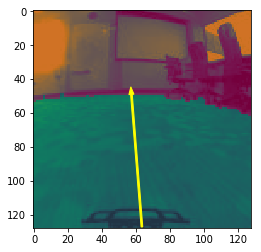

Feedback Trajectory:  (57.32618146423297, 49)


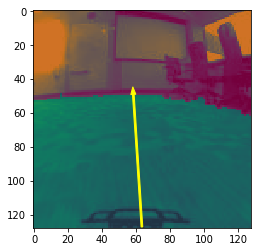

Feedback Trajectory:  (58.43872077735129, 49)


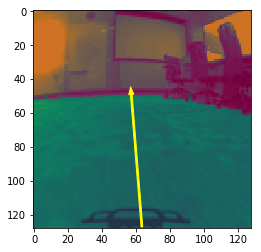

Feedback Trajectory:  (57.2229073897025, 49)


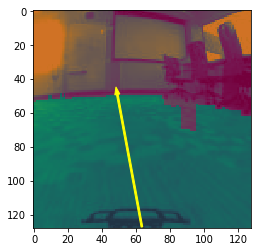

Feedback Trajectory:  (49.01952809702594, 49)


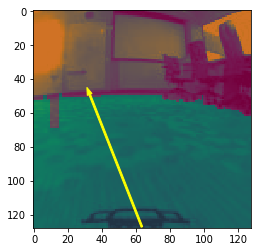

Feedback Trajectory:  (32.7391636412696, 49)


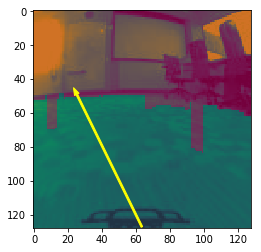

Feedback Trajectory:  (25.175308874364738, 49)


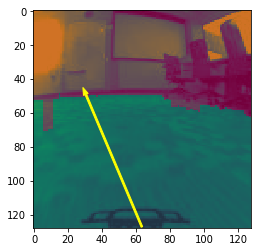

Feedback Trajectory:  (30.485085647032935, 49)


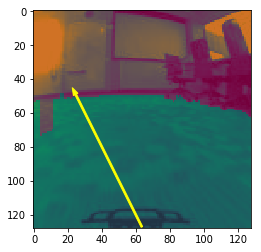

Feedback Trajectory:  (24.509147944063184, 49)


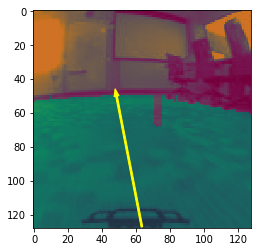

Feedback Trajectory:  (48.560099773681934, 50)


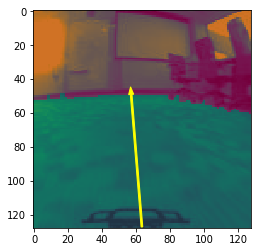

Feedback Trajectory:  (57.171254086306774, 49)


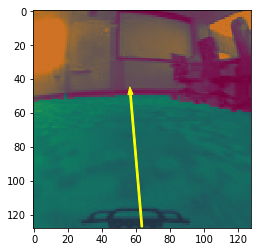

Feedback Trajectory:  (56.74377359109706, 49)


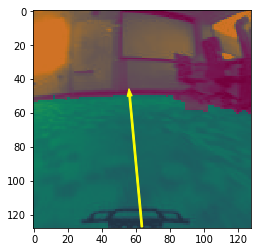

Feedback Trajectory:  (56.28442407074019, 50)


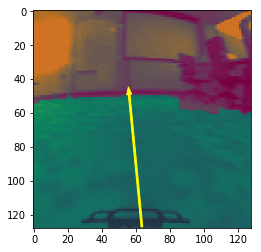

Feedback Trajectory:  (55.982840183023455, 49)


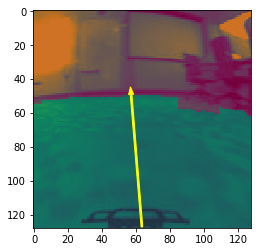

Feedback Trajectory:  (57.12933437292342, 49)


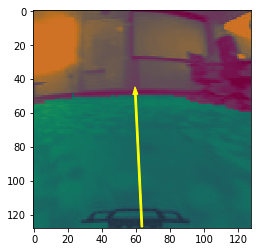

Feedback Trajectory:  (59.649786436396866, 49)


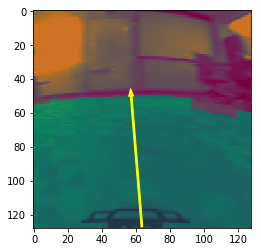

Feedback Trajectory:  (57.17892722087793, 50)


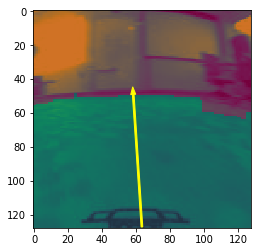

Feedback Trajectory:  (58.37935093497179, 49)


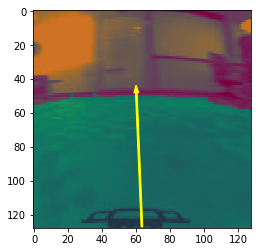

Feedback Trajectory:  (60.207311627822584, 48)


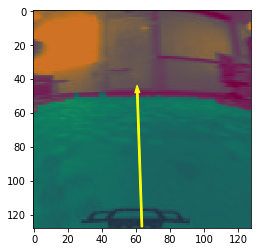

Feedback Trajectory:  (60.78549552464364, 48)


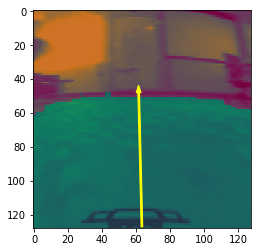

Feedback Trajectory:  (61.605161604942296, 48)


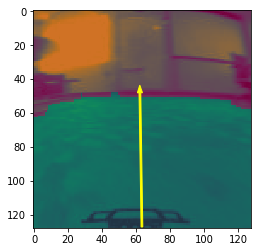

Feedback Trajectory:  (62.31828590247504, 48)


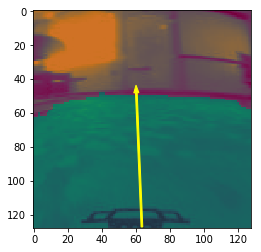

Feedback Trajectory:  (60.21390861539319, 48)


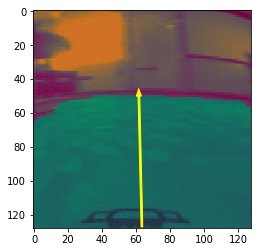

Feedback Trajectory:  (61.72362940586443, 50)


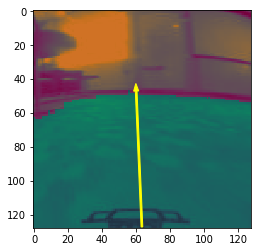

Feedback Trajectory:  (60.11485812592749, 47)


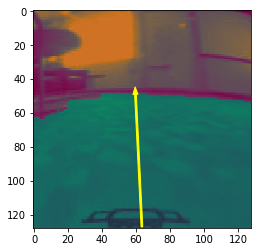

Feedback Trajectory:  (59.70523672222897, 49)


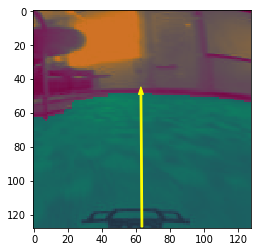

Feedback Trajectory:  (62.922423948879434, 49)


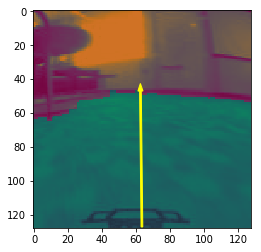

Feedback Trajectory:  (62.629213124421156, 47)


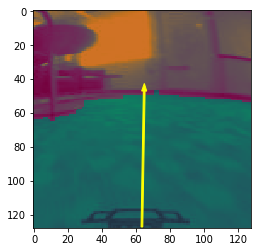

Feedback Trajectory:  (64.84516992649463, 47)


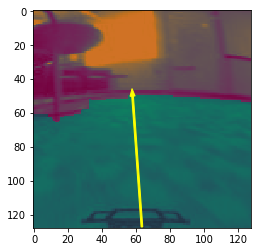

Feedback Trajectory:  (57.99097075756219, 50)


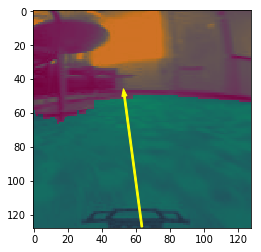

Feedback Trajectory:  (53.199430810925236, 50)


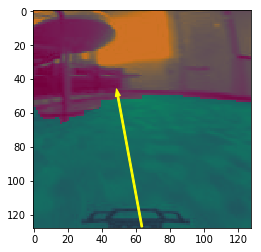

Feedback Trajectory:  (49.33250463010158, 50)


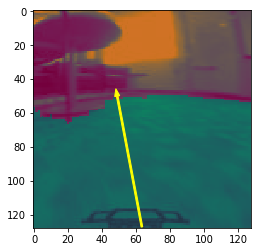

Feedback Trajectory:  (48.96883480460127, 50)


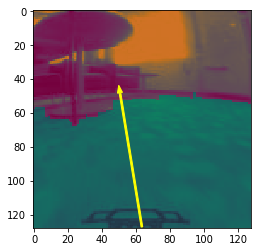

Feedback Trajectory:  (50.5754402824753, 48)


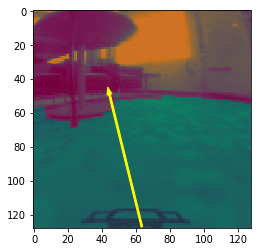

Feedback Trajectory:  (44.41053781908592, 49)


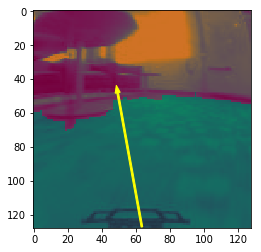

Feedback Trajectory:  (49.225353235104684, 48)


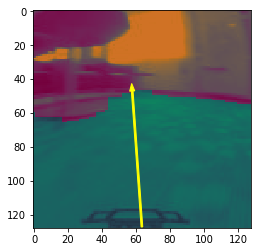

Feedback Trajectory:  (57.78545422558979, 47)


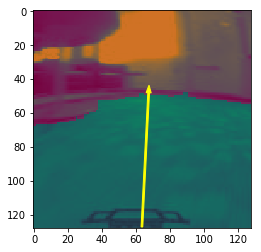

Feedback Trajectory:  (67.46407306777964, 48)


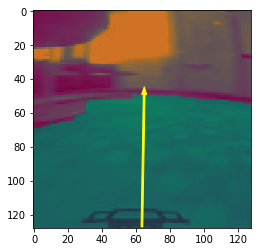

Feedback Trajectory:  (64.81777621326732, 49)


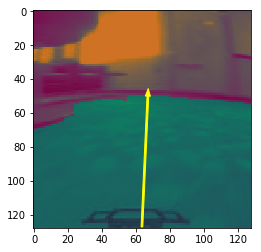

Feedback Trajectory:  (67.00777528489779, 50)


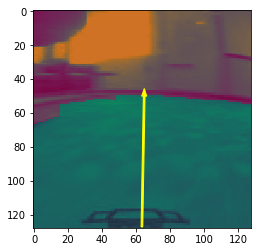

Feedback Trajectory:  (64.83643667701978, 50)


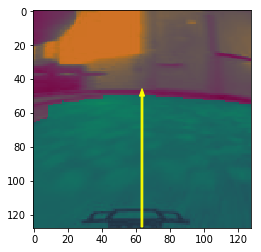

Feedback Trajectory:  (63.55829080916725, 50)


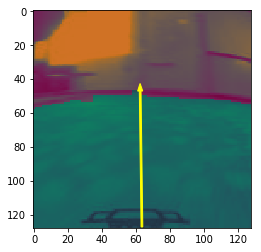

Feedback Trajectory:  (62.473618349355256, 47)


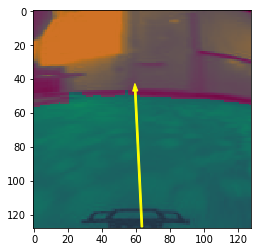

Feedback Trajectory:  (59.57110552736148, 47)


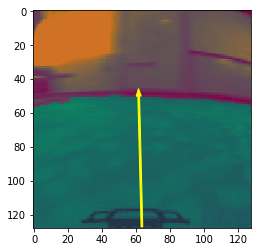

Feedback Trajectory:  (61.60481832155998, 50)


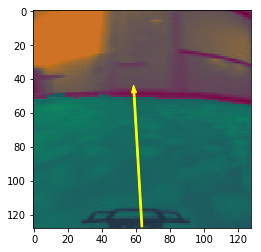

Feedback Trajectory:  (58.83816851429103, 48)


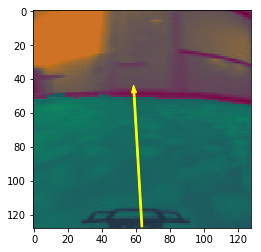

Feedback Trajectory:  (58.83816851429103, 48)


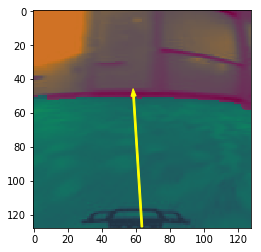

Feedback Trajectory:  (58.576641772332955, 50)


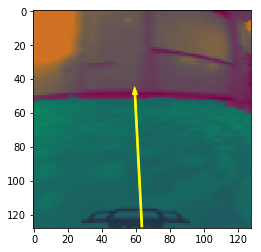

Feedback Trajectory:  (59.40716800898673, 49)


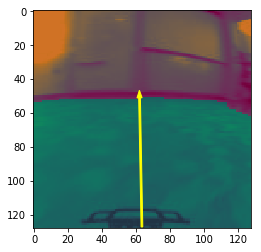

Feedback Trajectory:  (62.104089059907736, 51)


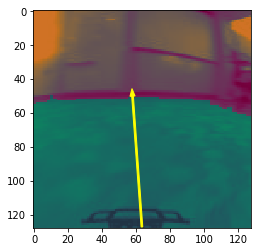

Feedback Trajectory:  (57.976139929404106, 50)


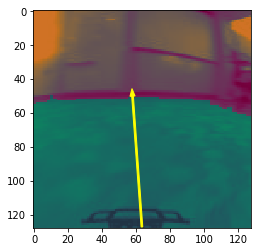

Feedback Trajectory:  (57.976139929404106, 50)


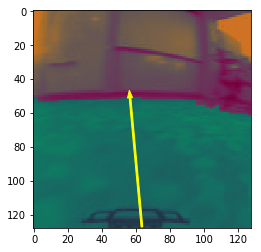

Feedback Trajectory:  (56.49933086647347, 51)


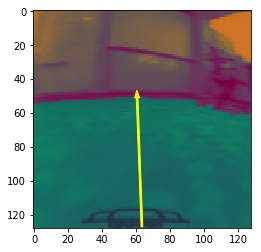

Feedback Trajectory:  (60.67781817236111, 51)


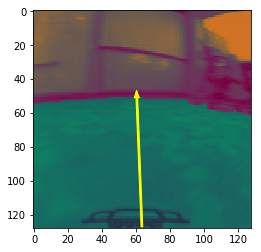

Feedback Trajectory:  (60.50713689327081, 51)


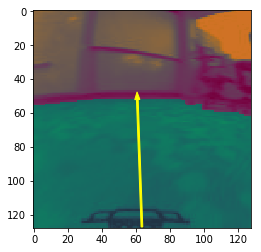

Feedback Trajectory:  (60.79379908109756, 52)


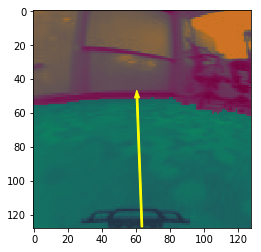

Feedback Trajectory:  (60.62556841865186, 51)


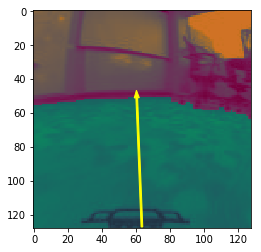

Feedback Trajectory:  (60.460077131038204, 51)


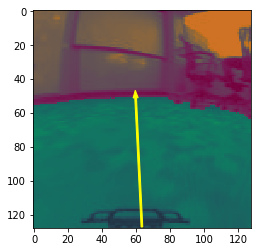

Feedback Trajectory:  (59.80233081802458, 51)


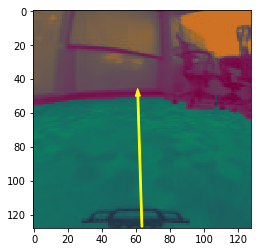

Feedback Trajectory:  (61.11288997550438, 50)


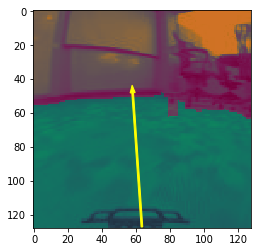

Feedback Trajectory:  (58.051415683003576, 48)


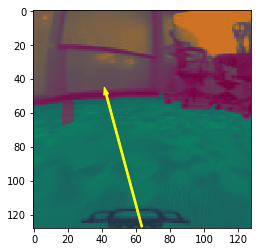

Feedback Trajectory:  (42.48557245001988, 49)


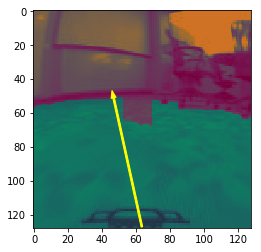

Feedback Trajectory:  (46.834927603782795, 51)


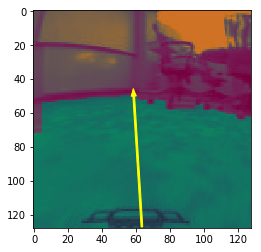

Feedback Trajectory:  (58.68541412309193, 50)


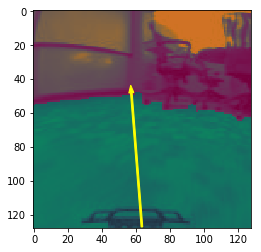

Feedback Trajectory:  (57.26294005382544, 48)


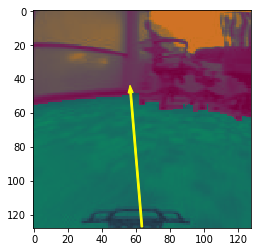

Feedback Trajectory:  (56.857578854251344, 48)


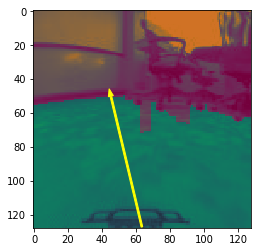

Feedback Trajectory:  (45.22268463774381, 50)


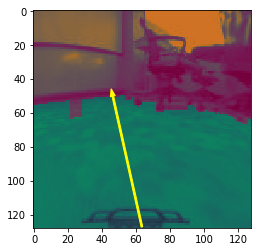

Feedback Trajectory:  (46.36034919776309, 50)


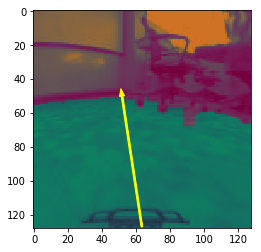

Feedback Trajectory:  (51.78556461175323, 50)


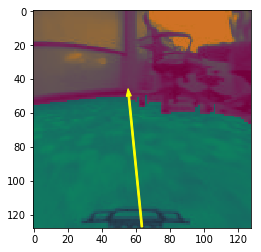

Feedback Trajectory:  (55.780953840473, 50)


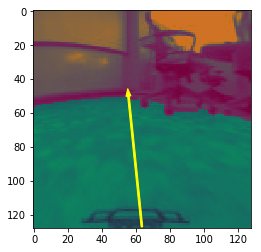

Feedback Trajectory:  (55.5838699710272, 50)


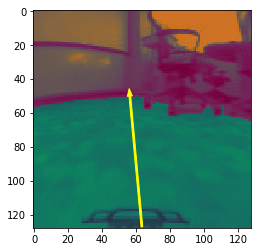

Feedback Trajectory:  (56.400856584990315, 50)


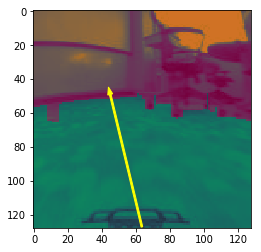

Feedback Trajectory:  (44.84835566182868, 49)


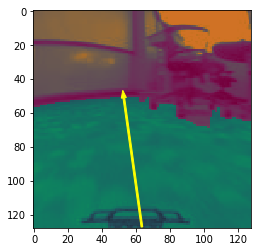

Feedback Trajectory:  (52.84260023162315, 51)


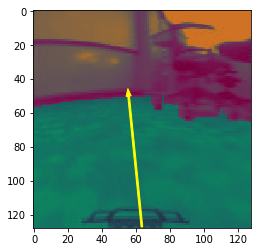

Feedback Trajectory:  (55.67663192160588, 50)


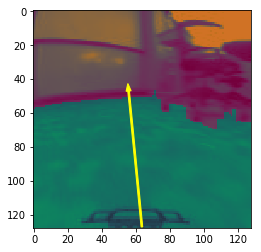

Feedback Trajectory:  (55.661323783833545, 47)


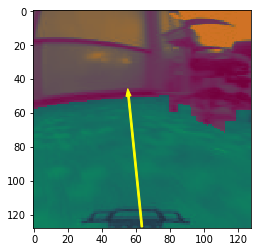

Feedback Trajectory:  (55.61076516336695, 50)


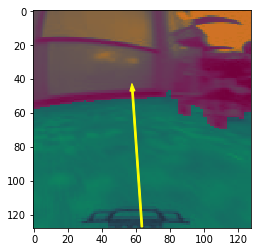

Feedback Trajectory:  (57.91628493640105, 47)


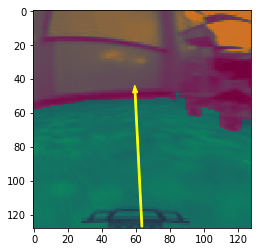

Feedback Trajectory:  (59.490104429701425, 48)


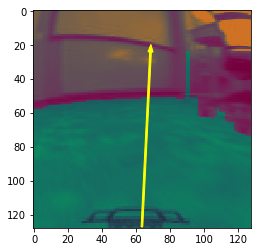

Feedback Trajectory:  (68.55926673531118, 24)


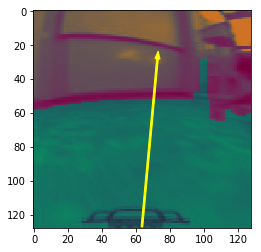

Feedback Trajectory:  (72.64980367638447, 28)


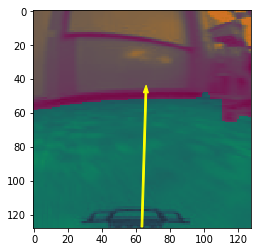

Feedback Trajectory:  (65.83000161974861, 48)


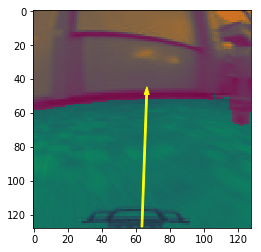

Feedback Trajectory:  (66.29275724833077, 49)


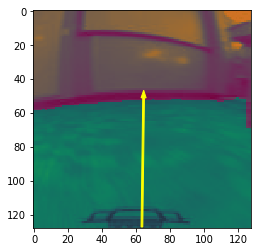

Feedback Trajectory:  (64.48288651286191, 51)


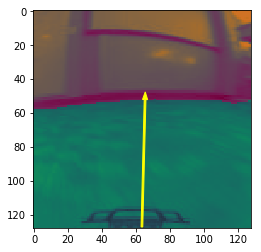

Feedback Trajectory:  (65.354289622864, 52)


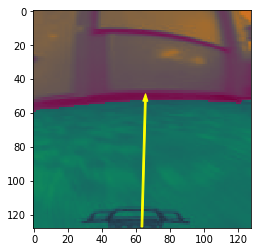

Feedback Trajectory:  (65.50625855341345, 53)


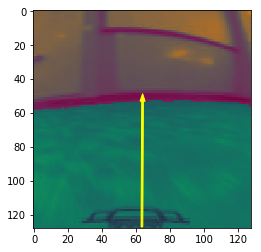

Feedback Trajectory:  (63.87993264566509, 53)


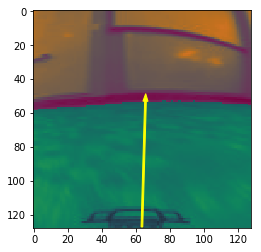

Feedback Trajectory:  (65.59239003141147, 53)


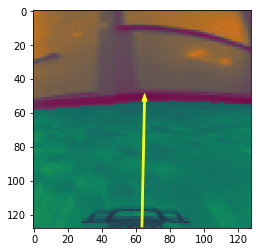

Feedback Trajectory:  (65.01914072983654, 53)


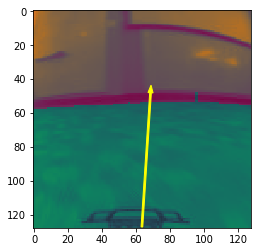

Feedback Trajectory:  (68.5698956810469, 48)


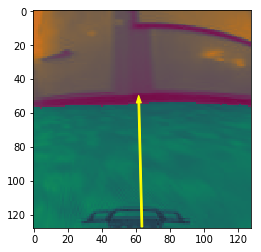

Feedback Trajectory:  (61.68270250224247, 54)


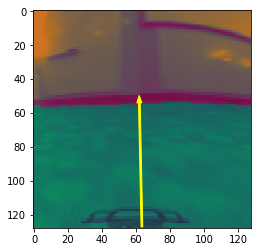

Feedback Trajectory:  (61.9922633049605, 54)


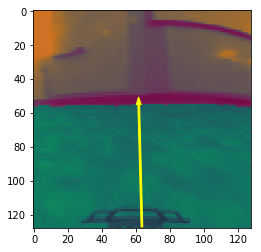

Feedback Trajectory:  (61.634597233184806, 55)


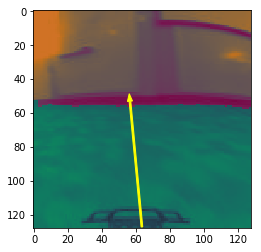

Feedback Trajectory:  (56.455030065609606, 53)


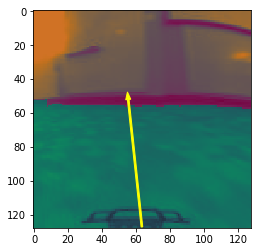

Feedback Trajectory:  (55.45318600572225, 52)


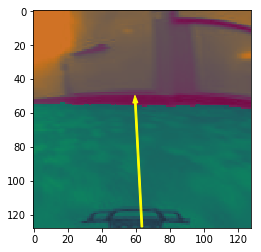

Feedback Trajectory:  (59.624974348509845, 54)


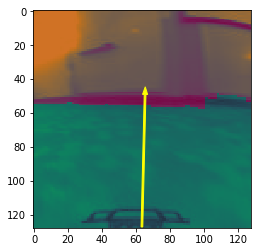

Feedback Trajectory:  (65.36327632463465, 49)


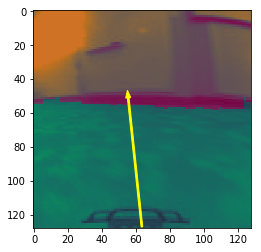

Feedback Trajectory:  (55.438157407623684, 51)


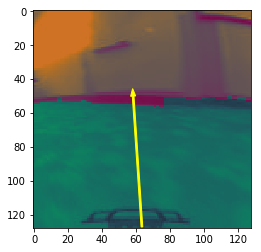

Feedback Trajectory:  (58.33170793737624, 50)


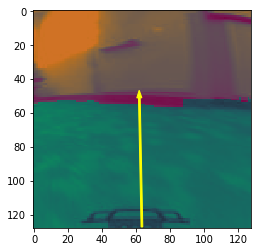

Feedback Trajectory:  (61.98461705692906, 51)


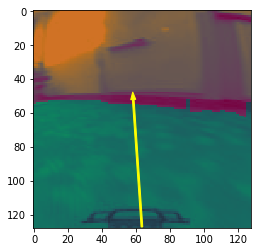

Feedback Trajectory:  (58.39047922237156, 52)


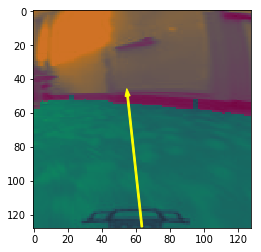

Feedback Trajectory:  (55.066333078270915, 50)


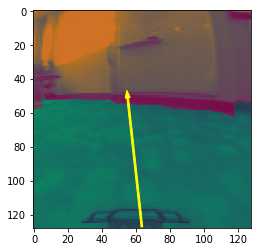

Feedback Trajectory:  (55.127453643356745, 51)


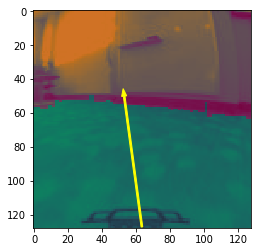

Feedback Trajectory:  (53.04634702271996, 50)


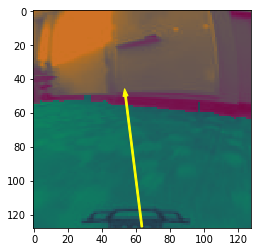

Feedback Trajectory:  (53.84206642608306, 50)


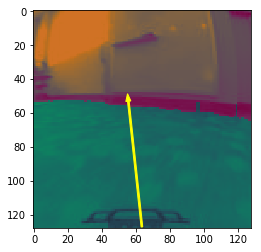

Feedback Trajectory:  (55.50737427298165, 53)


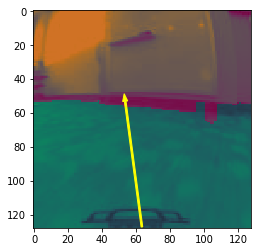

Feedback Trajectory:  (53.64652515463, 53)


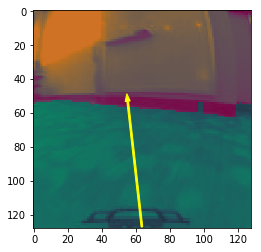

Feedback Trajectory:  (55.1235318632932, 53)


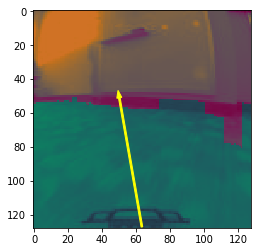

Feedback Trajectory:  (50.20083298448115, 51)


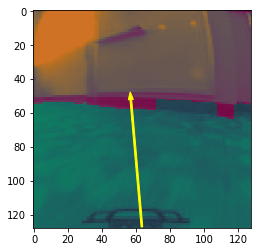

Feedback Trajectory:  (56.96925609054231, 52)


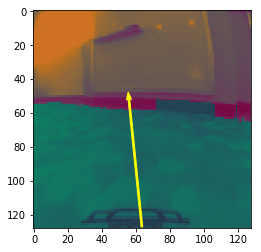

Feedback Trajectory:  (55.85048169912515, 52)


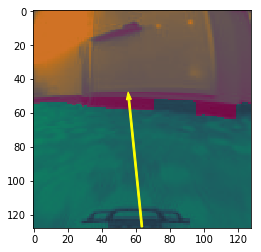

Feedback Trajectory:  (55.82999203551803, 52)


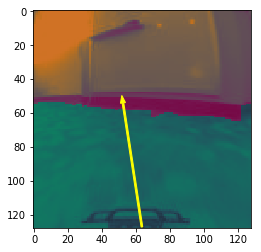

Feedback Trajectory:  (52.33710002998811, 54)


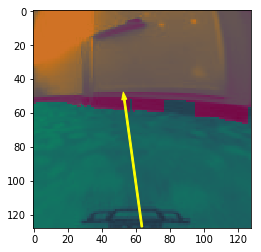

Feedback Trajectory:  (53.12312398001023, 52)


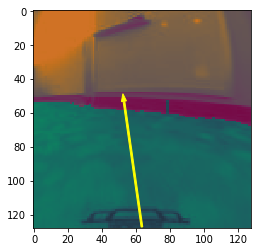

Feedback Trajectory:  (52.91990331177487, 53)


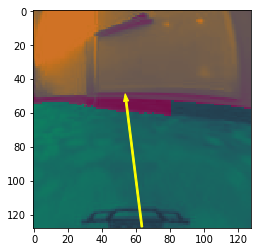

Feedback Trajectory:  (54.18526192846809, 53)


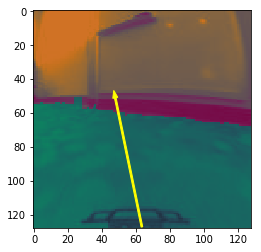

Feedback Trajectory:  (47.8220086070146, 51)


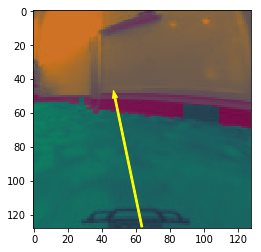

Feedback Trajectory:  (47.63759552002149, 51)


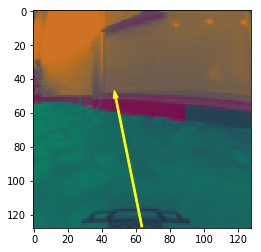

Feedback Trajectory:  (48.09203692501731, 51)


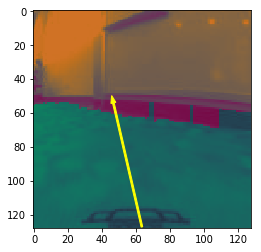

Feedback Trajectory:  (46.696176992675646, 54)


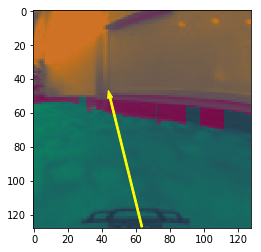

Feedback Trajectory:  (44.76182839581126, 51)


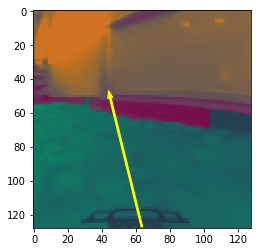

Feedback Trajectory:  (44.86736727993238, 51)


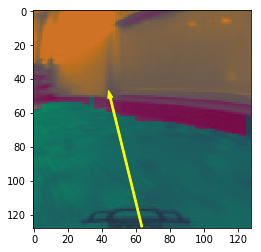

Feedback Trajectory:  (44.88630478839584, 51)


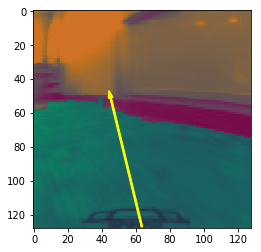

Feedback Trajectory:  (45.103135000056916, 51)


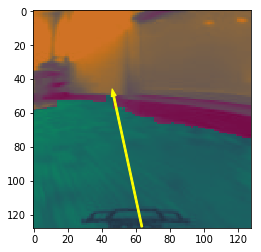

Feedback Trajectory:  (46.892869695971726, 50)


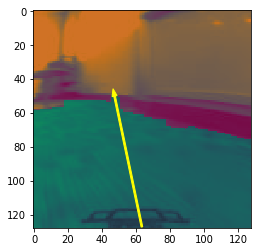

Feedback Trajectory:  (47.40478436791714, 50)


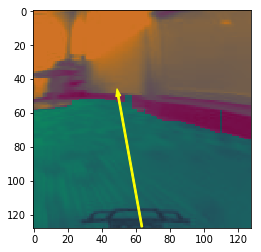

Feedback Trajectory:  (49.60382889693138, 50)


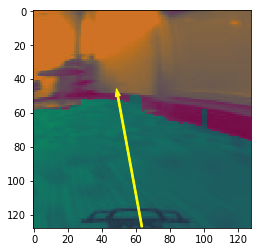

Feedback Trajectory:  (49.3266093884308, 50)


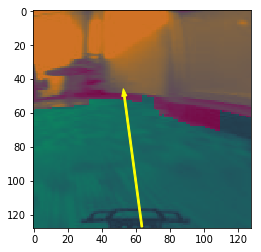

Feedback Trajectory:  (53.142008472516004, 50)


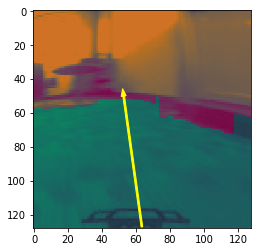

Feedback Trajectory:  (52.76674322717825, 50)


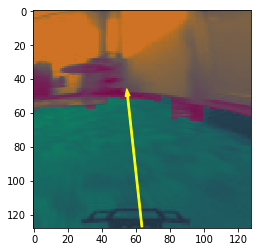

Feedback Trajectory:  (55.059140834455505, 50)


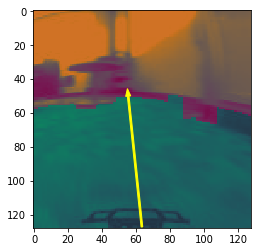

Feedback Trajectory:  (55.420703276693075, 50)


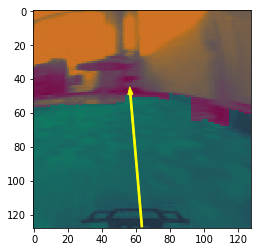

Feedback Trajectory:  (56.703874159499826, 49)


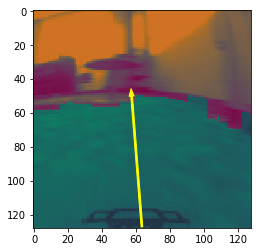

Feedback Trajectory:  (57.43969883335053, 50)


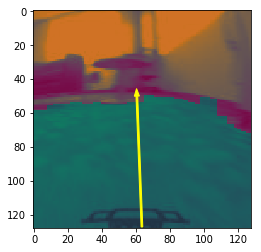

Feedback Trajectory:  (60.52292361295816, 50)


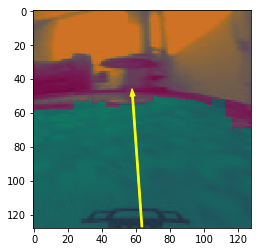

Feedback Trajectory:  (57.97817415779776, 50)


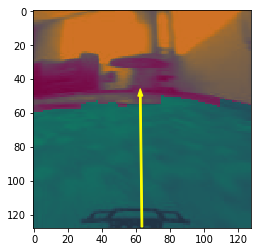

Feedback Trajectory:  (62.551192609880076, 50)


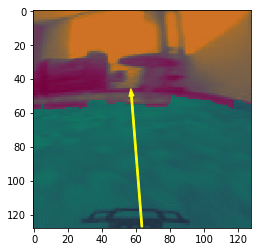

Feedback Trajectory:  (57.3394520287424, 50)


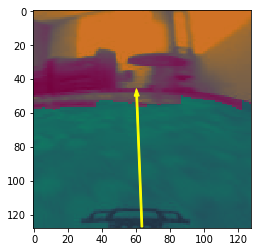

Feedback Trajectory:  (60.43306075832052, 50)


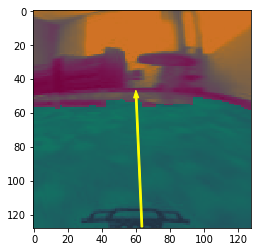

Feedback Trajectory:  (60.13298407543591, 51)


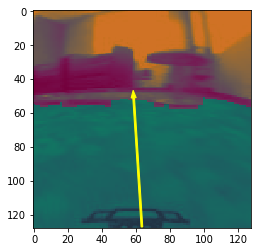

Feedback Trajectory:  (58.633518935902906, 51)


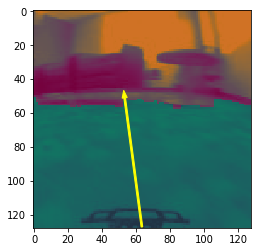

Feedback Trajectory:  (53.35459037833936, 51)


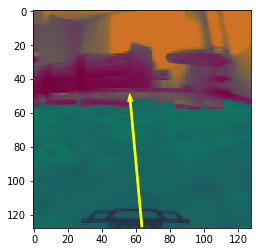

Feedback Trajectory:  (56.65097020050636, 53)


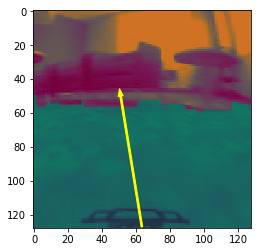

Feedback Trajectory:  (50.993173834466944, 50)


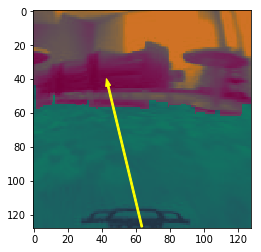

Feedback Trajectory:  (43.62096357847912, 44)


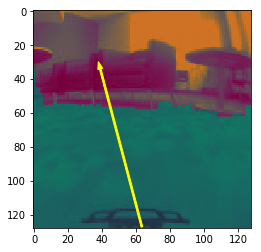

Feedback Trajectory:  (38.97760578243469, 34)


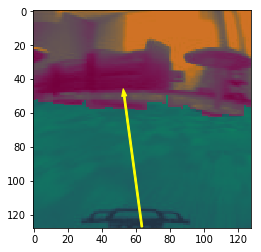

Feedback Trajectory:  (53.0807920282603, 50)


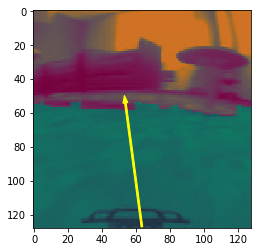

Feedback Trajectory:  (53.77829331429071, 54)


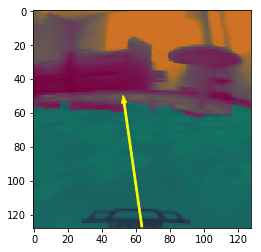

Feedback Trajectory:  (53.03736443075802, 54)


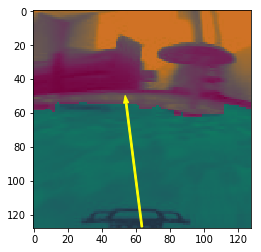

Feedback Trajectory:  (54.1858958154733, 54)


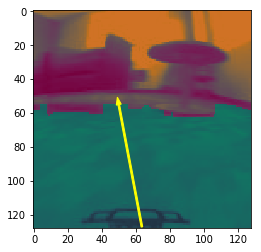

Feedback Trajectory:  (49.87276661688366, 55)


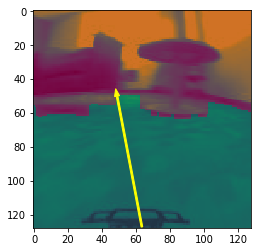

Feedback Trajectory:  (48.87313729914186, 50)


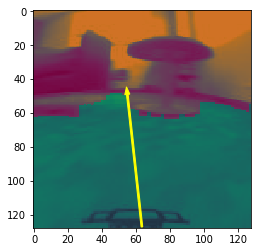

Feedback Trajectory:  (54.90531857250555, 49)


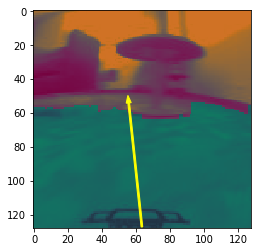

Feedback Trajectory:  (55.72212421404556, 54)


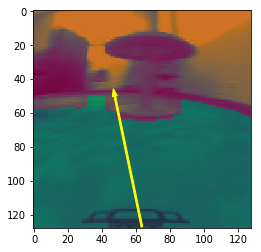

Feedback Trajectory:  (47.53472795657287, 50)


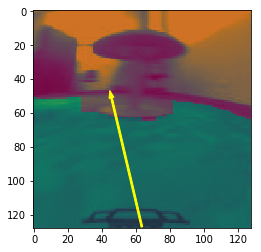

Feedback Trajectory:  (45.59911343551398, 51)


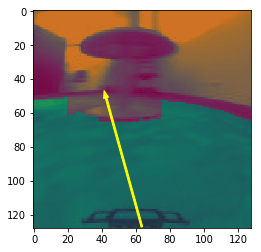

Feedback Trajectory:  (42.41069004809693, 51)


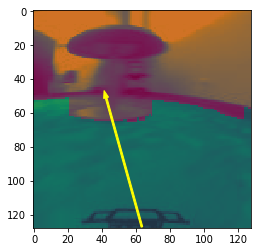

Feedback Trajectory:  (42.4114328374551, 51)


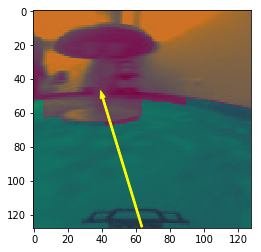

Feedback Trajectory:  (40.42832296131834, 51)


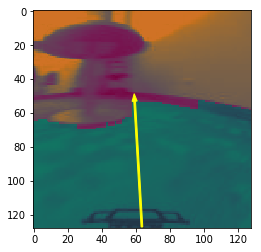

Feedback Trajectory:  (59.21301832074674, 53)


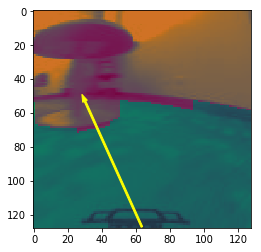

Feedback Trajectory:  (30.000405661689655, 53)


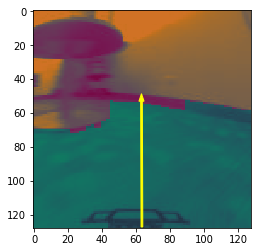

Feedback Trajectory:  (63.250337132707614, 53)


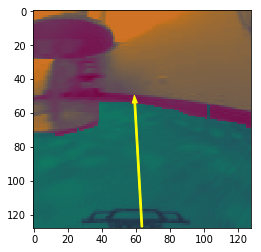

Feedback Trajectory:  (59.311299698019454, 54)


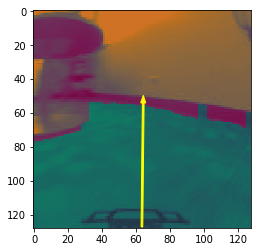

Feedback Trajectory:  (64.27147443443326, 54)


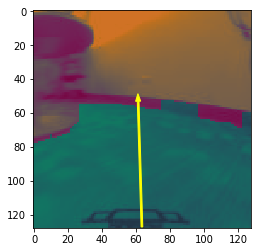

Feedback Trajectory:  (61.27341623446811, 53)


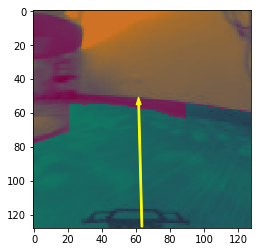

Feedback Trajectory:  (61.60473932757303, 55)


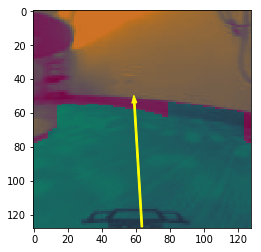

Feedback Trajectory:  (59.03057800798252, 54)


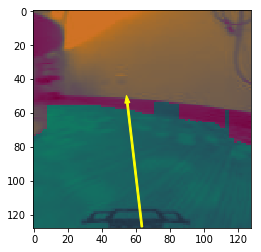

Feedback Trajectory:  (54.91957295612901, 54)


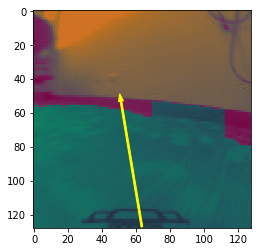

Feedback Trajectory:  (51.17038806375491, 53)


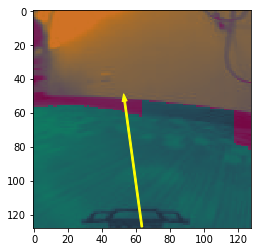

Feedback Trajectory:  (53.326339785371395, 53)


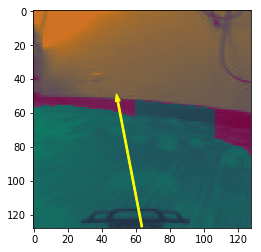

Feedback Trajectory:  (49.287428849229414, 53)


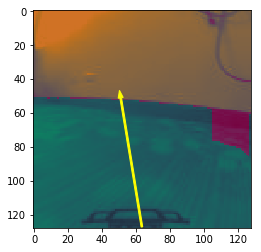

Feedback Trajectory:  (51.00346607416434, 51)


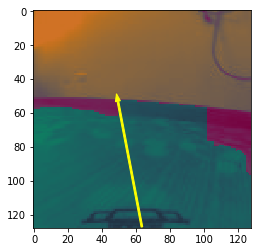

Feedback Trajectory:  (49.36568939785176, 53)


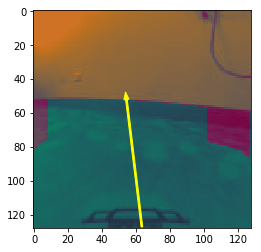

Feedback Trajectory:  (54.38405704264915, 52)


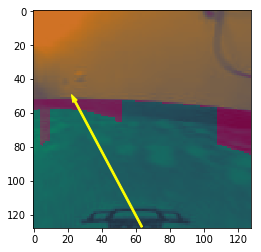

Feedback Trajectory:  (24.098723323920012, 53)


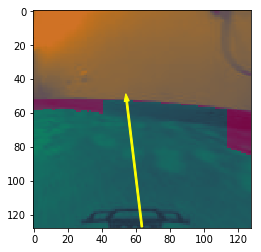

Feedback Trajectory:  (54.54570678306946, 53)


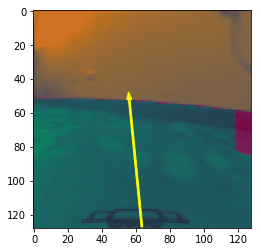

Feedback Trajectory:  (56.04738507478598, 52)


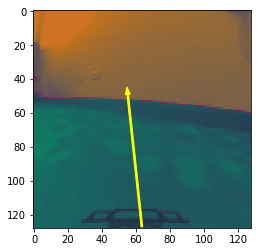

Feedback Trajectory:  (55.1477691794601, 49)


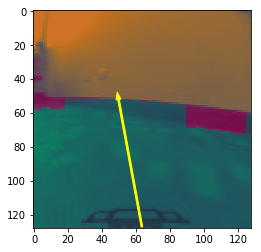

Feedback Trajectory:  (49.74017319987173, 52)


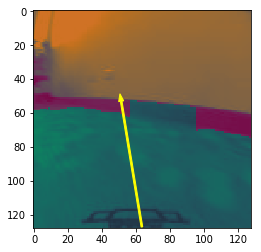

Feedback Trajectory:  (51.28820040390795, 53)


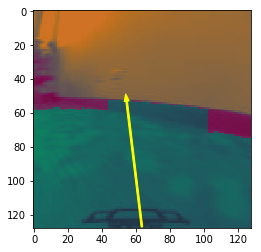

Feedback Trajectory:  (54.503837147647594, 53)


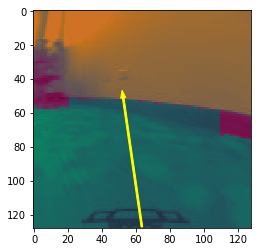

Feedback Trajectory:  (52.48317094072783, 51)


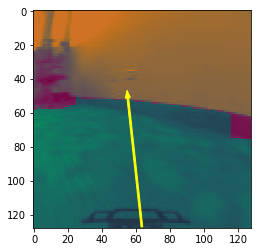

Feedback Trajectory:  (55.196772442416226, 51)


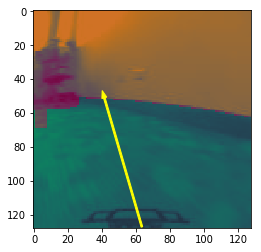

Feedback Trajectory:  (41.370918996588806, 51)


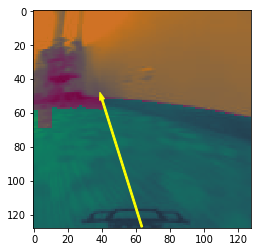

Feedback Trajectory:  (40.05160072664651, 52)


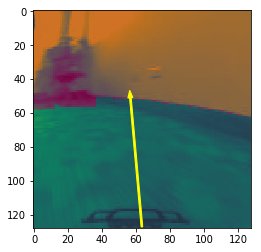

Feedback Trajectory:  (56.713946075933585, 51)


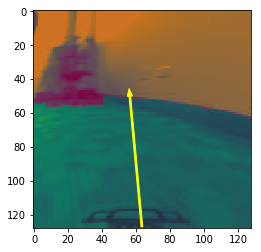

Feedback Trajectory:  (56.386921599925536, 50)


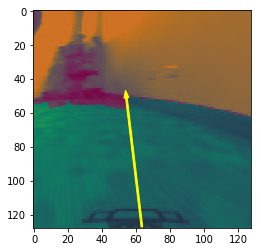

Feedback Trajectory:  (54.37531080308137, 51)


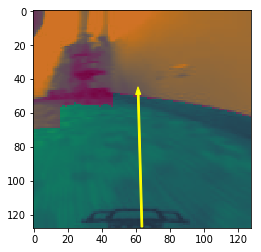

Feedback Trajectory:  (61.312793774209425, 49)


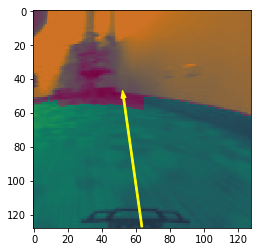

Feedback Trajectory:  (52.689917121745516, 51)


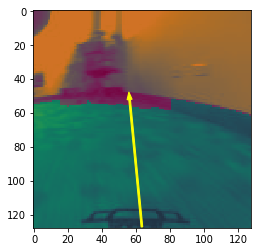

Feedback Trajectory:  (56.2487421766368, 52)


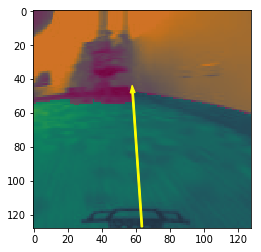

Feedback Trajectory:  (58.04701387936915, 48)


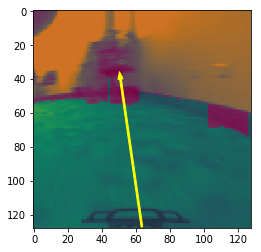

Feedback Trajectory:  (50.90216143661099, 40)


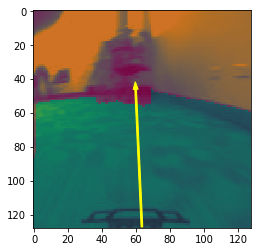

Feedback Trajectory:  (59.80714437333926, 46)


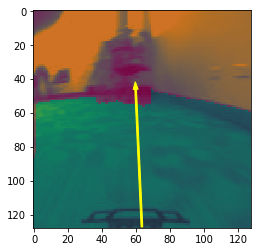

Feedback Trajectory:  (59.80714437333926, 46)


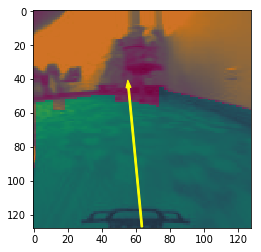

Feedback Trajectory:  (55.61089903586608, 45)


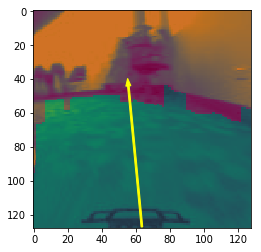

Feedback Trajectory:  (55.51518024765237, 44)


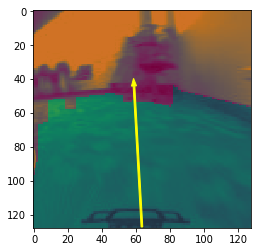

Feedback Trajectory:  (58.82865044513068, 44)


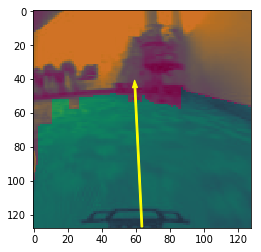

Feedback Trajectory:  (59.40903606593627, 45)


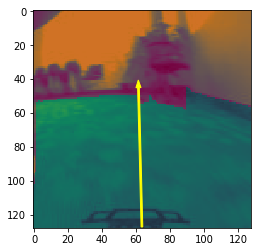

Feedback Trajectory:  (61.47586064729708, 45)


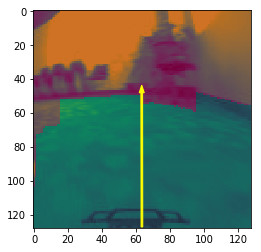

Feedback Trajectory:  (63.39348682211461, 48)


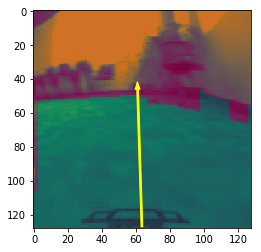

Feedback Trajectory:  (60.9660122870592, 46)


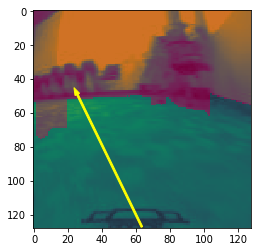

Feedback Trajectory:  (25.4647249400895, 49)


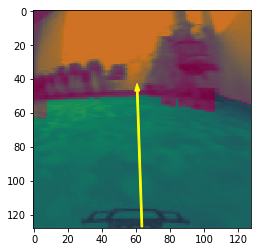

Feedback Trajectory:  (60.75746102752285, 47)


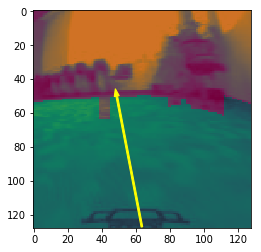

Feedback Trajectory:  (48.68535402215519, 50)


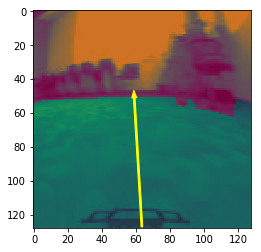

Feedback Trajectory:  (58.98016926069349, 51)


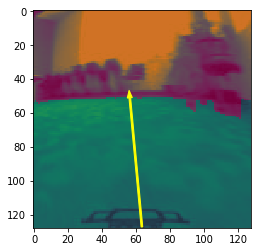

Feedback Trajectory:  (56.365142200499626, 51)


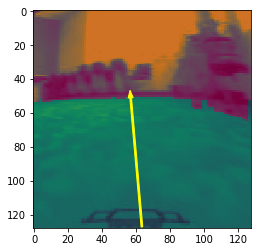

Feedback Trajectory:  (56.88580718143828, 51)


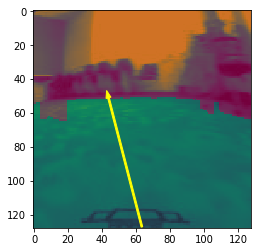

Feedback Trajectory:  (43.82896926858148, 51)


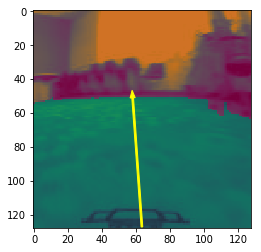

Feedback Trajectory:  (58.0474441335797, 51)


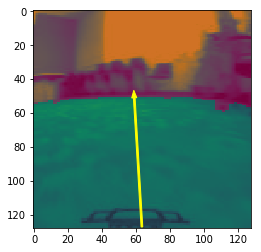

Feedback Trajectory:  (58.984316065265, 51)


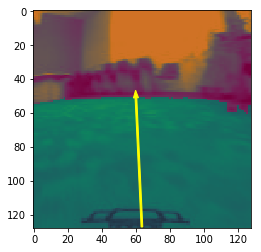

Feedback Trajectory:  (59.98151893834117, 51)


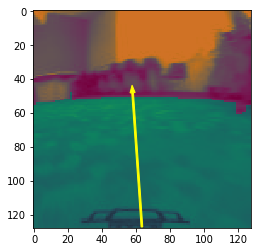

Feedback Trajectory:  (58.01553493594291, 48)


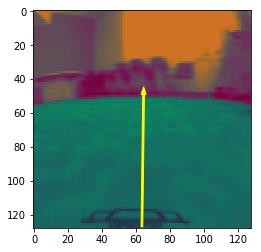

Feedback Trajectory:  (64.4923888857473, 49)


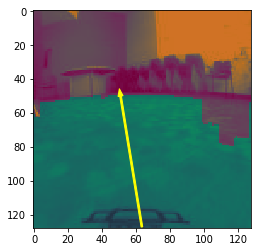

Feedback Trajectory:  (50.931658834780926, 50)


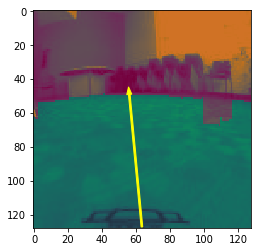

Feedback Trajectory:  (56.05663952289352, 49)


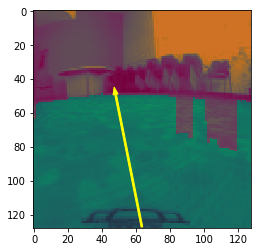

Feedback Trajectory:  (47.999727871252944, 49)


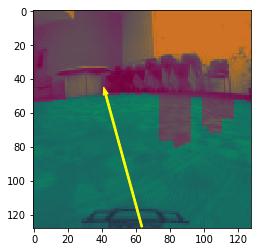

Feedback Trajectory:  (42.165811457263345, 49)


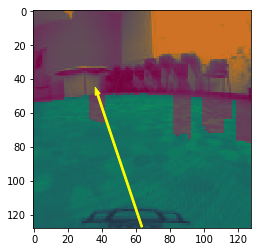

Feedback Trajectory:  (37.42392646834032, 49)


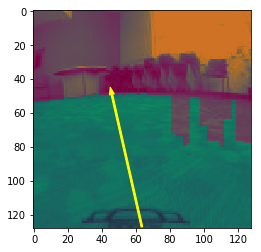

Feedback Trajectory:  (45.80904323166342, 49)


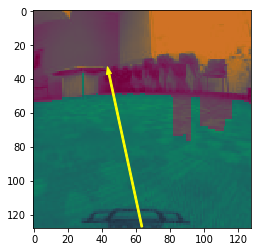

Feedback Trajectory:  (44.121370863771006, 37)


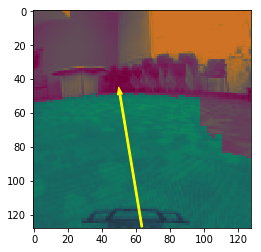

Feedback Trajectory:  (50.53833997968675, 49)


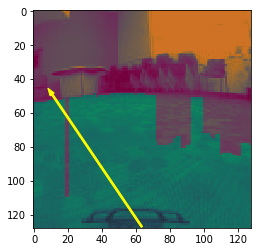

Feedback Trajectory:  (10.65445495661327, 49)


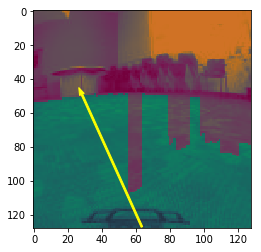

Feedback Trajectory:  (28.169030041997924, 49)


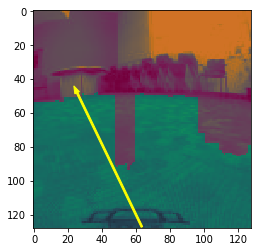

Feedback Trajectory:  (25.359308071202282, 48)


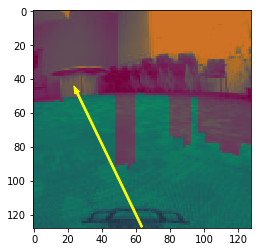

Feedback Trajectory:  (25.355734800332193, 48)


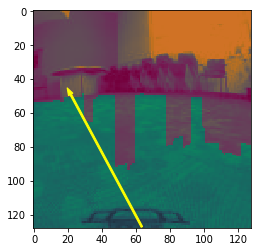

Feedback Trajectory:  (21.579565080403054, 49)


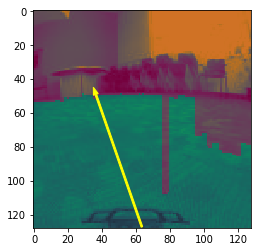

Feedback Trajectory:  (36.374000525624375, 49)


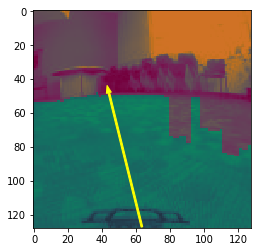

Feedback Trajectory:  (44.034104753215765, 48)


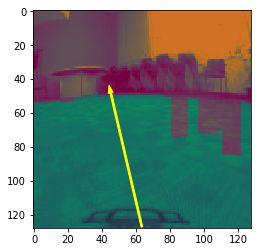

Feedback Trajectory:  (45.13631340375457, 48)


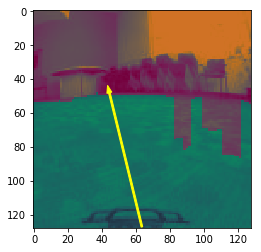

Feedback Trajectory:  (44.33155852476659, 48)


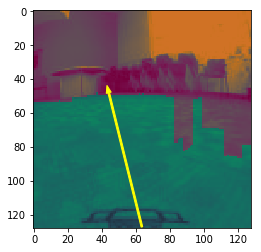

Feedback Trajectory:  (43.97505378106528, 48)


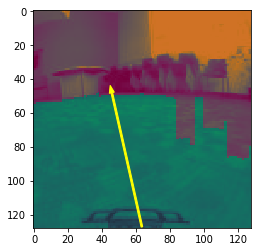

Feedback Trajectory:  (45.780333685495734, 48)


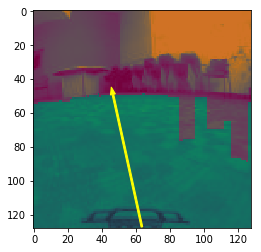

Feedback Trajectory:  (46.434099723676134, 49)


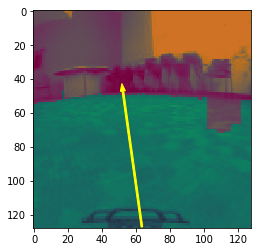

Feedback Trajectory:  (52.281173224190574, 47)


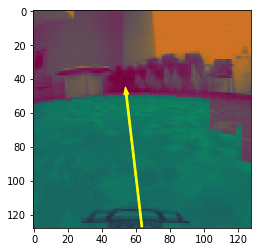

Feedback Trajectory:  (54.2878107397753, 49)


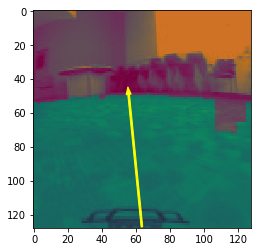

Feedback Trajectory:  (55.68135096224616, 49)


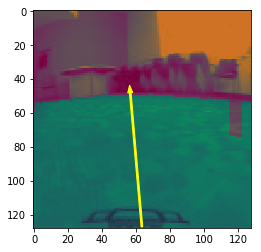

Feedback Trajectory:  (56.622259004876135, 48)


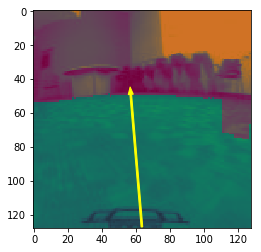

Feedback Trajectory:  (56.931555195757404, 49)


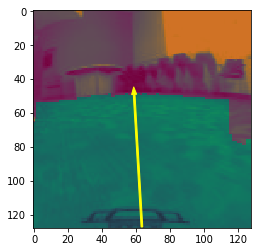

Feedback Trajectory:  (58.91949266066896, 49)


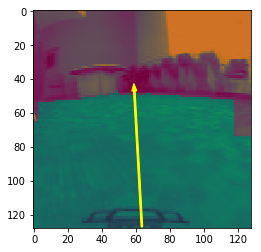

Feedback Trajectory:  (59.02575020349131, 47)


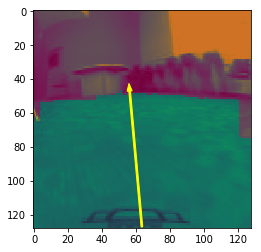

Feedback Trajectory:  (56.26916666295159, 47)


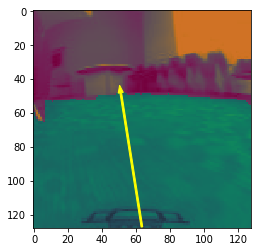

Feedback Trajectory:  (51.04742926661238, 48)


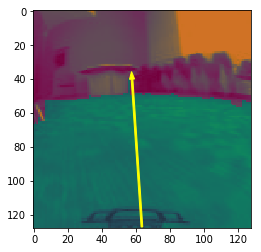

Feedback Trajectory:  (57.681199631288756, 40)


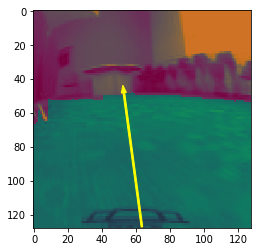

Feedback Trajectory:  (52.867420705529064, 48)


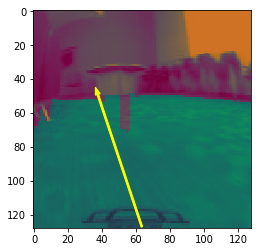

Feedback Trajectory:  (37.51122972507531, 49)


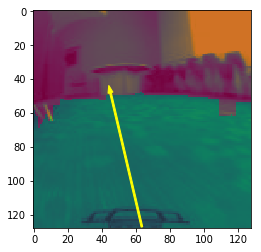

Feedback Trajectory:  (45.00052425340088, 48)


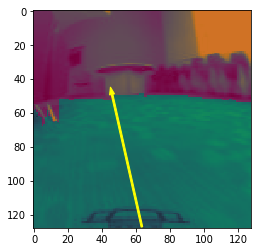

Feedback Trajectory:  (45.93098208927566, 49)


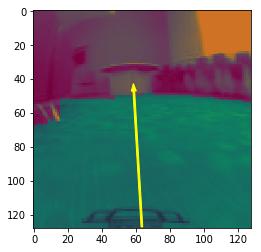

Feedback Trajectory:  (58.72749072004641, 47)


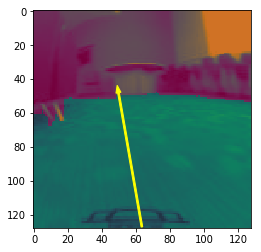

Feedback Trajectory:  (49.69695831671085, 48)


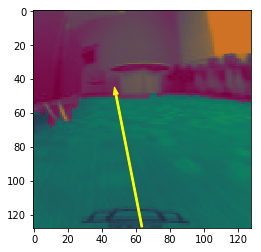

Feedback Trajectory:  (48.17815325229536, 49)


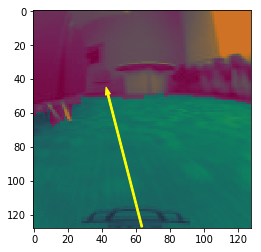

Feedback Trajectory:  (43.499700961815776, 49)


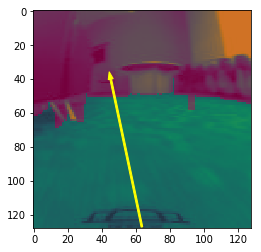

Feedback Trajectory:  (45.14129788568283, 40)


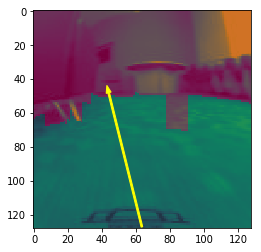

Feedback Trajectory:  (43.92571622561497, 48)


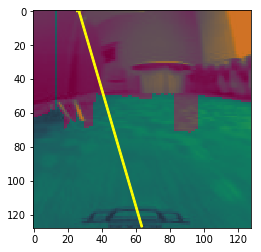

Feedback Trajectory:  (26.443599215042873, 0)


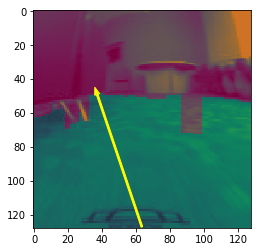

Feedback Trajectory:  (37.171754567369106, 49)


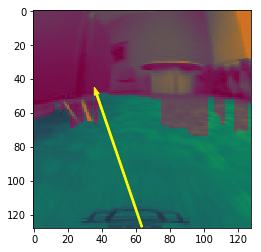

Feedback Trajectory:  (36.910455526905245, 49)


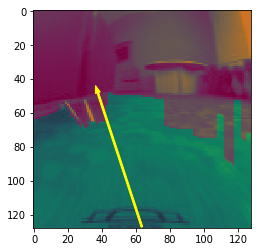

Feedback Trajectory:  (37.54674211821042, 48)


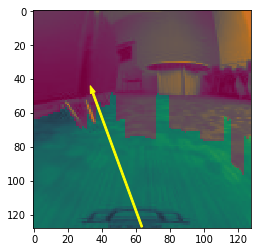

Feedback Trajectory:  (34.58463351354784, 48)


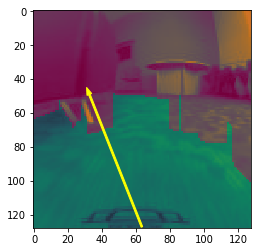

Feedback Trajectory:  (32.56243926248987, 49)


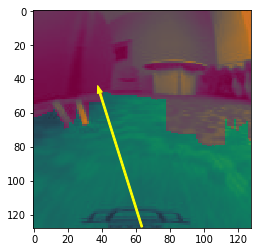

Feedback Trajectory:  (38.74134819454009, 48)


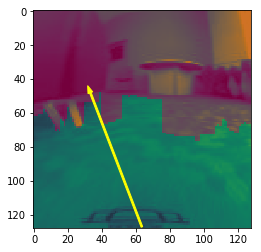

Feedback Trajectory:  (33.16096761675638, 48)


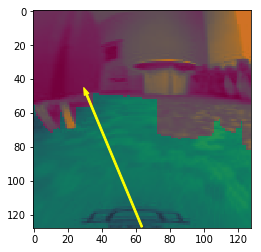

Feedback Trajectory:  (30.926935496079988, 49)


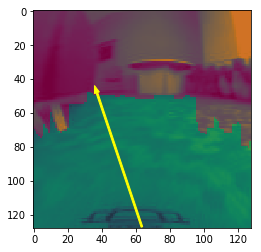

Feedback Trajectory:  (36.999454745951994, 48)


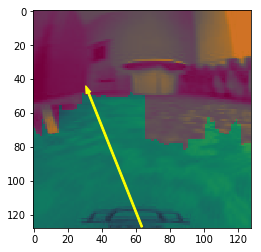

Feedback Trajectory:  (32.01923143337801, 48)


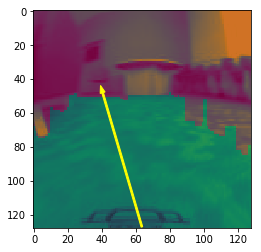

Feedback Trajectory:  (40.37167703293786, 48)


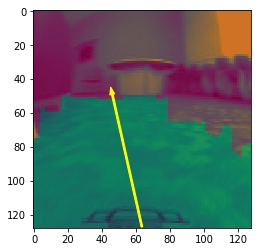

Feedback Trajectory:  (46.06913772209181, 49)


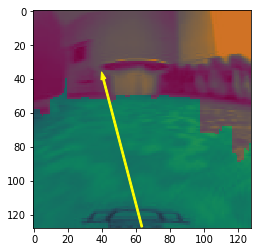

Feedback Trajectory:  (40.839060810195015, 40)


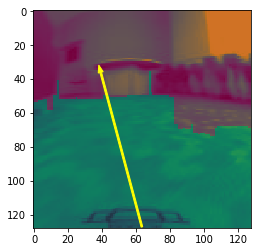

Feedback Trajectory:  (39.25092027247174, 36)


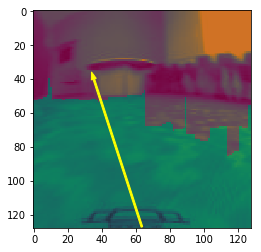

Feedback Trajectory:  (35.19714894872097, 40)


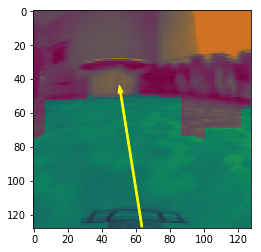

Feedback Trajectory:  (50.92579150634442, 48)


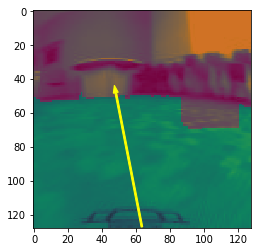

Feedback Trajectory:  (48.114973132213464, 48)


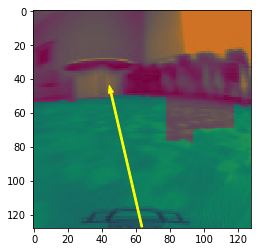

Feedback Trajectory:  (45.25903151601048, 48)


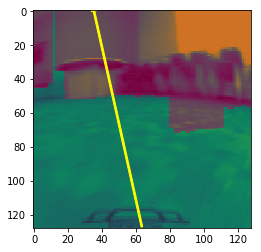

Feedback Trajectory:  (35.27543655965761, 0)


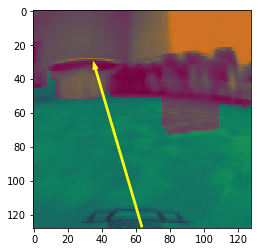

Feedback Trajectory:  (36.15830606883477, 34)


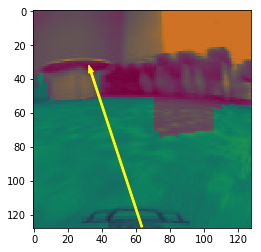

Feedback Trajectory:  (33.57801179972133, 36)


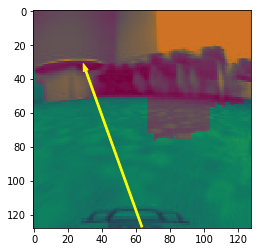

Feedback Trajectory:  (30.44424130979723, 35)


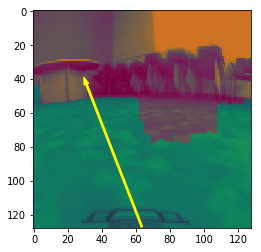

Feedback Trajectory:  (30.860143572806376, 43)


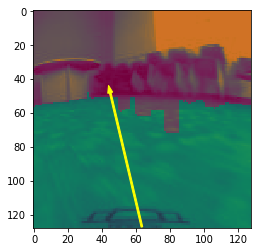

Feedback Trajectory:  (44.85550976401581, 48)


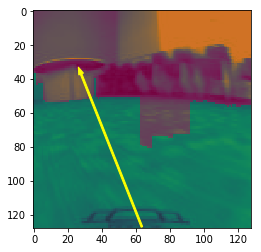

Feedback Trajectory:  (27.707306541875212, 37)


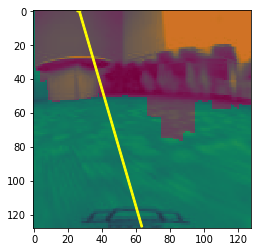

Feedback Trajectory:  (26.69023228587564, 0)


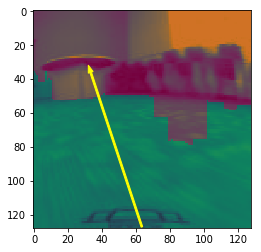

Feedback Trajectory:  (33.34297540316543, 36)


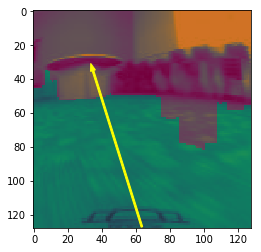

Feedback Trajectory:  (34.69248530521317, 35)


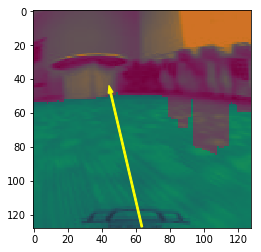

Feedback Trajectory:  (45.079163941221715, 48)


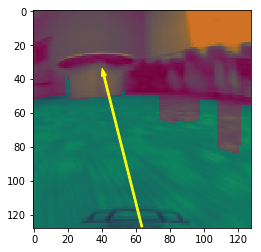

Feedback Trajectory:  (41.13535925546251, 38)


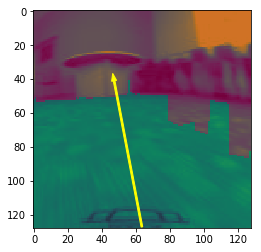

Feedback Trajectory:  (47.13249451750867, 41)


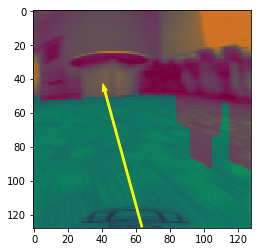

Feedback Trajectory:  (41.69534102276253, 47)


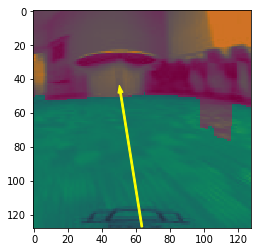

Feedback Trajectory:  (50.89484674276493, 48)


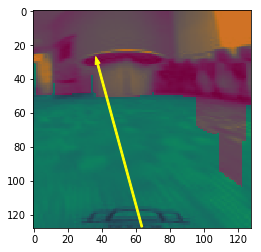

Feedback Trajectory:  (37.42649604177772, 31)


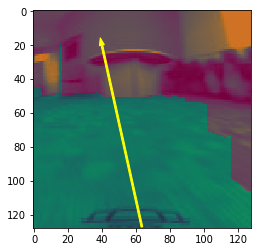

Feedback Trajectory:  (39.93638709708122, 20)


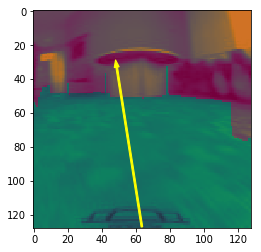

Feedback Trajectory:  (48.6592265178085, 33)


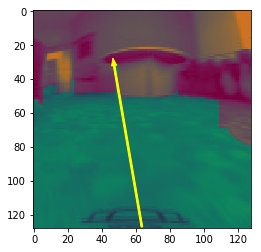

Feedback Trajectory:  (47.14185017873133, 32)


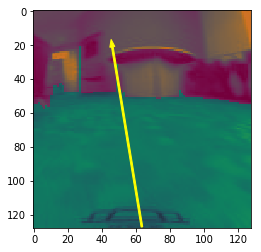

Feedback Trajectory:  (46.09183917059867, 21)


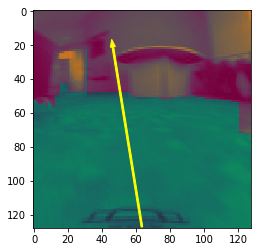

Feedback Trajectory:  (46.40143442855066, 21)


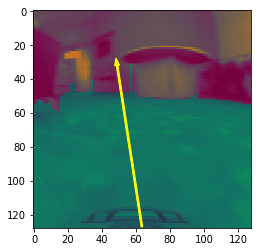

Feedback Trajectory:  (48.89926669978889, 32)


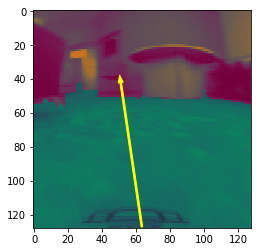

Feedback Trajectory:  (51.01809453598849, 42)


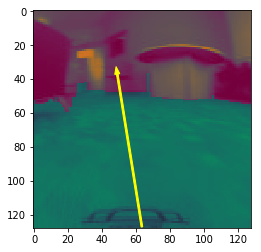

Feedback Trajectory:  (48.98999516263477, 37)


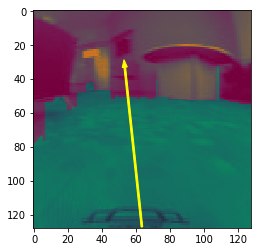

Feedback Trajectory:  (53.411705272751725, 33)


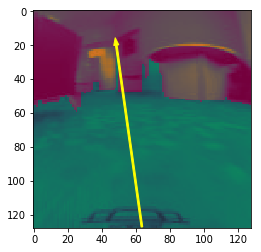

Feedback Trajectory:  (48.40468506589924, 20)


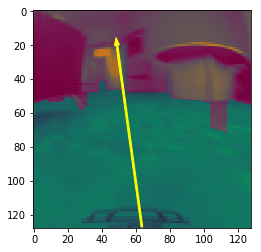

Feedback Trajectory:  (48.80902802422374, 20)


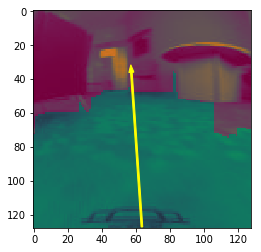

Feedback Trajectory:  (57.28289891315409, 36)


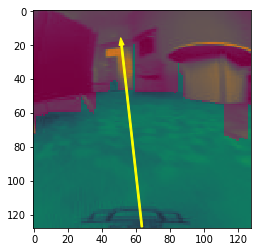

Feedback Trajectory:  (51.49996192387335, 20)


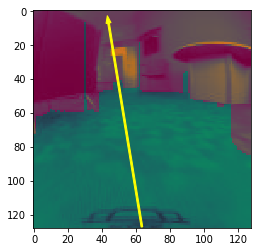

Feedback Trajectory:  (43.85468629494313, 7)


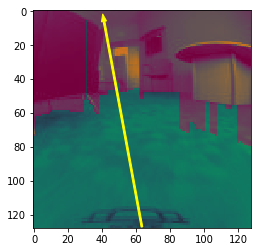

Feedback Trajectory:  (41.193409373087874, 6)


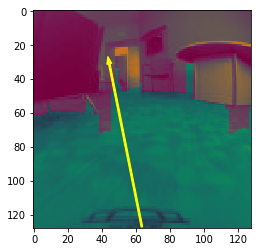

Feedback Trajectory:  (44.300320948473285, 31)


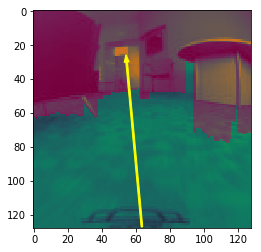

Feedback Trajectory:  (54.52120403170182, 30)


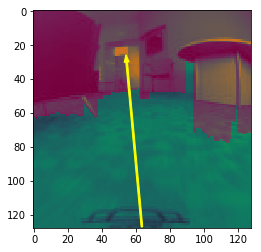

Feedback Trajectory:  (54.52120403170182, 30)


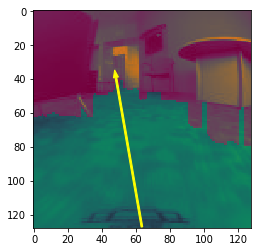

Feedback Trajectory:  (48.20306991027697, 39)


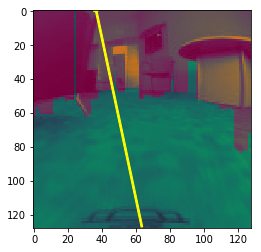

Feedback Trajectory:  (36.64196570420917, 0)


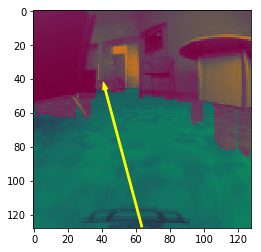

Feedback Trajectory:  (41.88797245388448, 46)


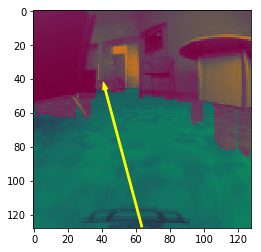

Feedback Trajectory:  (41.88797245388448, 46)


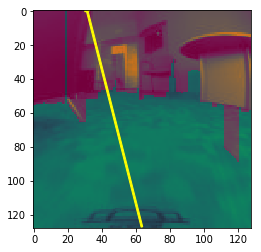

Feedback Trajectory:  (31.32812571412492, 0)


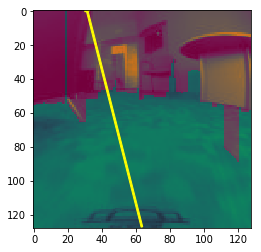

Feedback Trajectory:  (31.32812571412492, 0)


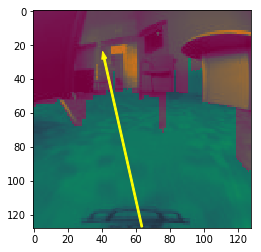

Feedback Trajectory:  (41.32262454728726, 28)


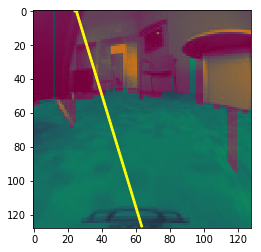

Feedback Trajectory:  (24.940866841624093, 0)


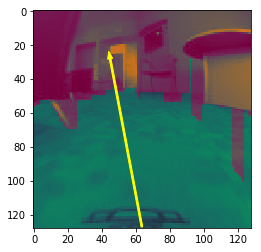

Feedback Trajectory:  (44.805683404732406, 28)


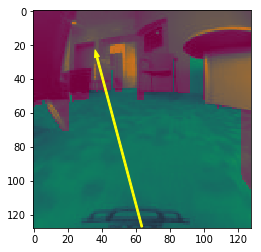

Feedback Trajectory:  (37.02934237931673, 27)


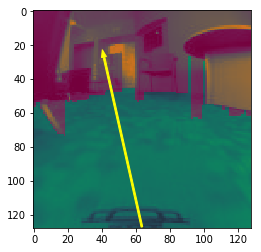

Feedback Trajectory:  (41.15331366516514, 27)


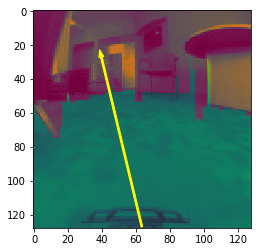

Feedback Trajectory:  (39.61424999709906, 27)


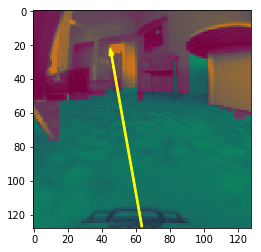

Feedback Trajectory:  (45.57621233737339, 26)


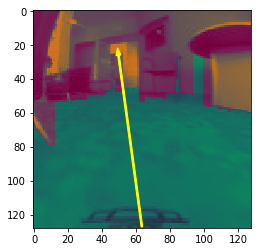

Feedback Trajectory:  (49.7204836225034, 26)


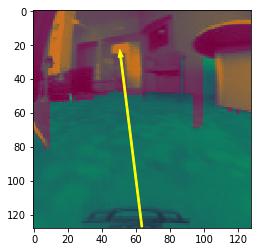

Feedback Trajectory:  (51.0033916062861, 27)


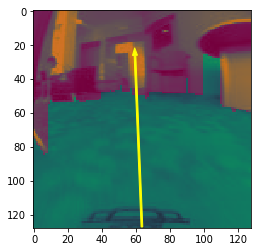

Feedback Trajectory:  (59.40953788202573, 26)


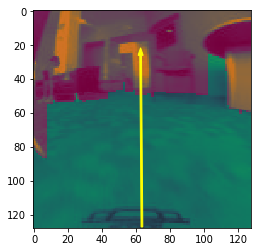

Feedback Trajectory:  (62.74568583446649, 26)


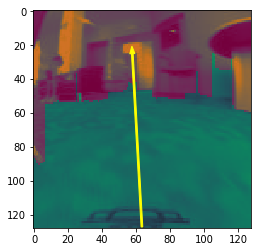

Feedback Trajectory:  (57.84989599456213, 25)


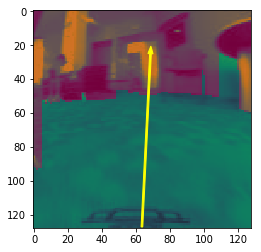

Feedback Trajectory:  (68.5398374569399, 25)


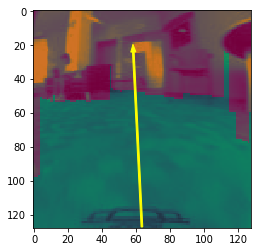

Feedback Trajectory:  (58.44021103279603, 24)


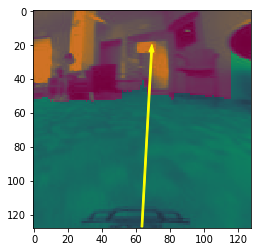

Feedback Trajectory:  (69.14068738208171, 24)


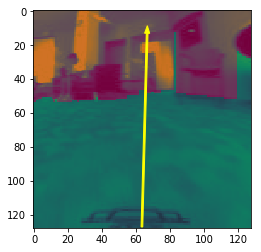

Feedback Trajectory:  (66.568167611029, 13)


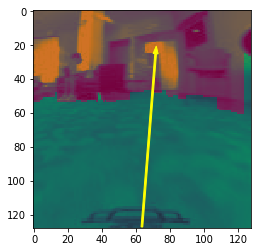

Feedback Trajectory:  (71.57547801733982, 25)


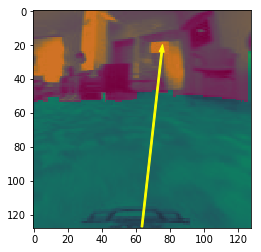

Feedback Trajectory:  (75.14144736841313, 24)


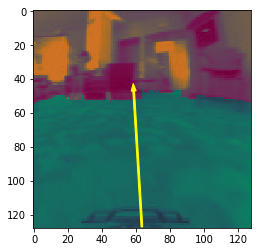

Feedback Trajectory:  (58.64824663737694, 47)


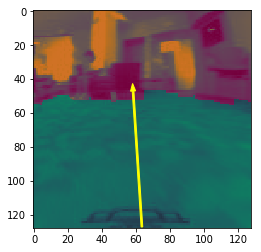

Feedback Trajectory:  (58.292007787034535, 47)


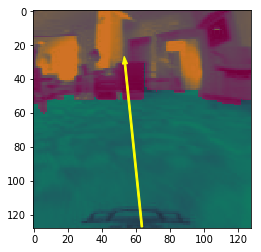

Feedback Trajectory:  (53.52724694966206, 31)


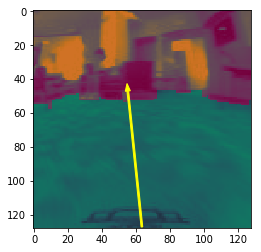

Feedback Trajectory:  (55.193864835210555, 47)


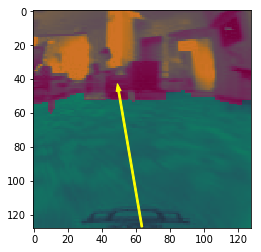

Feedback Trajectory:  (49.793548722871506, 47)


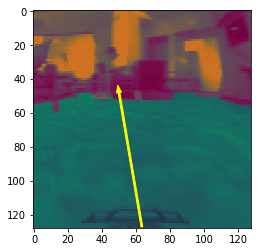

Feedback Trajectory:  (50.02285914281771, 48)


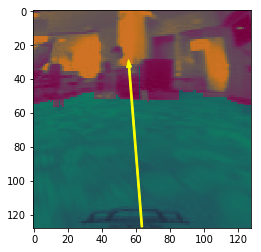

Feedback Trajectory:  (55.94825618230978, 33)


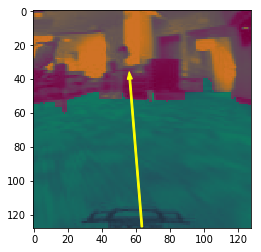

Feedback Trajectory:  (56.36979150106339, 40)


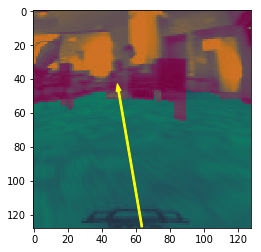

Feedback Trajectory:  (49.76152764329724, 47)


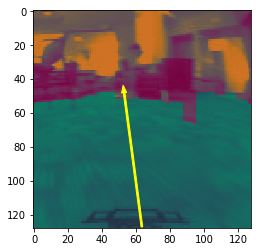

Feedback Trajectory:  (53.02079653381157, 48)


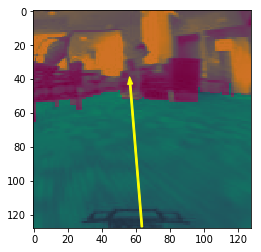

Feedback Trajectory:  (56.58047637956137, 43)


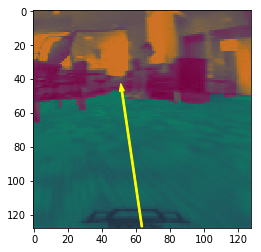

Feedback Trajectory:  (51.69512808824234, 47)


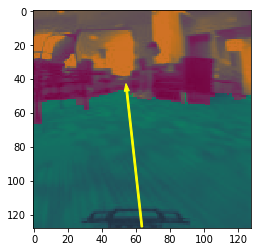

Feedback Trajectory:  (54.593573412240836, 47)


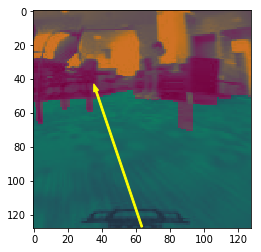

Feedback Trajectory:  (36.54830405725813, 47)


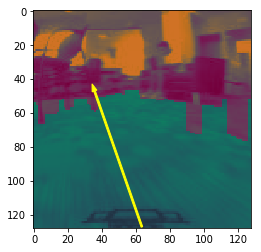

Feedback Trajectory:  (35.615109123390894, 47)


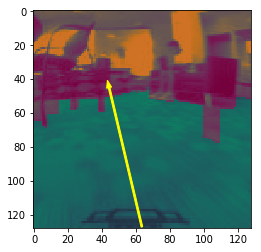

Feedback Trajectory:  (44.19896750876501, 45)


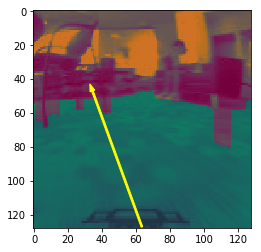

Feedback Trajectory:  (34.37695589740982, 47)


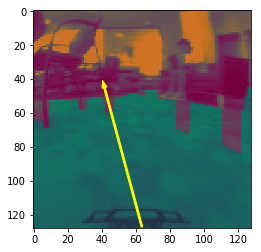

Feedback Trajectory:  (41.46063142483332, 45)


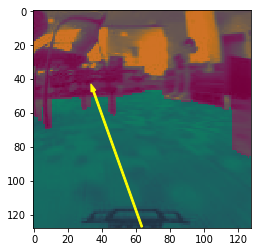

Feedback Trajectory:  (34.946061820575885, 47)


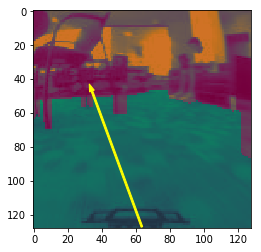

Feedback Trajectory:  (34.05617924291694, 47)


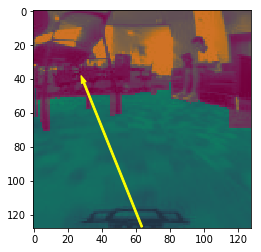

Feedback Trajectory:  (29.302796683799908, 42)


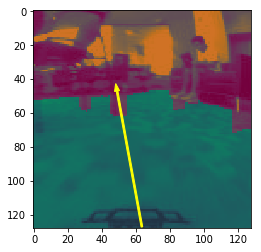

Feedback Trajectory:  (48.86163032111216, 47)


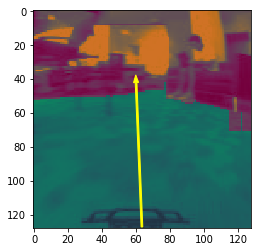

Feedback Trajectory:  (60.05892773341178, 42)


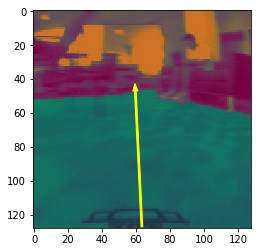

Feedback Trajectory:  (59.62113285814761, 47)


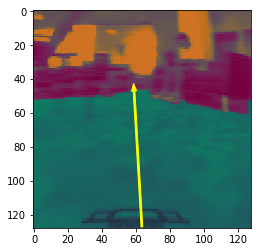

Feedback Trajectory:  (58.87150085656903, 47)


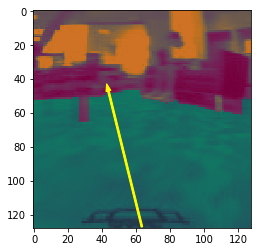

Feedback Trajectory:  (43.78989801071198, 47)


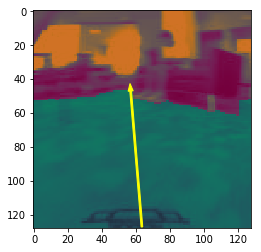

Feedback Trajectory:  (56.86592866013924, 47)


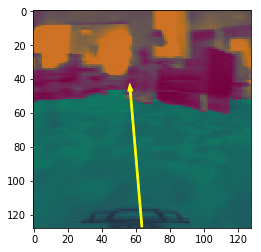

Feedback Trajectory:  (56.6593322802236, 47)


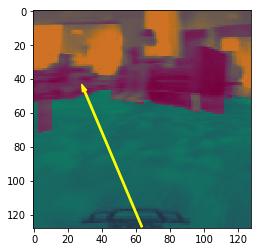

Feedback Trajectory:  (29.7259999490903, 47)


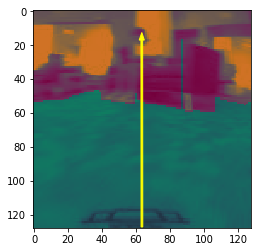

Feedback Trajectory:  (63.42265564435599, 17)


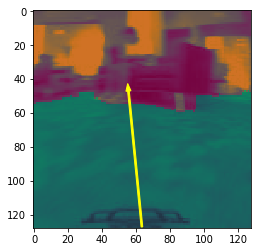

Feedback Trajectory:  (55.56779889214797, 47)


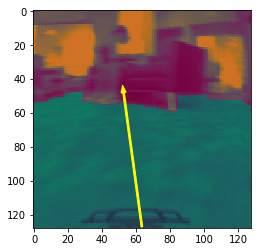

Feedback Trajectory:  (52.723360854256995, 48)


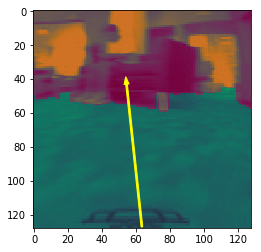

Feedback Trajectory:  (54.45791128732971, 43)


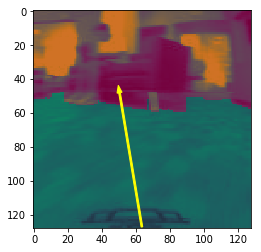

Feedback Trajectory:  (50.329364046327925, 48)


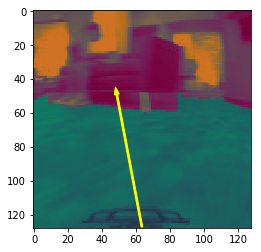

Feedback Trajectory:  (48.71864261927406, 49)


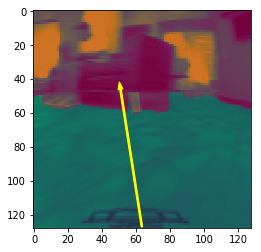

Feedback Trajectory:  (50.89197956487172, 46)


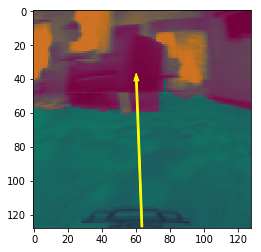

Feedback Trajectory:  (60.25821364926496, 41)


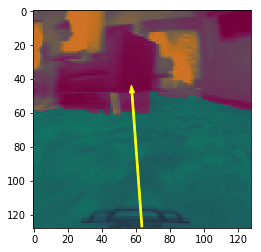

Feedback Trajectory:  (57.63464650979571, 48)


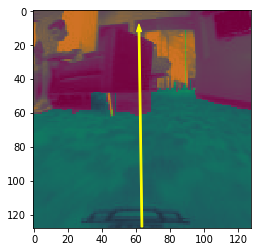

Feedback Trajectory:  (61.800447125400275, 12)


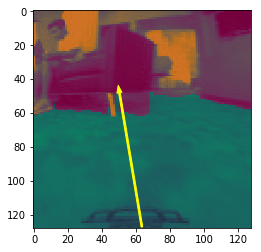

Feedback Trajectory:  (50.27056565626894, 48)


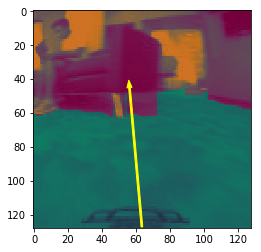

Feedback Trajectory:  (56.17761125467261, 45)


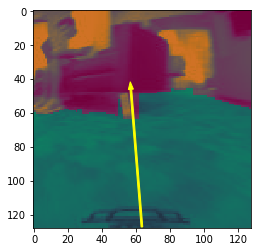

Feedback Trajectory:  (56.99558272620599, 46)


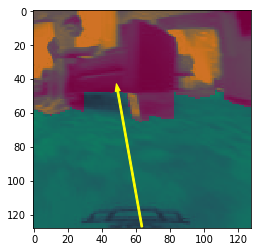

Feedback Trajectory:  (49.24742180095456, 47)


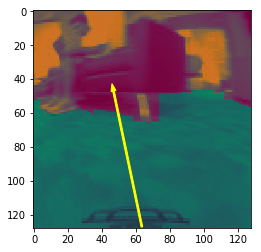

Feedback Trajectory:  (46.78119489028011, 47)


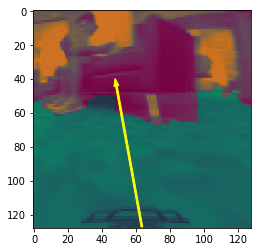

Feedback Trajectory:  (48.47993285136166, 44)


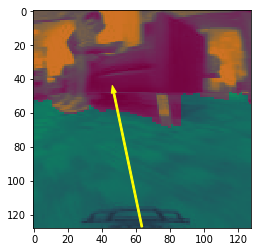

Feedback Trajectory:  (46.94838091664976, 48)


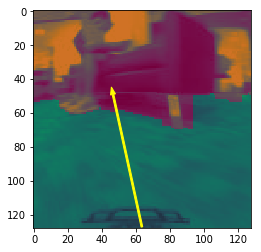

Feedback Trajectory:  (46.48680155592833, 49)


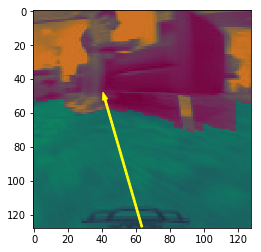

Feedback Trajectory:  (41.800199419575485, 52)


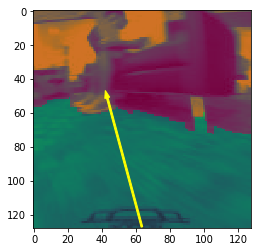

Feedback Trajectory:  (43.1019621508376, 51)


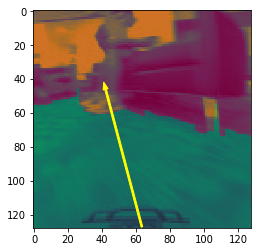

Feedback Trajectory:  (42.11633949040734, 46)


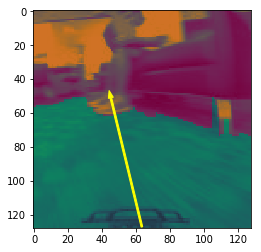

Feedback Trajectory:  (45.209548408605976, 51)


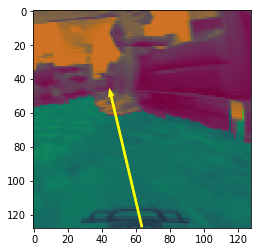

Feedback Trajectory:  (45.38786580424325, 50)


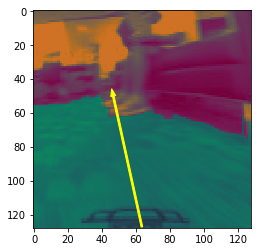

Feedback Trajectory:  (46.63301204297238, 50)


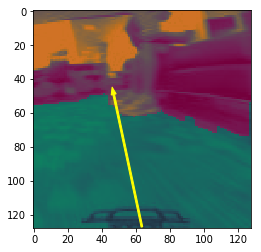

Feedback Trajectory:  (46.88426061823901, 49)


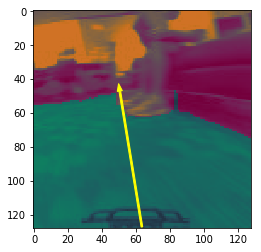

Feedback Trajectory:  (50.47711327917878, 47)


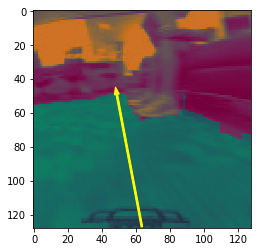

Feedback Trajectory:  (48.73389665646165, 49)


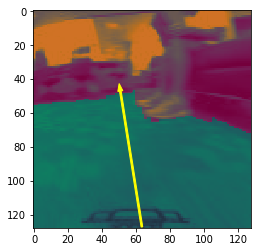

Feedback Trajectory:  (50.787575745050646, 47)


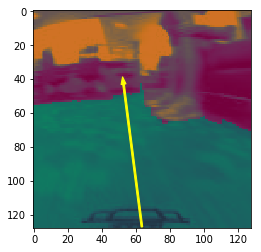

Feedback Trajectory:  (52.679121929452684, 43)


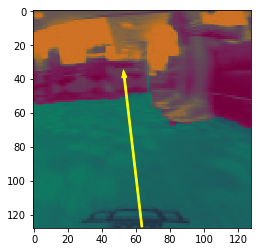

Feedback Trajectory:  (53.13218887919187, 39)


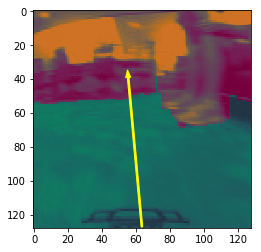

Feedback Trajectory:  (55.41198185013319, 39)


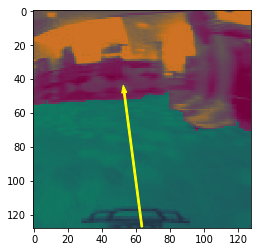

Feedback Trajectory:  (53.08888567715434, 48)


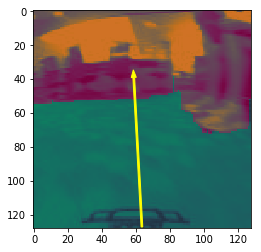

Feedback Trajectory:  (58.69665646560996, 39)


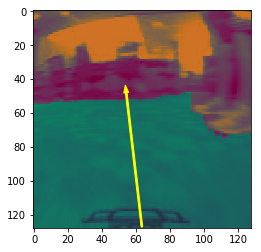

Feedback Trajectory:  (54.26351174052059, 48)


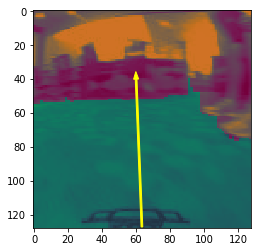

Feedback Trajectory:  (60.08590241821178, 40)


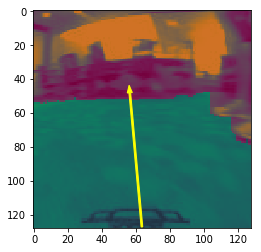

Feedback Trajectory:  (56.358790213539685, 48)


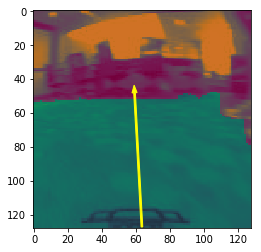

Feedback Trajectory:  (59.15914460208095, 48)


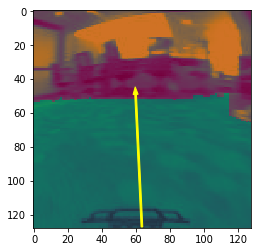

Feedback Trajectory:  (59.77777073163582, 49)


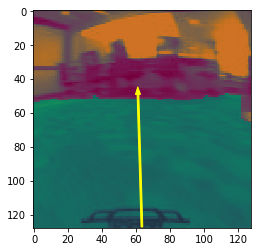

Feedback Trajectory:  (61.17562122052419, 49)


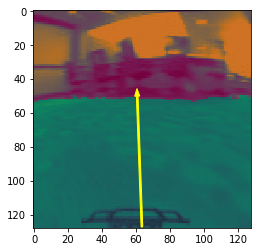

Feedback Trajectory:  (60.73876555712711, 50)


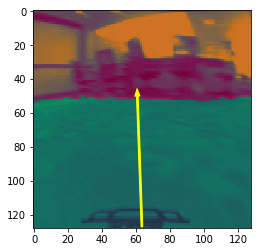

Feedback Trajectory:  (60.81110458064351, 50)


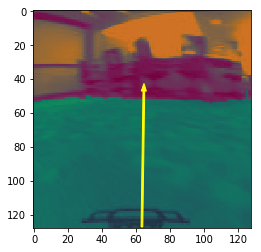

Feedback Trajectory:  (64.63908188116152, 47)


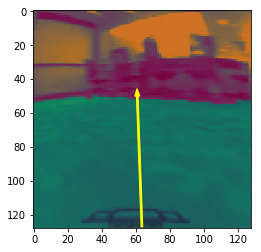

Feedback Trajectory:  (60.760998648745, 50)


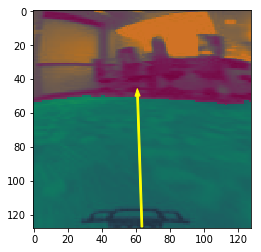

Feedback Trajectory:  (60.93249372835576, 50)


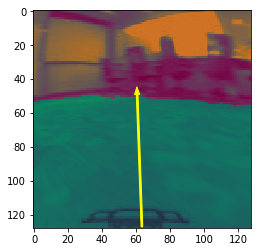

Feedback Trajectory:  (60.69482409264237, 49)


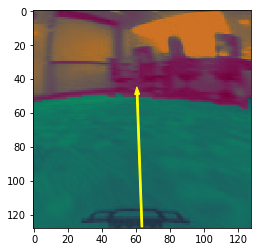

Feedback Trajectory:  (60.69705281757343, 49)


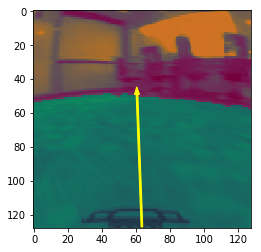

Feedback Trajectory:  (60.60884575363214, 49)


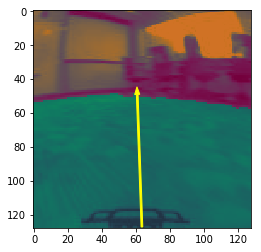

Feedback Trajectory:  (60.73820972194279, 49)


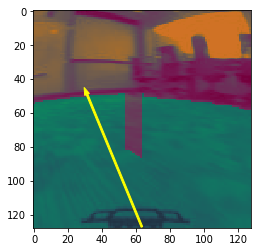

Feedback Trajectory:  (31.198335984753086, 49)


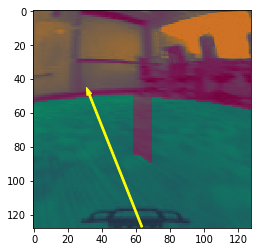

Feedback Trajectory:  (32.50343764930795, 49)


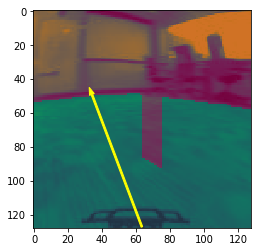

Feedback Trajectory:  (34.05451246076352, 49)


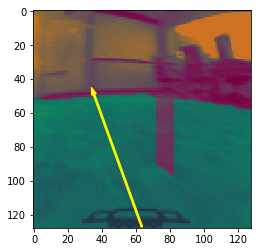

Feedback Trajectory:  (35.26404054666901, 49)


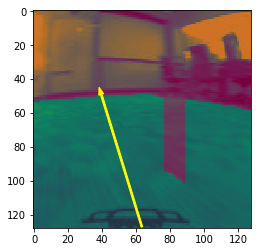

Feedback Trajectory:  (39.55410132093656, 49)


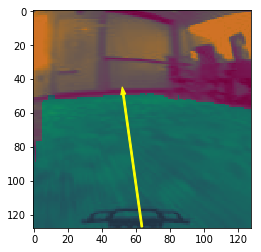

Feedback Trajectory:  (52.52420547884334, 49)


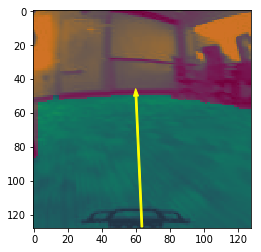

Feedback Trajectory:  (60.02123575147128, 50)


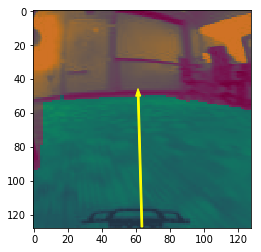

Feedback Trajectory:  (61.316005813865, 50)


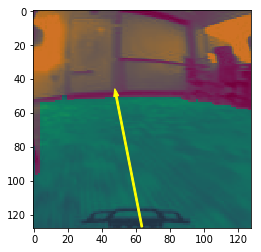

Feedback Trajectory:  (48.377705816337865, 50)


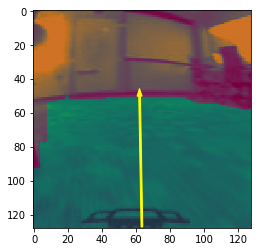

Feedback Trajectory:  (62.13259256643797, 50)


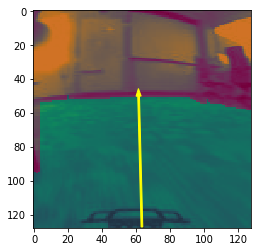

Feedback Trajectory:  (61.5540299383769, 50)


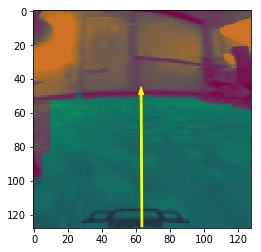

Feedback Trajectory:  (63.0358830839367, 49)


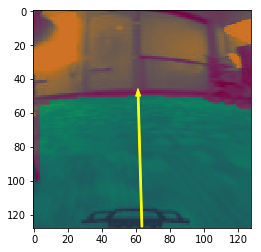

Feedback Trajectory:  (61.28773939506044, 50)


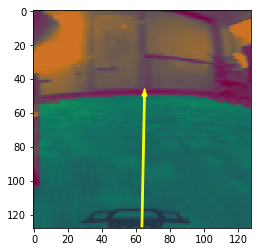

Feedback Trajectory:  (65.00407908907292, 50)


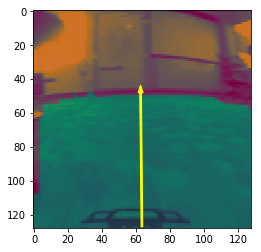

Feedback Trajectory:  (62.726267780341374, 48)


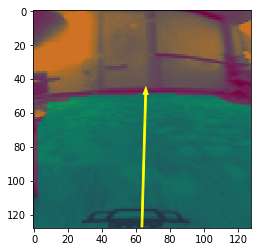

Feedback Trajectory:  (65.70294120250881, 49)


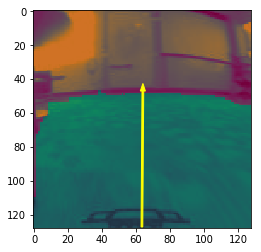

Feedback Trajectory:  (64.05124393403854, 47)


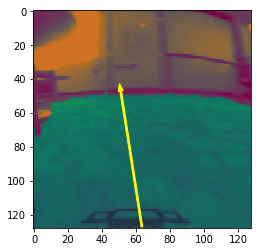

Feedback Trajectory:  (51.003144757210734, 47)


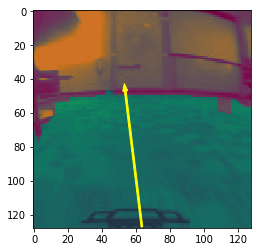

Feedback Trajectory:  (53.68933736255812, 47)


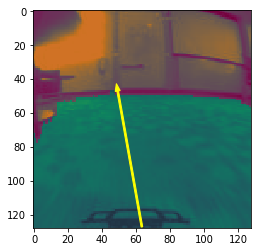

Feedback Trajectory:  (49.247719245742175, 47)


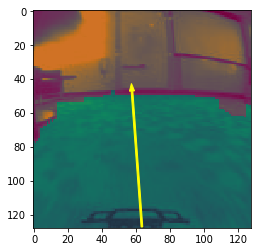

Feedback Trajectory:  (57.65378523463678, 47)


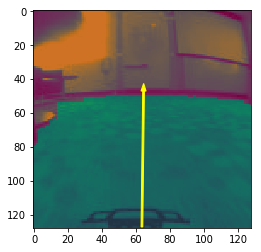

Feedback Trajectory:  (64.46106102292929, 47)


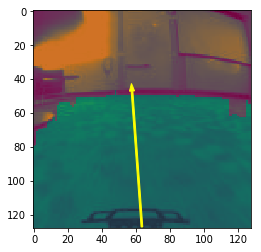

Feedback Trajectory:  (57.66203685804927, 47)


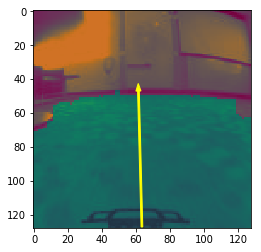

Feedback Trajectory:  (61.45382679339244, 47)


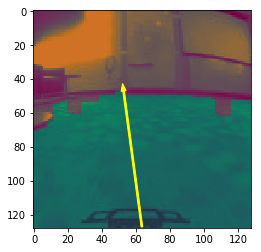

Feedback Trajectory:  (52.71793390369642, 47)


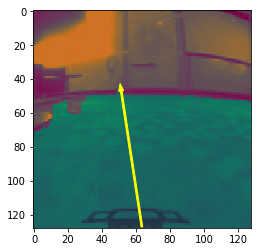

Feedback Trajectory:  (51.31178132579498, 47)


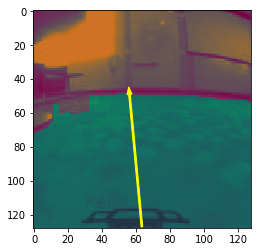

Feedback Trajectory:  (56.162439713442865, 49)


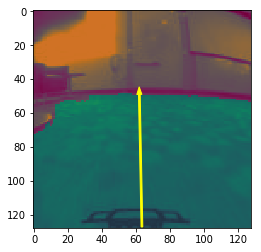

Feedback Trajectory:  (61.98318433249868, 49)


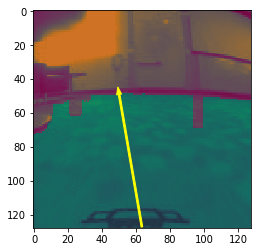

Feedback Trajectory:  (50.07125001412866, 49)


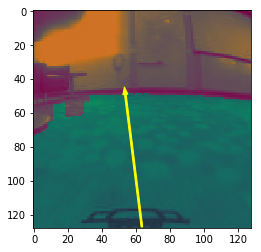

Feedback Trajectory:  (53.75154475055985, 49)


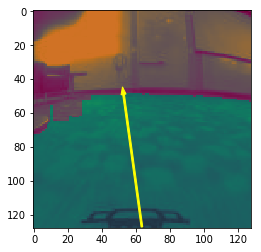

Feedback Trajectory:  (52.68882448900449, 49)


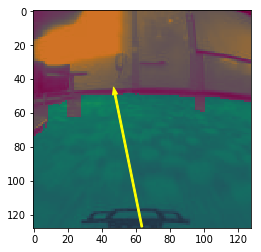

Feedback Trajectory:  (47.66152333545681, 49)


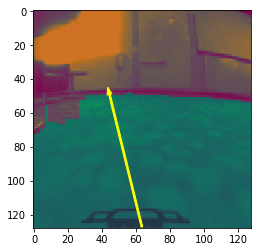

Feedback Trajectory:  (44.41886547129724, 49)


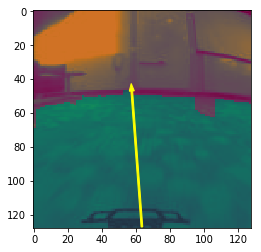

Feedback Trajectory:  (57.52597519218172, 47)


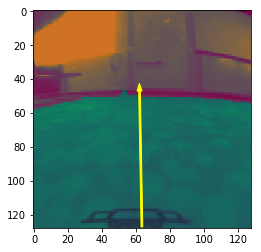

Feedback Trajectory:  (62.10217910797223, 47)


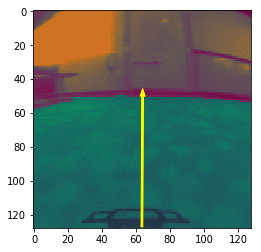

Feedback Trajectory:  (63.912382577989085, 50)


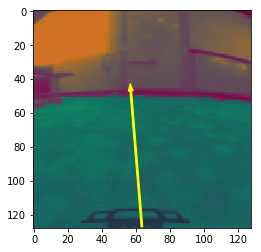

Feedback Trajectory:  (56.94686822421728, 47)


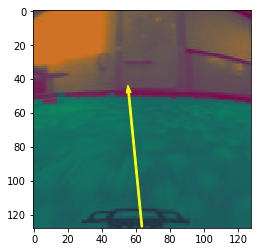

Feedback Trajectory:  (55.67737058228856, 48)


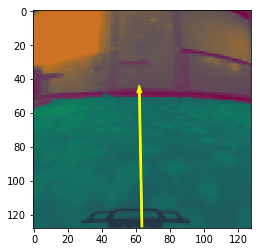

Feedback Trajectory:  (62.00276449837669, 48)


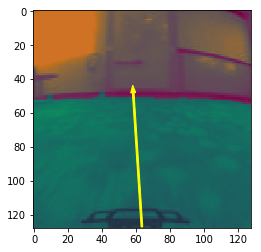

Feedback Trajectory:  (58.37283251268646, 48)


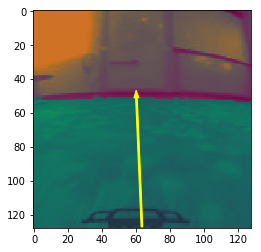

Feedback Trajectory:  (60.28154993527486, 51)


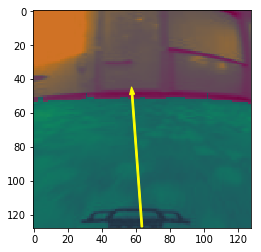

Feedback Trajectory:  (57.72899387893739, 49)


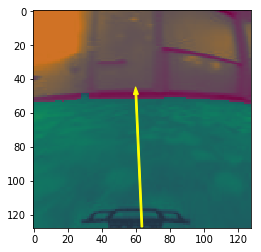

Feedback Trajectory:  (59.97664419298776, 49)


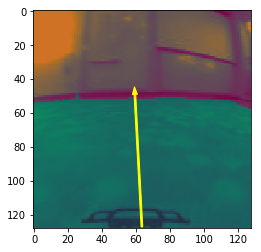

Feedback Trajectory:  (59.364612946368716, 49)


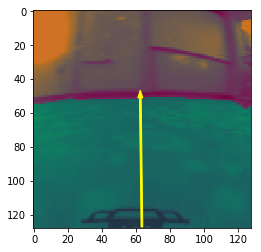

Feedback Trajectory:  (62.556409608513874, 51)


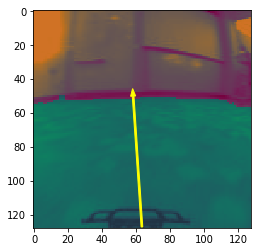

Feedback Trajectory:  (58.32208684341338, 50)


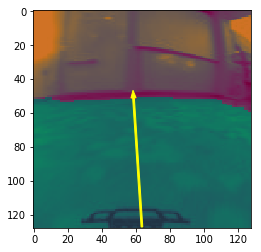

Feedback Trajectory:  (58.541478814069485, 51)


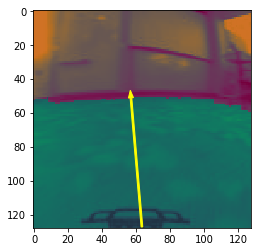

Feedback Trajectory:  (57.04376565685875, 51)


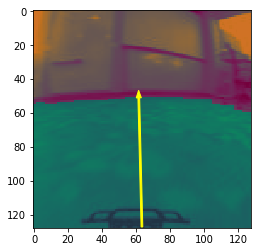

Feedback Trajectory:  (61.65776645908575, 51)


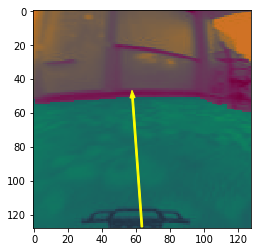

Feedback Trajectory:  (57.973757913159616, 51)


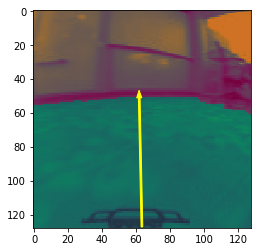

Feedback Trajectory:  (61.923675400887724, 51)


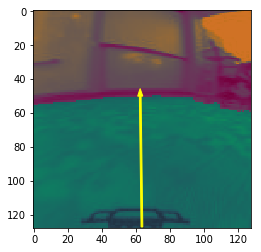

Feedback Trajectory:  (62.50647684721301, 50)


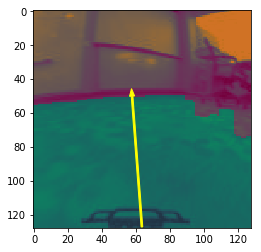

Feedback Trajectory:  (57.70632830058808, 50)


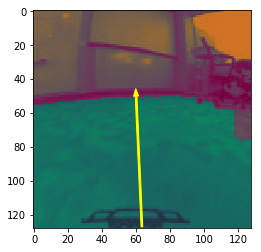

Feedback Trajectory:  (60.06205308198173, 50)


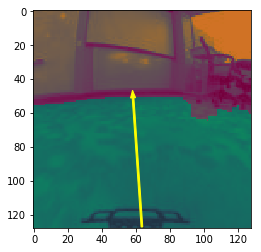

Feedback Trajectory:  (58.28431721807774, 51)


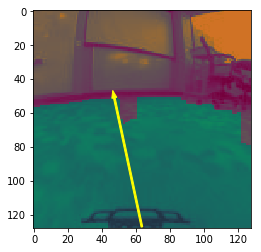

Feedback Trajectory:  (47.2479047953428, 51)


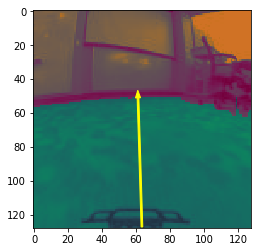

Feedback Trajectory:  (61.199260935110416, 51)


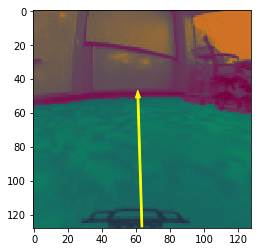

Feedback Trajectory:  (61.17053985294426, 51)


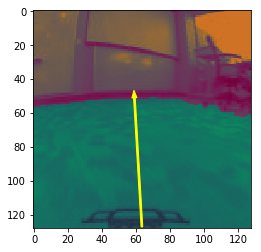

Feedback Trajectory:  (59.07831429410433, 51)


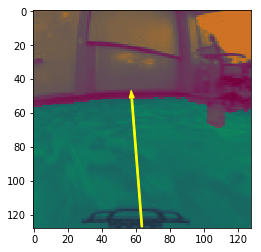

Feedback Trajectory:  (57.50465844660499, 51)


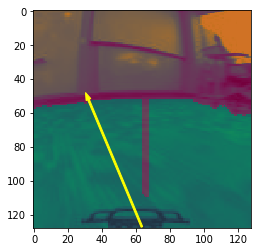

Feedback Trajectory:  (32.02509773575172, 52)


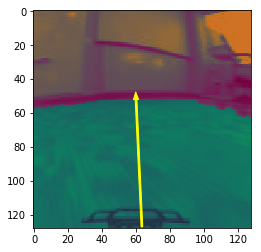

Feedback Trajectory:  (60.045527667275856, 52)


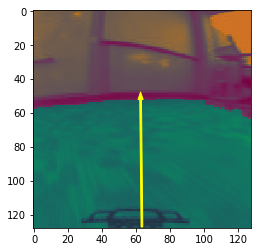

Feedback Trajectory:  (62.724718784030834, 52)


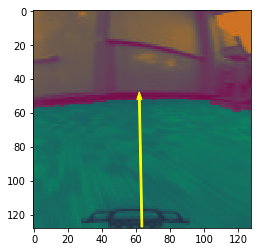

Feedback Trajectory:  (62.00639021633099, 52)


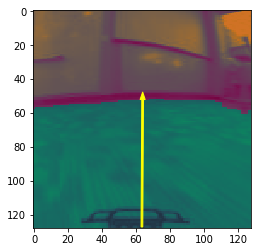

Feedback Trajectory:  (63.91810106164715, 52)


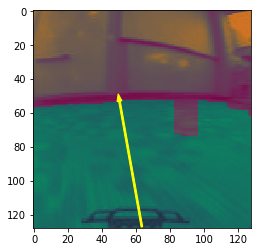

Feedback Trajectory:  (50.30401349299485, 53)


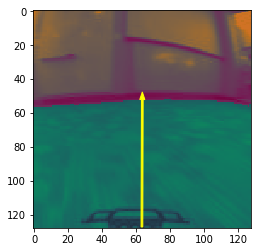

Feedback Trajectory:  (63.724798358101786, 52)


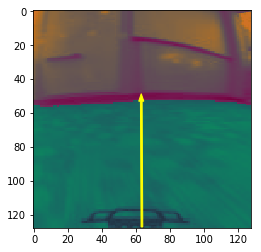

Feedback Trajectory:  (63.12476423794444, 53)


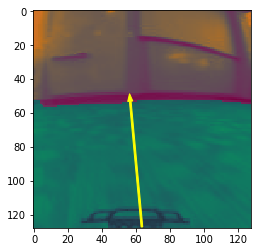

Feedback Trajectory:  (56.62660411837314, 53)


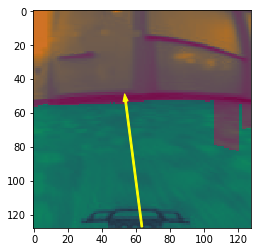

Feedback Trajectory:  (53.880402207890455, 53)


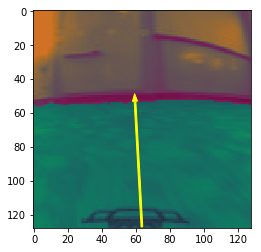

Feedback Trajectory:  (59.43791819493606, 53)


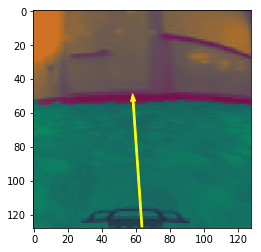

Feedback Trajectory:  (58.32228094070567, 53)


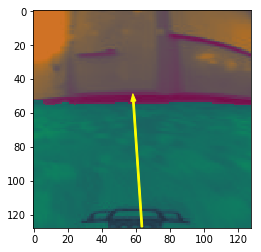

Feedback Trajectory:  (58.460636729922854, 53)


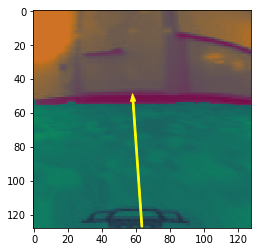

Feedback Trajectory:  (58.28085918823132, 53)


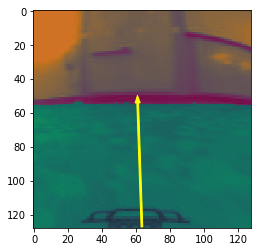

Feedback Trajectory:  (61.015802476423424, 54)


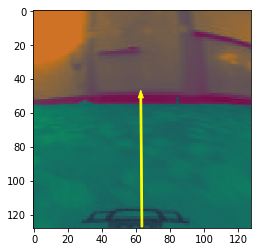

Feedback Trajectory:  (62.842174865735146, 51)


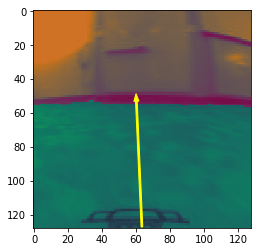

Feedback Trajectory:  (60.23948494970514, 53)


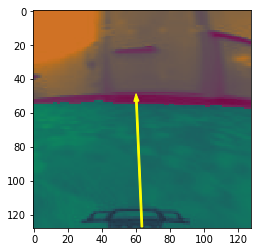

Feedback Trajectory:  (60.237136804661205, 53)


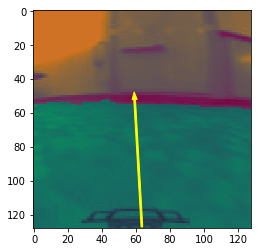

Feedback Trajectory:  (59.2093324470212, 52)


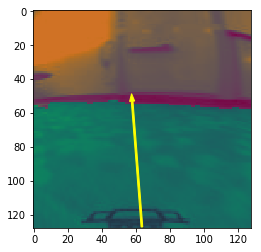

Feedback Trajectory:  (57.74215542082588, 53)


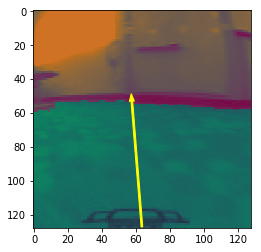

Feedback Trajectory:  (57.56602778116672, 53)


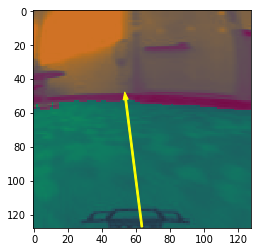

Feedback Trajectory:  (53.94478301469572, 52)


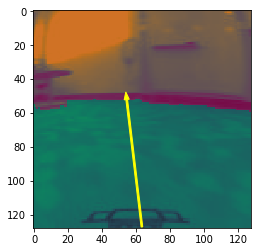

Feedback Trajectory:  (54.543786517635226, 52)


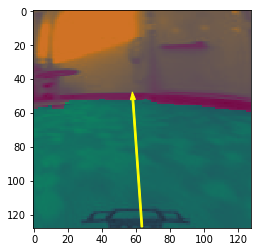

Feedback Trajectory:  (58.18943970910226, 52)


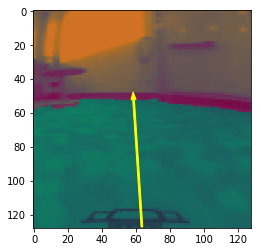

Feedback Trajectory:  (58.579452103390494, 52)


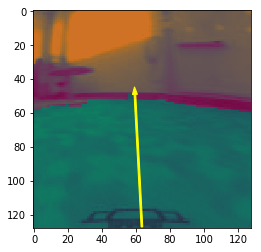

Feedback Trajectory:  (59.3765010198347, 49)


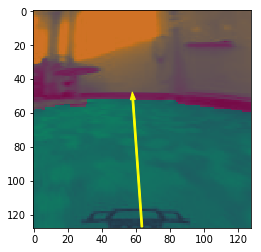

Feedback Trajectory:  (58.16016030208995, 52)


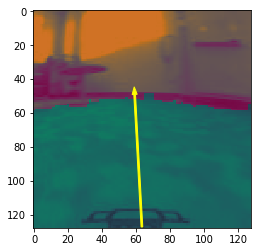

Feedback Trajectory:  (59.220918837409826, 49)


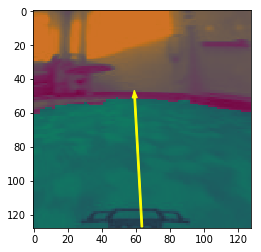

Feedback Trajectory:  (59.25841212255062, 51)


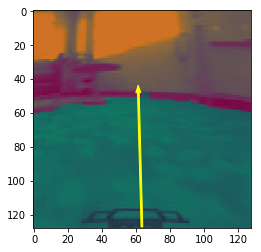

Feedback Trajectory:  (61.39636419432551, 48)


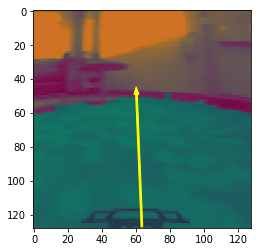

Feedback Trajectory:  (60.300113368936486, 49)


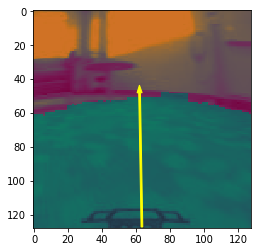

Feedback Trajectory:  (62.121203308201714, 48)


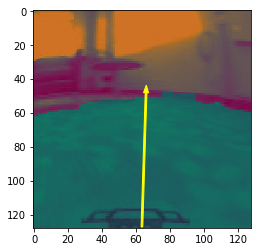

Feedback Trajectory:  (65.94130035308235, 48)


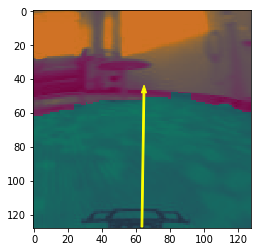

Feedback Trajectory:  (64.68690100039834, 48)


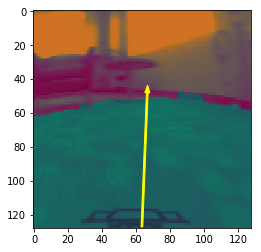

Feedback Trajectory:  (66.66390747924675, 48)


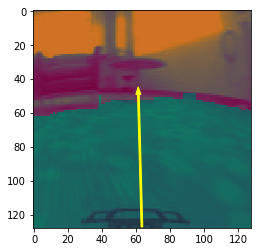

Feedback Trajectory:  (61.410722793387414, 49)


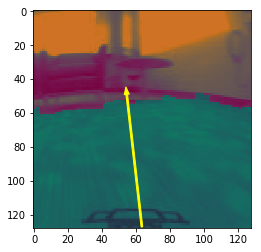

Feedback Trajectory:  (54.56640857216405, 49)


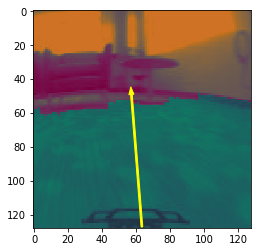

Feedback Trajectory:  (57.3080391010092, 49)


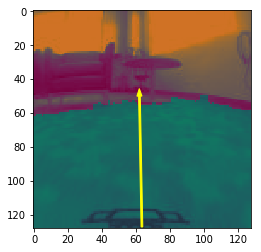

Feedback Trajectory:  (62.043175764558924, 50)


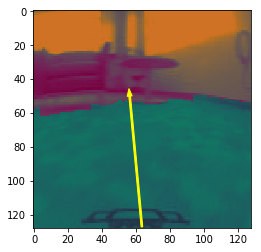

Feedback Trajectory:  (56.29063261095059, 50)


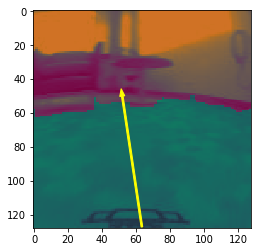

Feedback Trajectory:  (51.93870508549536, 50)


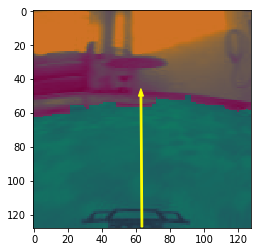

Feedback Trajectory:  (62.92662562483928, 50)


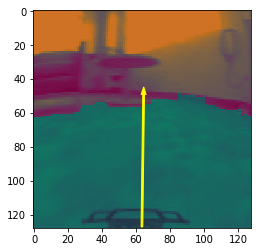

Feedback Trajectory:  (64.50195628934134, 49)


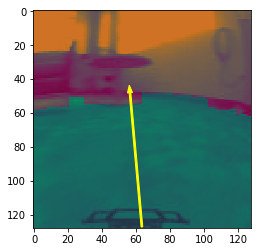

Feedback Trajectory:  (56.46968700569469, 48)


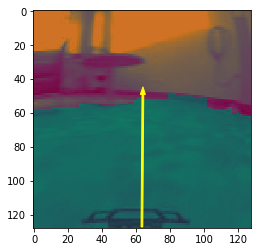

Feedback Trajectory:  (64.0654592209458, 49)


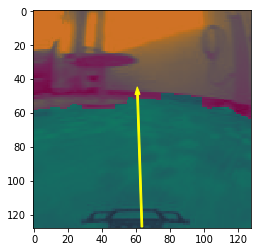

Feedback Trajectory:  (60.89604724243612, 49)


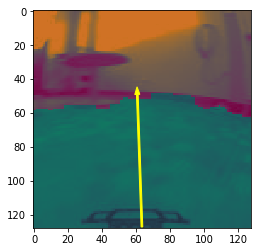

Feedback Trajectory:  (60.78621823894792, 49)


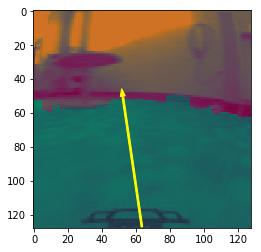

Feedback Trajectory:  (52.22557057447066, 50)


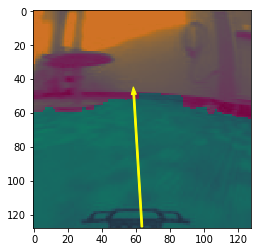

Feedback Trajectory:  (58.72270053454802, 49)


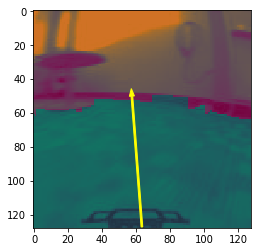

Feedback Trajectory:  (57.60126351767129, 50)


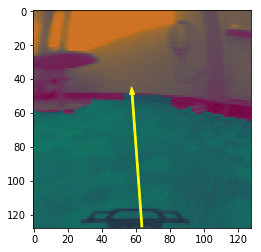

Feedback Trajectory:  (57.74675454340256, 49)


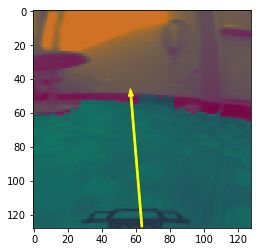

Feedback Trajectory:  (57.05396929720829, 50)


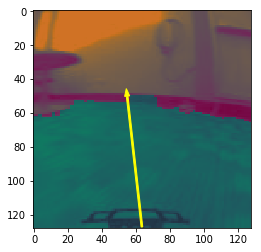

Feedback Trajectory:  (54.80811408612013, 50)


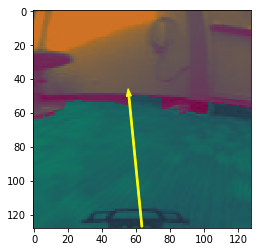

Feedback Trajectory:  (55.83159244862904, 50)


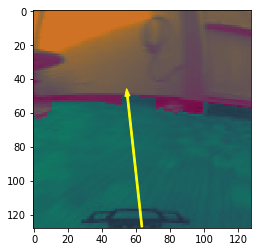

Feedback Trajectory:  (54.964006269930735, 50)


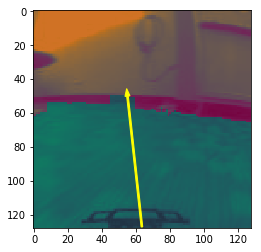

Feedback Trajectory:  (55.00665358354423, 50)


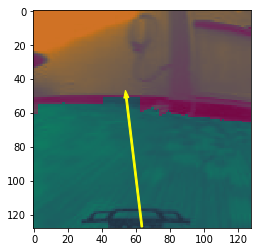

Feedback Trajectory:  (54.325464673187284, 51)


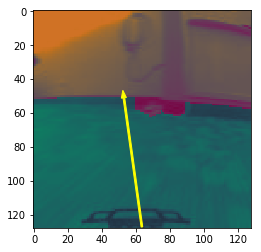

Feedback Trajectory:  (52.87947702367489, 51)


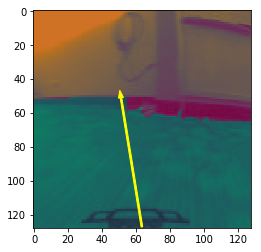

Feedback Trajectory:  (51.17938027980765, 51)


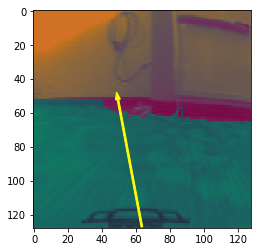

Feedback Trajectory:  (49.3836779321201, 52)


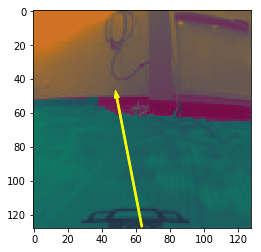

Feedback Trajectory:  (48.74793366665373, 51)


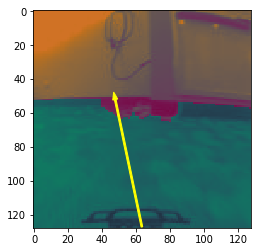

Feedback Trajectory:  (47.79072172515183, 52)


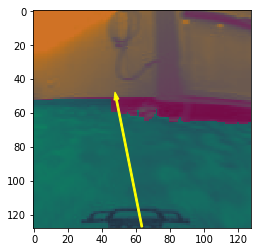

Feedback Trajectory:  (48.50016992775827, 52)


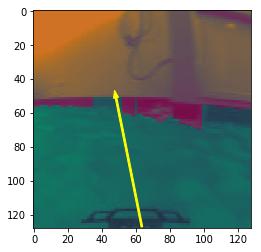

Feedback Trajectory:  (48.258457860995435, 51)


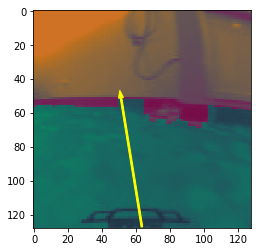

Feedback Trajectory:  (51.182260945090555, 51)


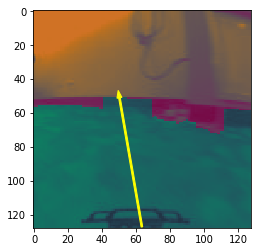

Feedback Trajectory:  (50.28107271553852, 51)


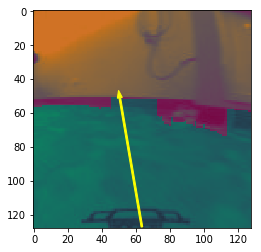

Feedback Trajectory:  (50.48621365836928, 51)


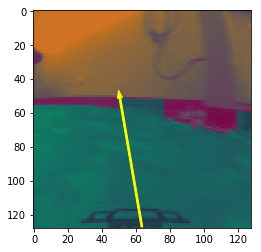

Feedback Trajectory:  (50.52484295273619, 51)


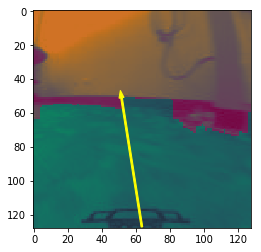

Feedback Trajectory:  (51.49870109881644, 51)


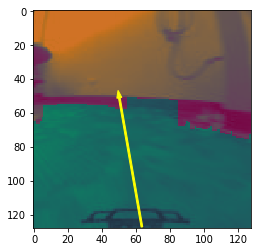

Feedback Trajectory:  (50.20867286486236, 51)


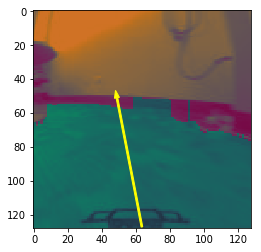

Feedback Trajectory:  (48.797909281486525, 51)


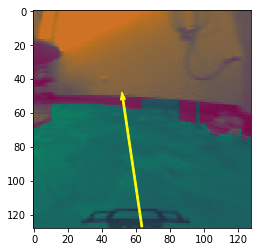

Feedback Trajectory:  (52.345378092430636, 52)


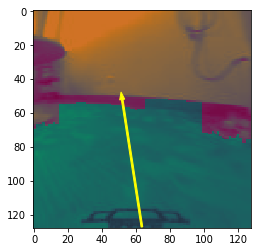

Feedback Trajectory:  (51.8964828228257, 52)


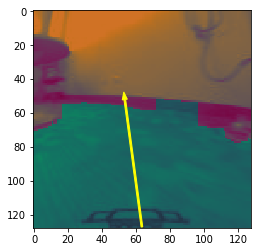

Feedback Trajectory:  (53.423843113251685, 52)


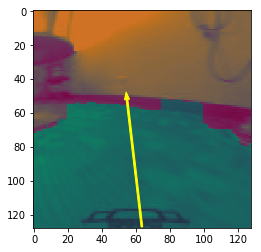

Feedback Trajectory:  (54.71210491748268, 52)


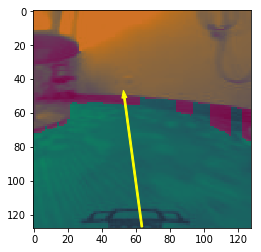

Feedback Trajectory:  (53.19168688093072, 51)


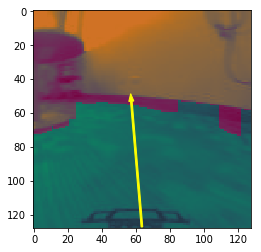

Feedback Trajectory:  (57.260353458069055, 53)


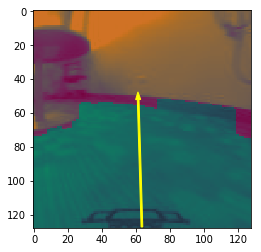

Feedback Trajectory:  (61.28882955814151, 52)


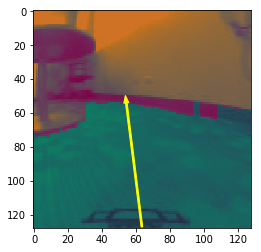

Feedback Trajectory:  (54.32014906380429, 54)


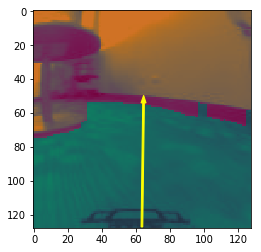

Feedback Trajectory:  (64.45121570884572, 54)


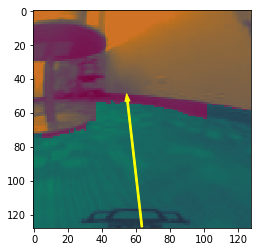

Feedback Trajectory:  (54.997781498482325, 53)


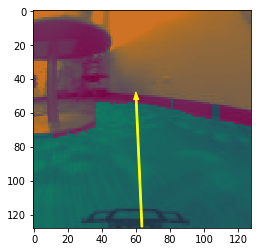

Feedback Trajectory:  (60.12840756226533, 52)


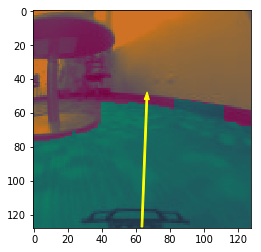

Feedback Trajectory:  (66.3725796669634, 52)


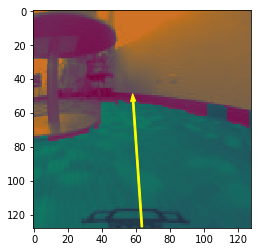

Feedback Trajectory:  (58.32823559214554, 53)


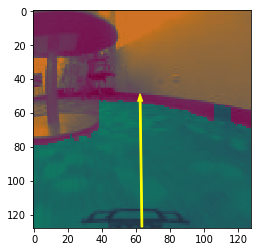

Feedback Trajectory:  (62.456128480786425, 53)


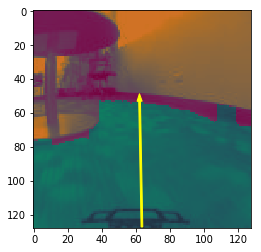

Feedback Trajectory:  (62.128911547428906, 53)


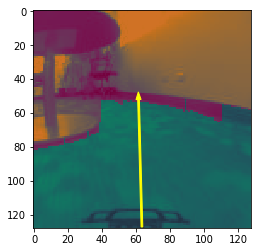

Feedback Trajectory:  (61.51131176362548, 52)


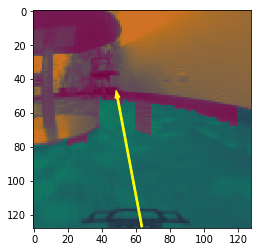

Feedback Trajectory:  (49.12606158164986, 51)


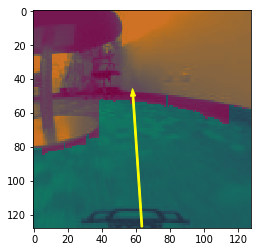

Feedback Trajectory:  (58.258224792296865, 50)


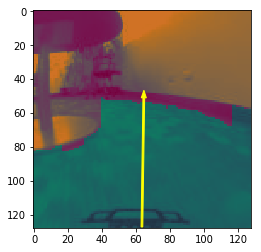

Feedback Trajectory:  (64.6090228796604, 51)


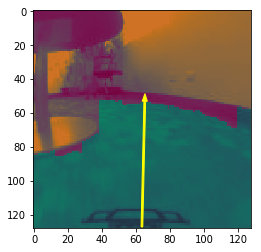

Feedback Trajectory:  (65.17878169609729, 53)


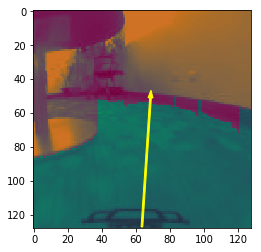

Feedback Trajectory:  (68.55431225178475, 51)


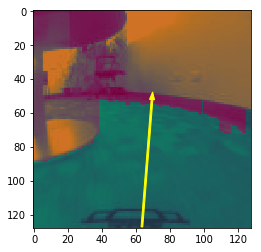

Feedback Trajectory:  (69.44603640411968, 52)


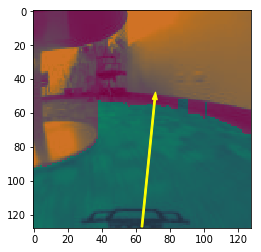

Feedback Trajectory:  (71.06294460948949, 52)


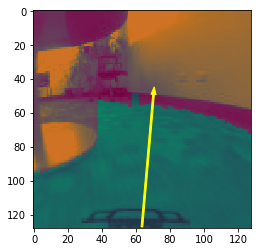

Feedback Trajectory:  (70.33733047277974, 49)


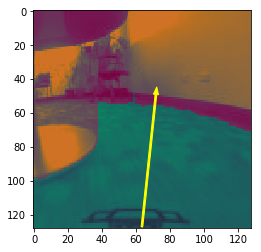

Feedback Trajectory:  (71.75883551748933, 49)


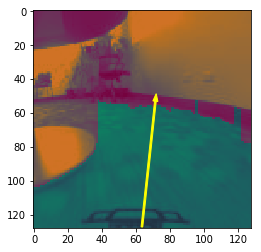

Feedback Trajectory:  (71.42823300778355, 53)


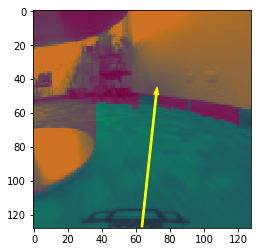

Feedback Trajectory:  (71.95621722154438, 49)


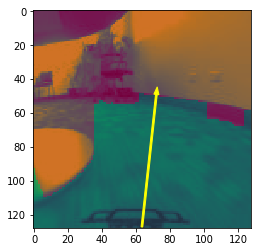

Feedback Trajectory:  (72.01587236793539, 49)


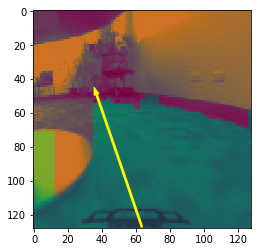

Feedback Trajectory:  (36.790880730772535, 49)


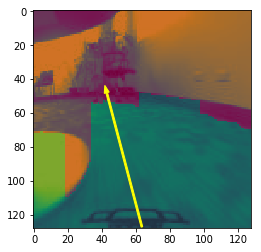

Feedback Trajectory:  (42.787402095345094, 48)


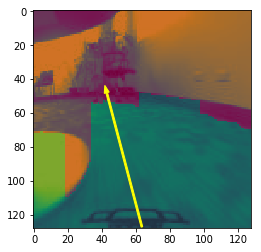

Feedback Trajectory:  (42.787402095345094, 48)


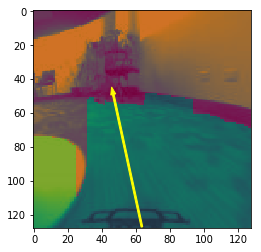

Feedback Trajectory:  (46.630510648519426, 49)


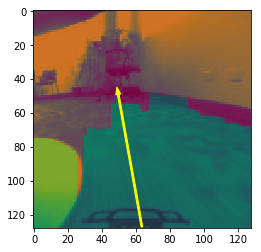

Feedback Trajectory:  (49.56147308241159, 49)


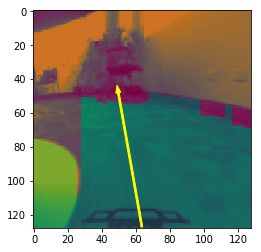

Feedback Trajectory:  (49.60852157307952, 48)


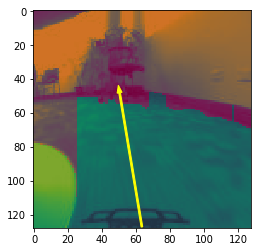

Feedback Trajectory:  (50.36167936144784, 48)


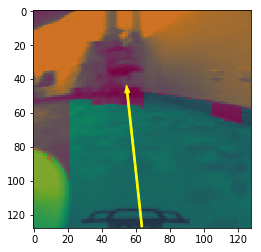

Feedback Trajectory:  (54.88257347636124, 48)


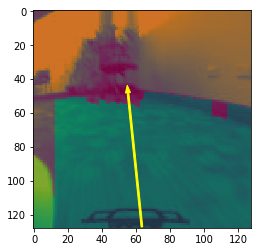

Feedback Trajectory:  (55.29277589883208, 48)


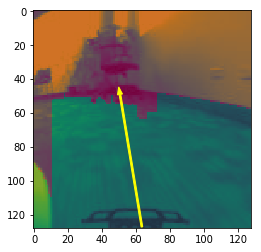

Feedback Trajectory:  (50.590983525577286, 49)


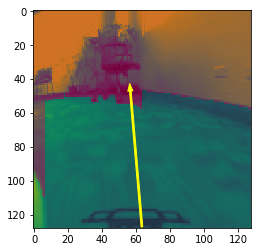

Feedback Trajectory:  (56.67822543967116, 47)


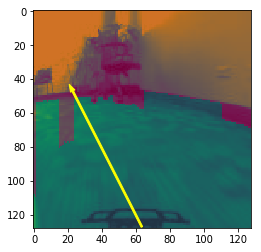

Feedback Trajectory:  (22.742844528752702, 47)


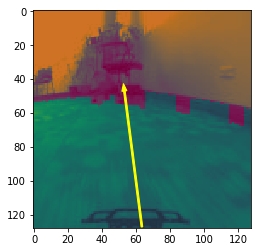

Feedback Trajectory:  (53.179903831499736, 47)


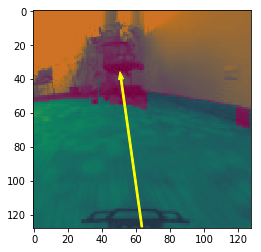

Feedback Trajectory:  (51.2022736003172, 40)


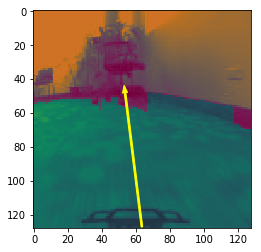

Feedback Trajectory:  (53.58013116011548, 48)


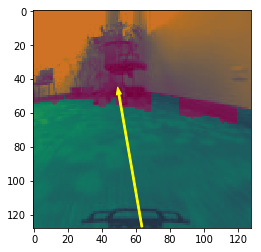

Feedback Trajectory:  (49.950141853360634, 49)


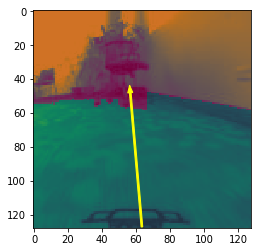

Feedback Trajectory:  (56.64530371131365, 48)


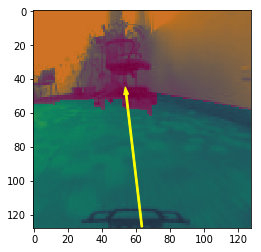

Feedback Trajectory:  (54.23318857726025, 49)


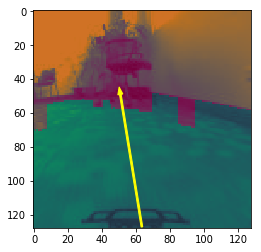

Feedback Trajectory:  (50.8041782037039, 49)


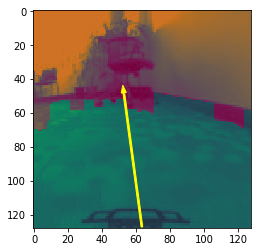

Feedback Trajectory:  (52.830302499681615, 48)


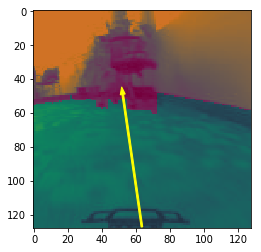

Feedback Trajectory:  (52.22258548436971, 49)


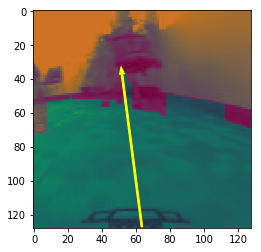

Feedback Trajectory:  (51.77663642525611, 37)


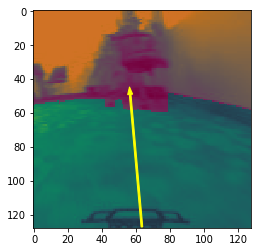

Feedback Trajectory:  (56.57568269078486, 49)


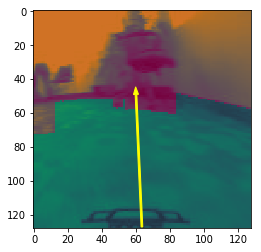

Feedback Trajectory:  (60.00745371964406, 49)


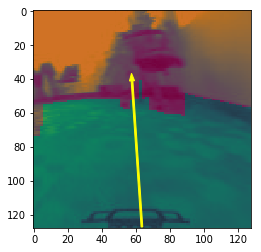

Feedback Trajectory:  (57.6692686606856, 41)


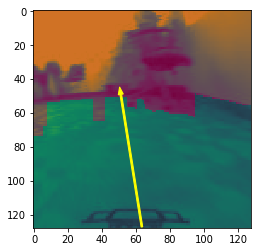

Feedback Trajectory:  (51.05907125333184, 49)


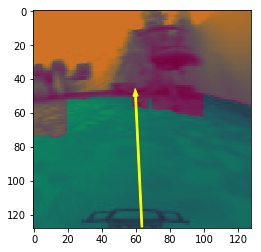

Feedback Trajectory:  (59.75509360843581, 50)


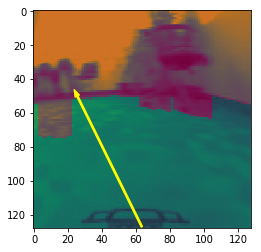

Feedback Trajectory:  (25.487999137829558, 50)


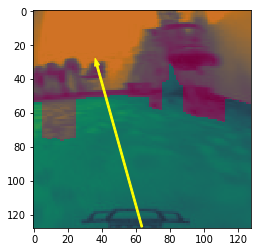

Feedback Trajectory:  (37.10857500970305, 32)


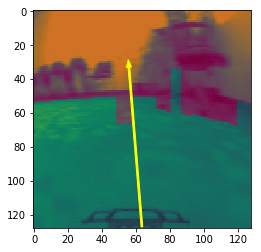

Feedback Trajectory:  (55.846011895099366, 33)


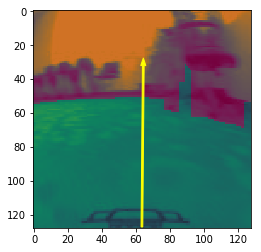

Feedback Trajectory:  (64.29965215210818, 32)


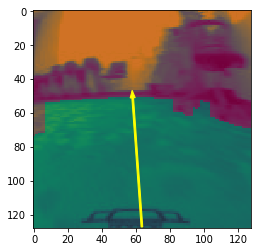

Feedback Trajectory:  (58.06743675322885, 51)


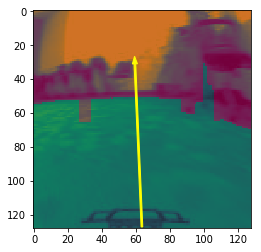

Feedback Trajectory:  (59.37018456945326, 31)


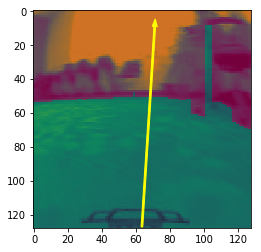

Feedback Trajectory:  (71.04850941514616, 9)


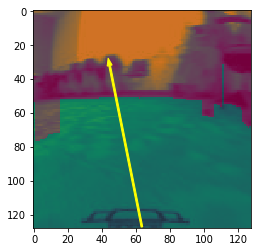

Feedback Trajectory:  (44.49937303189191, 32)


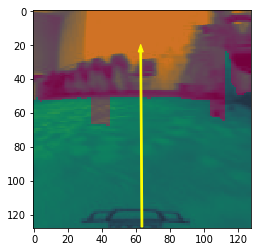

Feedback Trajectory:  (62.79483151411651, 24)


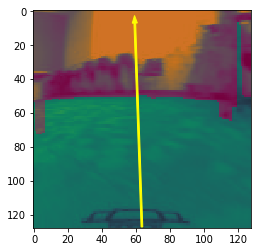

Feedback Trajectory:  (59.31059267896096, 7)


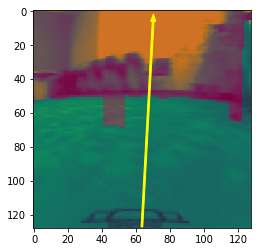

Feedback Trajectory:  (70.08769505183642, 6)


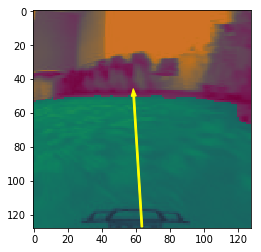

Feedback Trajectory:  (58.676461180612236, 50)


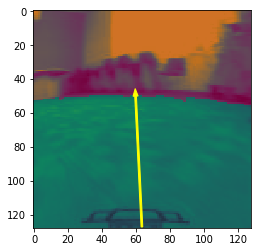

Feedback Trajectory:  (59.76563415223808, 50)


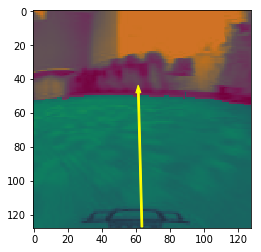

Feedback Trajectory:  (61.41314745782779, 48)


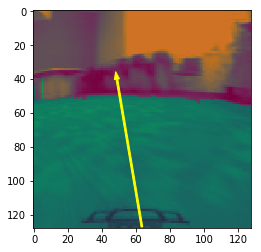

Feedback Trajectory:  (48.781477172939375, 40)


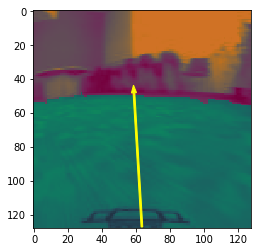

Feedback Trajectory:  (58.813316505367546, 48)


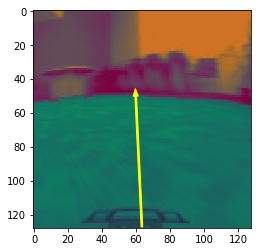

Feedback Trajectory:  (59.85101410857299, 50)


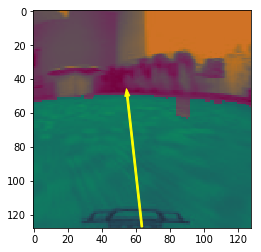

Feedback Trajectory:  (54.890529932528445, 50)


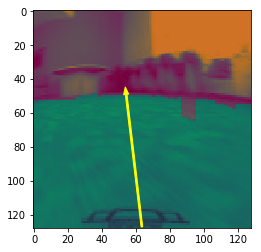

Feedback Trajectory:  (54.22597712643719, 49)


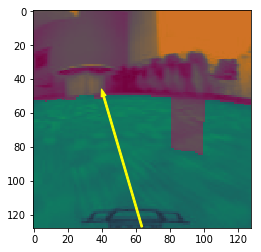

Feedback Trajectory:  (40.947094601588624, 50)


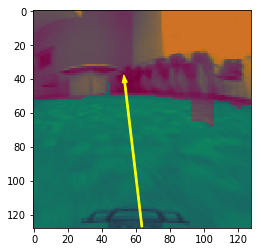

Feedback Trajectory:  (53.38373596201489, 42)


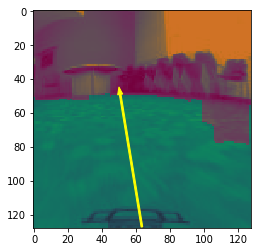

Feedback Trajectory:  (50.703875041507004, 49)


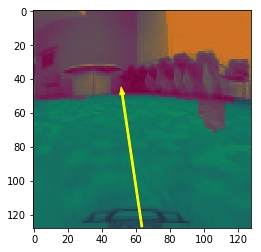

Feedback Trajectory:  (51.91704787810696, 49)


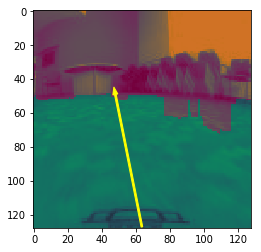

Feedback Trajectory:  (47.85654832063598, 49)


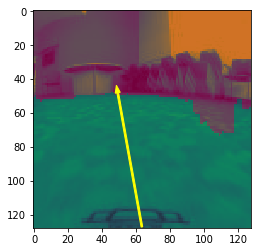

Feedback Trajectory:  (49.26741084144842, 48)


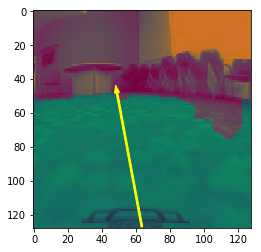

Feedback Trajectory:  (48.81900312510346, 48)


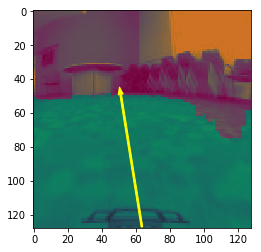

Feedback Trajectory:  (50.99284662401538, 49)


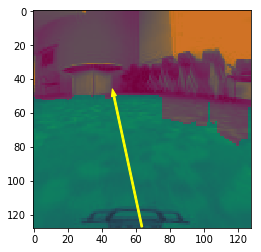

Feedback Trajectory:  (47.005728993894714, 50)


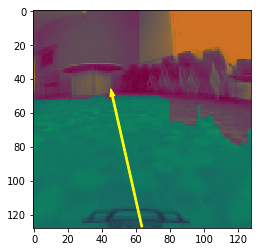

Feedback Trajectory:  (46.12895722996446, 50)


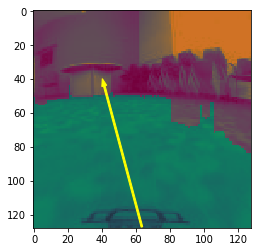

Feedback Trajectory:  (41.328513431866966, 44)


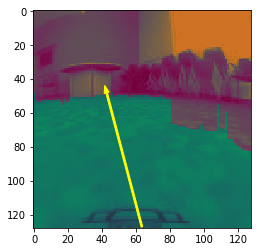

Feedback Trajectory:  (42.729508480788255, 48)


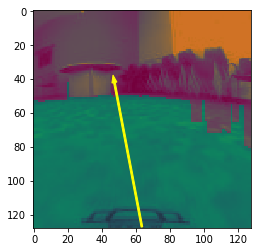

Feedback Trajectory:  (47.31385729701056, 42)


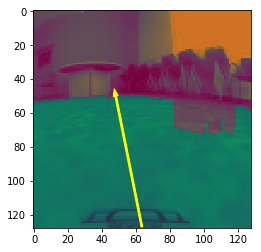

Feedback Trajectory:  (48.08962409613877, 50)


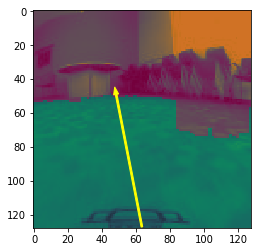

Feedback Trajectory:  (48.32907831483684, 49)


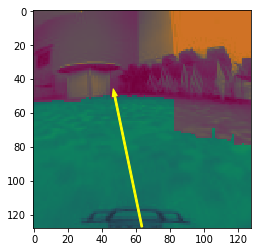

Feedback Trajectory:  (47.510414214559496, 50)


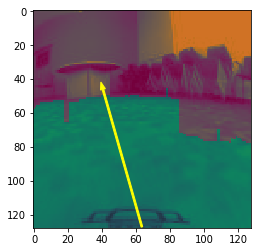

Feedback Trajectory:  (40.54617979403344, 46)


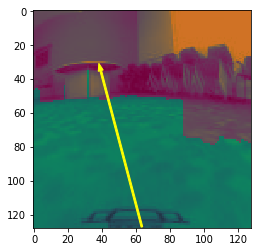

Feedback Trajectory:  (39.26394796295995, 35)


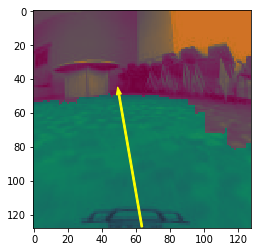

Feedback Trajectory:  (49.9676148653219, 49)


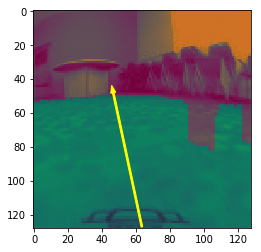

Feedback Trajectory:  (46.61823579153312, 48)


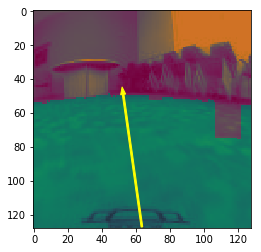

Feedback Trajectory:  (52.454941868424065, 49)


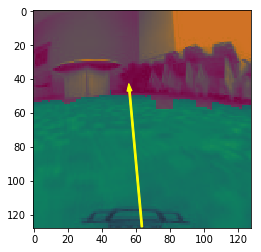

Feedback Trajectory:  (56.17592726130483, 47)


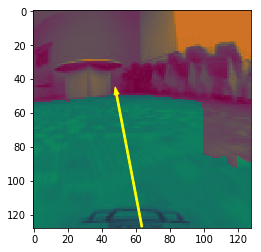

Feedback Trajectory:  (48.55299558527989, 49)


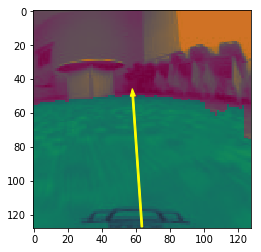

Feedback Trajectory:  (58.14396171558252, 50)


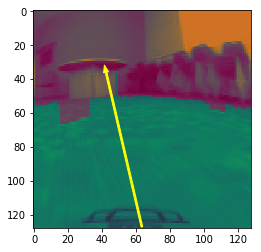

Feedback Trajectory:  (42.40664974883993, 36)


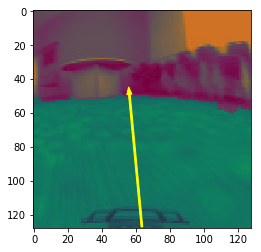

Feedback Trajectory:  (56.100668290255086, 49)


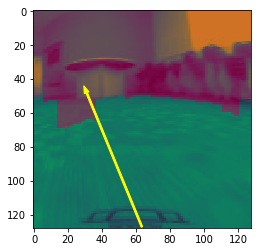

Feedback Trajectory:  (30.973556805308164, 48)


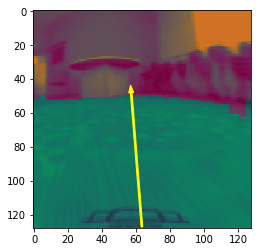

Feedback Trajectory:  (57.19254697117018, 48)


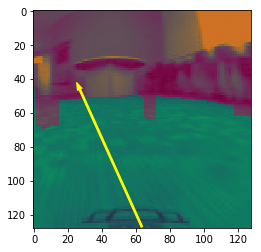

Feedback Trajectory:  (26.904451589145676, 46)


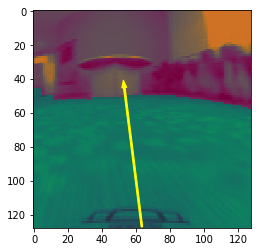

Feedback Trajectory:  (53.11734341400248, 45)


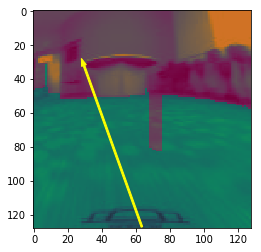

Feedback Trajectory:  (29.382322652979987, 32)


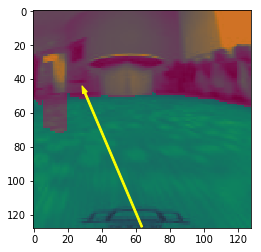

Feedback Trajectory:  (29.955179227190772, 48)


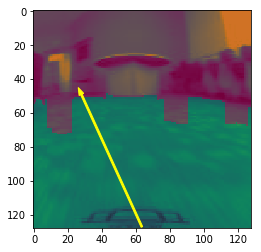

Feedback Trajectory:  (27.877414051876976, 49)


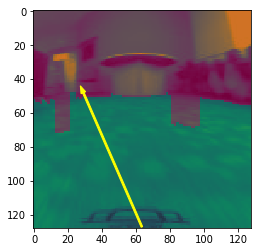

Feedback Trajectory:  (29.031413046916924, 48)


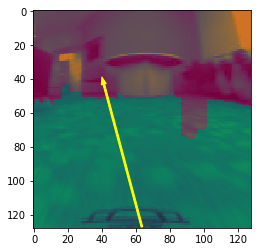

Feedback Trajectory:  (41.081226663056896, 43)


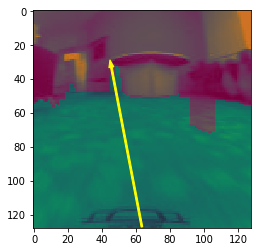

Feedback Trajectory:  (45.51071218043261, 33)


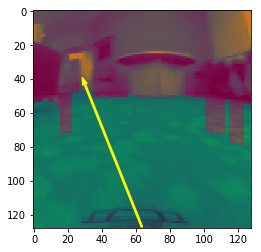

Feedback Trajectory:  (29.925909112968334, 43)


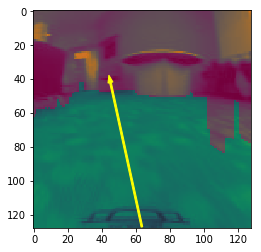

Feedback Trajectory:  (44.993538530451346, 42)


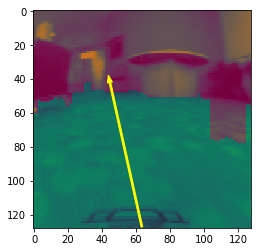

Feedback Trajectory:  (44.67105440301268, 42)


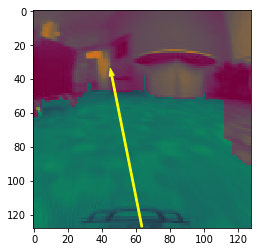

Feedback Trajectory:  (45.737310350421225, 38)


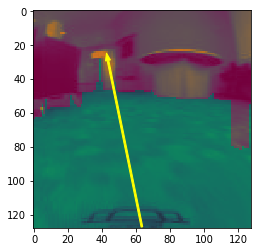

Feedback Trajectory:  (43.52395650799835, 29)


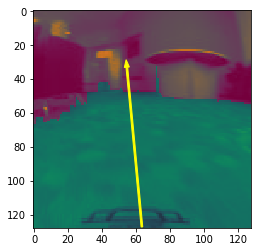

Feedback Trajectory:  (54.62601441686243, 33)


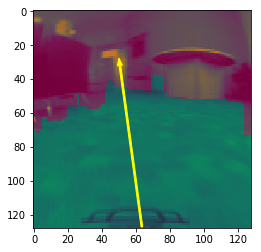

Feedback Trajectory:  (50.54309442463167, 32)


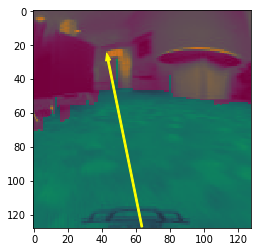

Feedback Trajectory:  (43.61599106914871, 29)


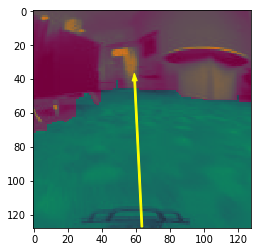

Feedback Trajectory:  (59.24361280731057, 41)


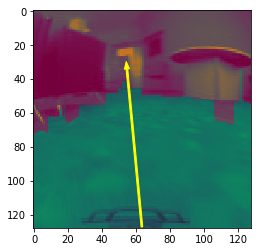

Feedback Trajectory:  (54.67238013886347, 34)


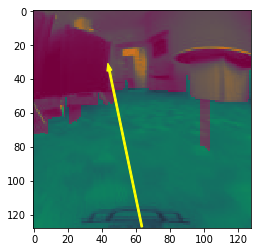

Feedback Trajectory:  (44.344413587951706, 35)


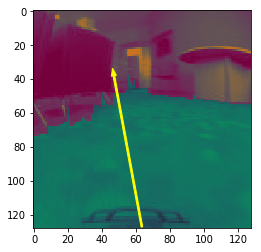

Feedback Trajectory:  (47.00134629919954, 38)


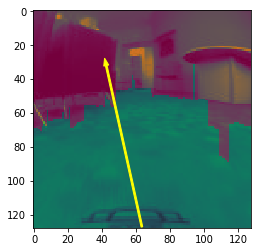

Feedback Trajectory:  (42.49498353011009, 32)


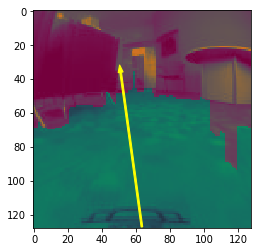

Feedback Trajectory:  (50.98375686086719, 36)


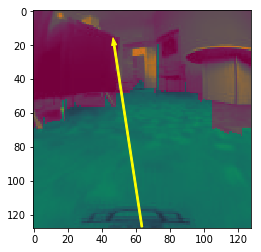

Feedback Trajectory:  (47.14516196884335, 20)


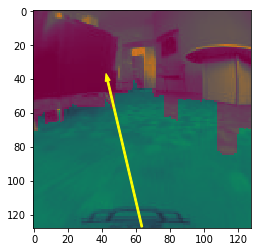

Feedback Trajectory:  (43.358693014801396, 41)


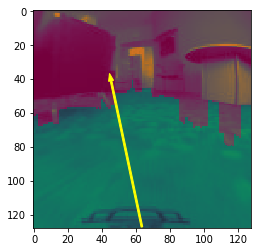

Feedback Trajectory:  (45.331257893344244, 41)


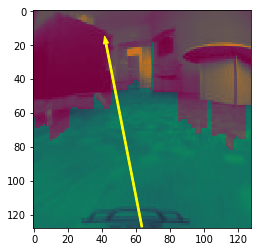

Feedback Trajectory:  (42.36111753388681, 19)


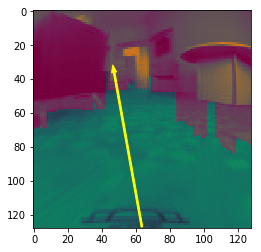

Feedback Trajectory:  (47.13594965299814, 36)


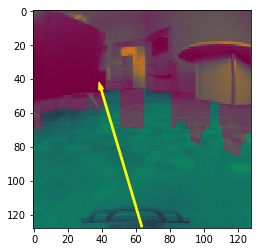

Feedback Trajectory:  (39.47049016782875, 46)


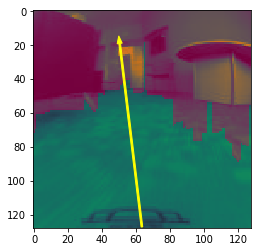

Feedback Trajectory:  (50.41088078049757, 19)


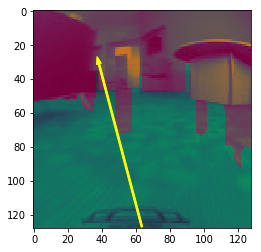

Feedback Trajectory:  (38.20959090287035, 31)


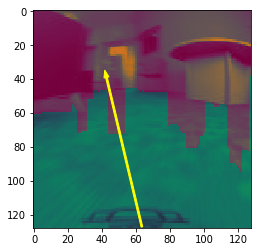

Feedback Trajectory:  (42.64074291808171, 39)


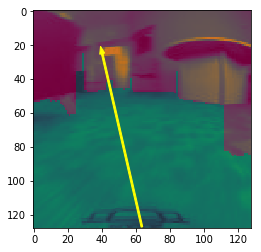

Feedback Trajectory:  (40.12712959915845, 25)


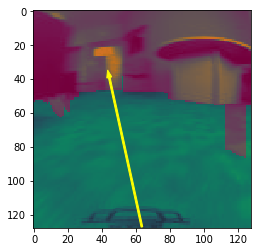

Feedback Trajectory:  (44.28137157586181, 39)


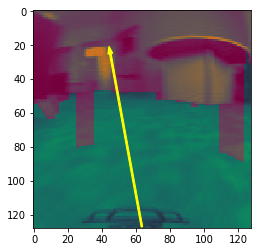

Feedback Trajectory:  (44.900918110335766, 25)


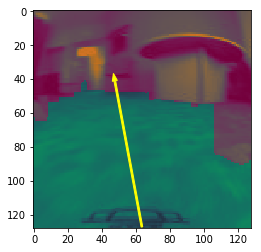

Feedback Trajectory:  (47.54051728493804, 41)


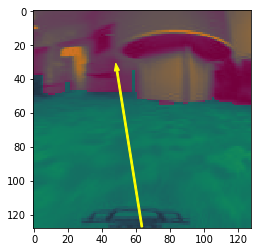

Feedback Trajectory:  (48.80240746837106, 35)


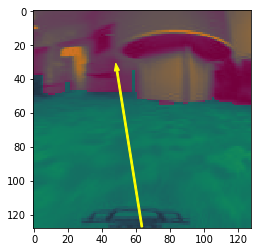

Feedback Trajectory:  (48.80240746837106, 35)


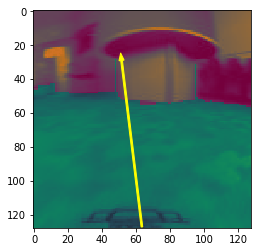

Feedback Trajectory:  (51.51199171054025, 29)


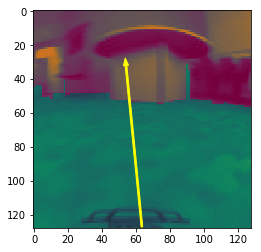

Feedback Trajectory:  (54.1283325949273, 32)


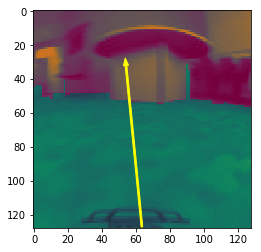

Feedback Trajectory:  (54.1283325949273, 32)


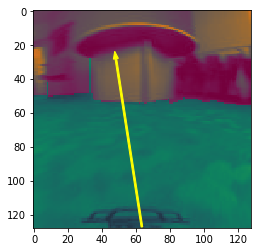

Feedback Trajectory:  (48.17285149394846, 28)


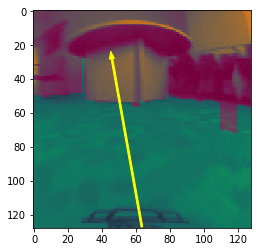

Feedback Trajectory:  (45.86793494633814, 28)


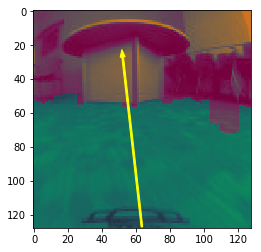

Feedback Trajectory:  (52.178826611496554, 27)


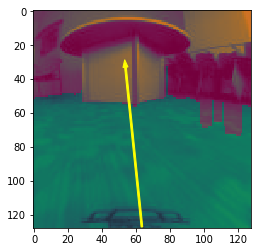

Feedback Trajectory:  (53.81902295559277, 33)


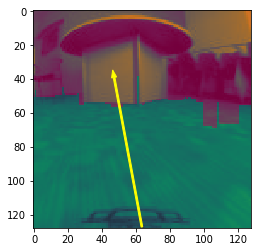

Feedback Trajectory:  (47.11137077492216, 39)


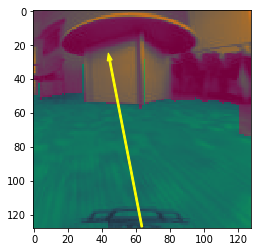

Feedback Trajectory:  (44.541840622053606, 29)


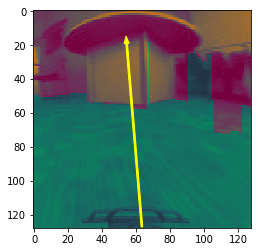

Feedback Trajectory:  (54.529463557981884, 19)


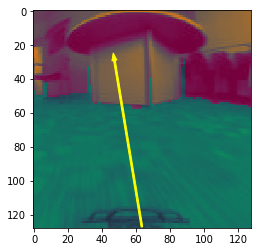

Feedback Trajectory:  (47.32911664038674, 29)


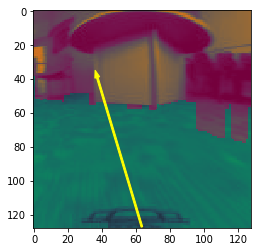

Feedback Trajectory:  (37.22452511048989, 39)


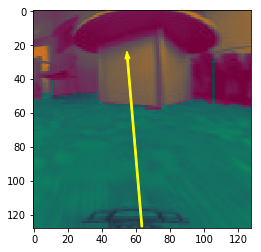

Feedback Trajectory:  (54.98805831299977, 28)


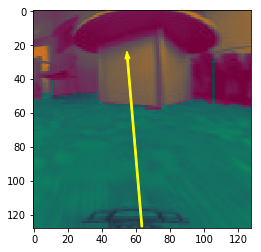

Feedback Trajectory:  (54.98805831299977, 28)


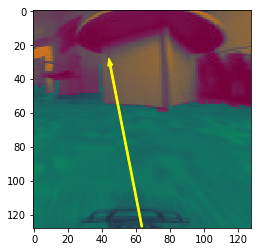

Feedback Trajectory:  (44.86365424981747, 32)


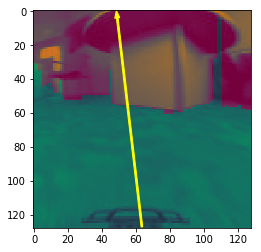

Feedback Trajectory:  (48.98773135585246, 4)


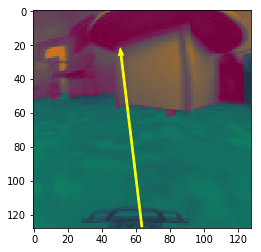

Feedback Trajectory:  (51.23402562947325, 26)


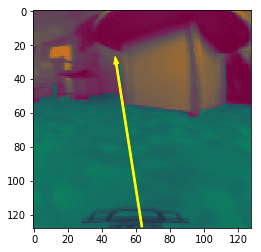

Feedback Trajectory:  (48.3986652238441, 31)


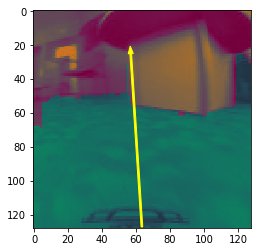

Feedback Trajectory:  (56.91700218240919, 25)


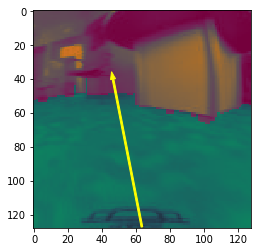

Feedback Trajectory:  (46.48495688154791, 40)


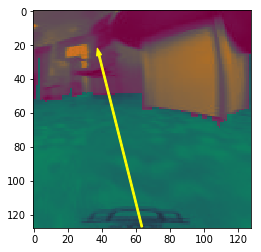

Feedback Trajectory:  (38.28748282040509, 26)


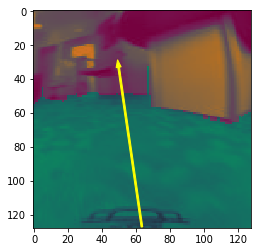

Feedback Trajectory:  (49.80232926185593, 33)


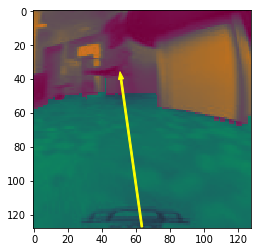

Feedback Trajectory:  (51.20145500742205, 40)


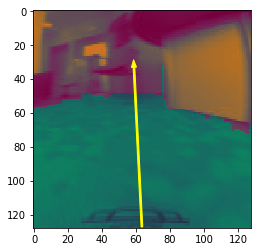

Feedback Trajectory:  (58.80759524054825, 33)


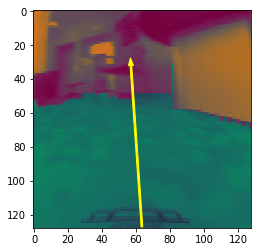

Feedback Trajectory:  (57.0323599196856, 32)


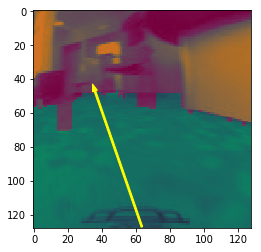

Feedback Trajectory:  (35.84360134678011, 47)


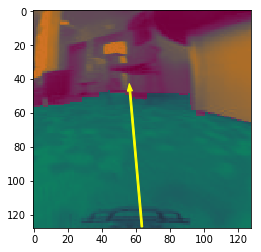

Feedback Trajectory:  (56.431596111457225, 47)


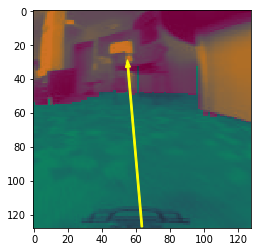

Feedback Trajectory:  (55.29788979200407, 33)


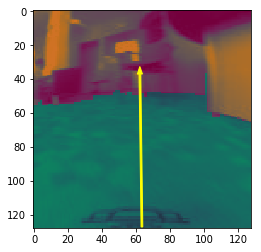

Feedback Trajectory:  (62.3254024715099, 37)


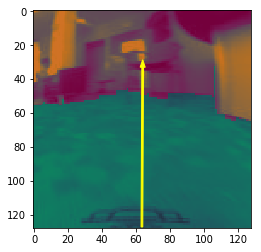

Feedback Trajectory:  (63.94250218711479, 33)


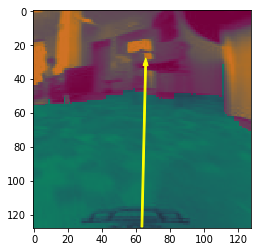

Feedback Trajectory:  (65.65887489465625, 32)


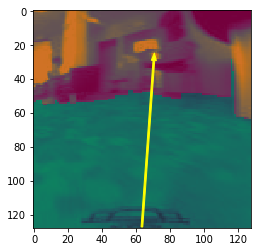

Feedback Trajectory:  (70.5265211396019, 29)


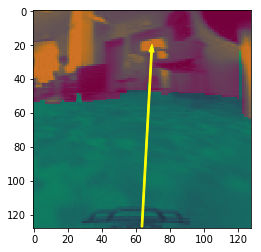

Feedback Trajectory:  (69.18394554048174, 24)


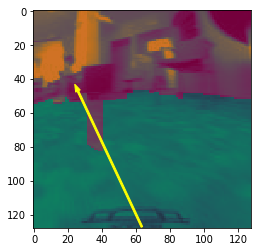

Feedback Trajectory:  (25.84535048439362, 47)


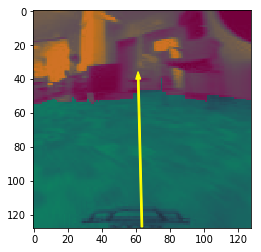

Feedback Trajectory:  (61.326018373501896, 40)


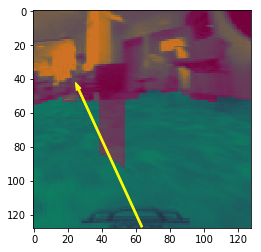

Feedback Trajectory:  (26.245097837918618, 46)


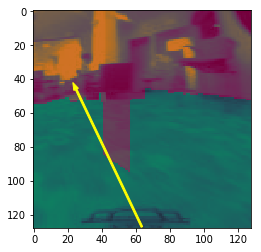

Feedback Trajectory:  (24.758196986535356, 46)


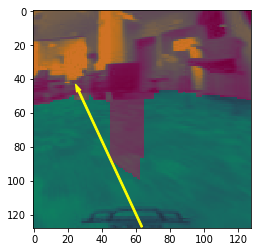

Feedback Trajectory:  (26.290091693052208, 47)


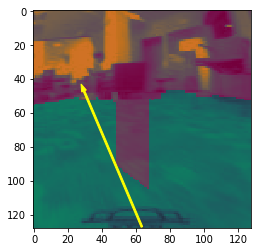

Feedback Trajectory:  (29.426816683199238, 47)


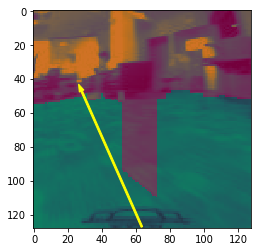

Feedback Trajectory:  (28.00585187018257, 47)


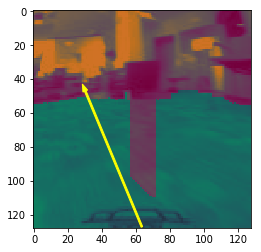

Feedback Trajectory:  (30.154752066598945, 47)


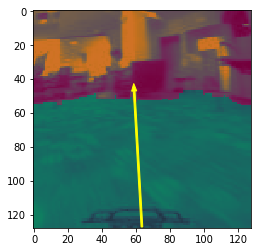

Feedback Trajectory:  (58.93910983333747, 47)


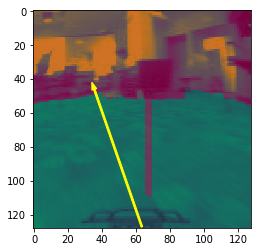

Feedback Trajectory:  (35.4695238920071, 46)


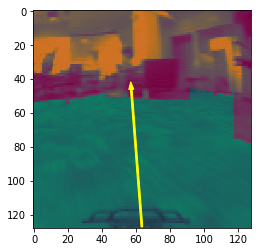

Feedback Trajectory:  (57.24356159325188, 46)


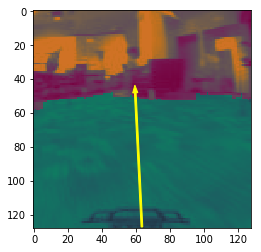

Feedback Trajectory:  (59.57898043286059, 48)


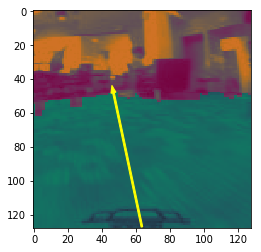

Feedback Trajectory:  (46.752126830023336, 48)


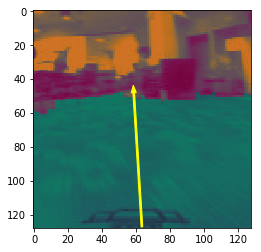

Feedback Trajectory:  (58.68714303910861, 48)


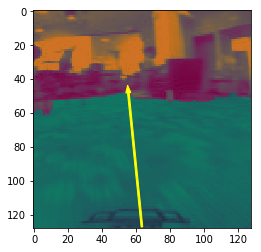

Feedback Trajectory:  (55.51102531908536, 48)


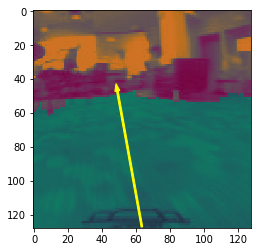

Feedback Trajectory:  (49.04659380489302, 47)


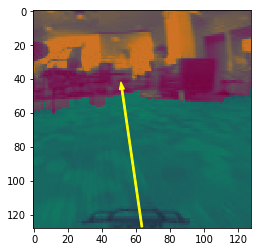

Feedback Trajectory:  (51.740259248421914, 46)


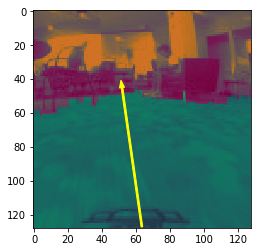

Feedback Trajectory:  (51.78002677606591, 45)


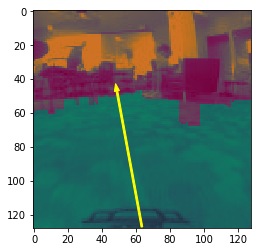

Feedback Trajectory:  (48.779890500641976, 47)


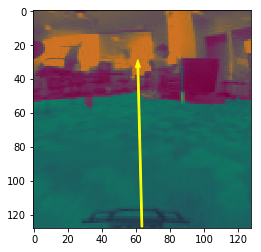

Feedback Trajectory:  (61.14207698783234, 33)


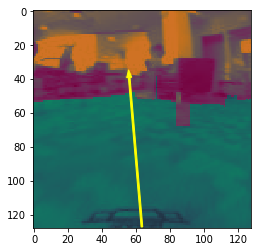

Feedback Trajectory:  (56.01299516040926, 39)


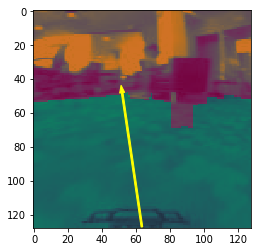

Feedback Trajectory:  (51.87096723795704, 48)


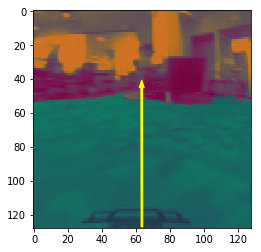

Feedback Trajectory:  (63.38603559435115, 45)


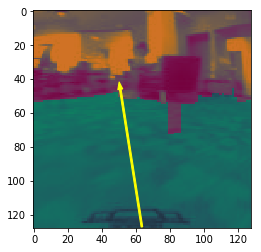

Feedback Trajectory:  (50.7765515376533, 46)


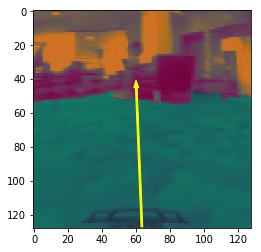

Feedback Trajectory:  (60.18048046552133, 45)


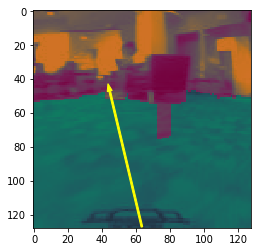

Feedback Trajectory:  (44.53503315601901, 47)


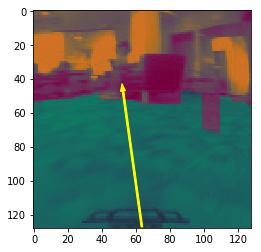

Feedback Trajectory:  (52.353177580575874, 47)


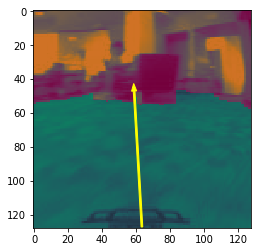

Feedback Trajectory:  (58.911546019793775, 47)


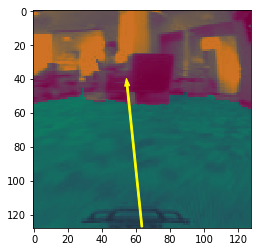

Feedback Trajectory:  (54.828372467982156, 44)


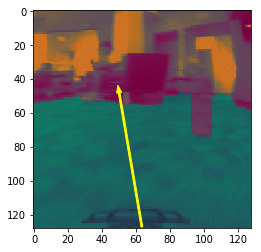

Feedback Trajectory:  (50.08501472379258, 48)


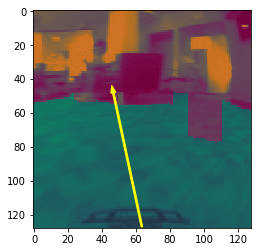

Feedback Trajectory:  (46.66959195077374, 48)


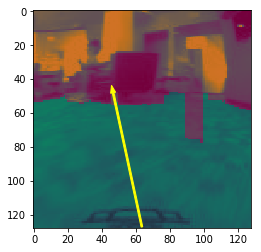

Feedback Trajectory:  (46.54138775035276, 48)


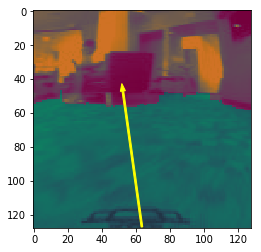

Feedback Trajectory:  (52.28680855368529, 47)


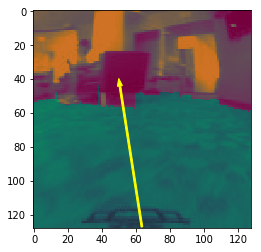

Feedback Trajectory:  (50.53550215180139, 44)


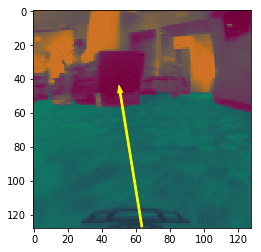

Feedback Trajectory:  (50.69430984900374, 48)


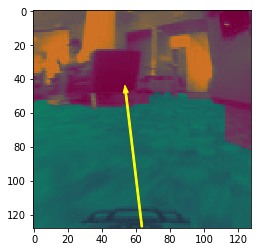

Feedback Trajectory:  (54.00676523067813, 48)


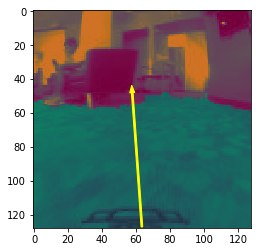

Feedback Trajectory:  (57.80191637069399, 48)


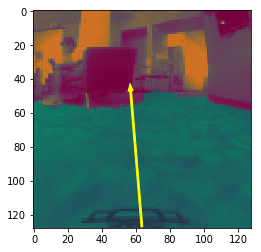

Feedback Trajectory:  (56.85986347472699, 47)


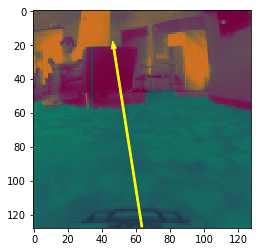

Feedback Trajectory:  (46.97963112171544, 22)


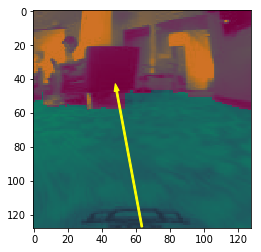

Feedback Trajectory:  (48.63097519497726, 47)


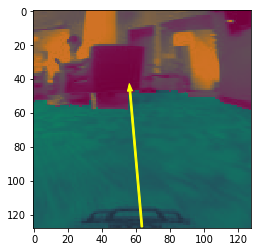

Feedback Trajectory:  (56.461176285426326, 47)


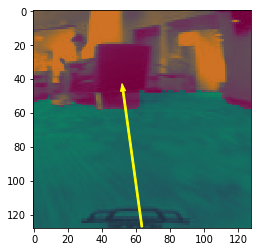

Feedback Trajectory:  (52.38566662630715, 47)


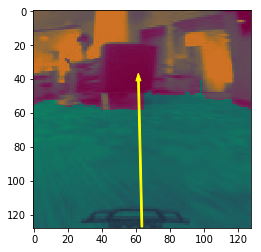

Feedback Trajectory:  (61.467477958220286, 41)


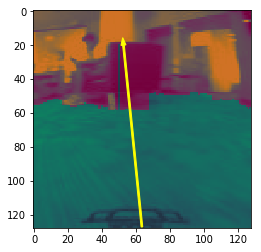

Feedback Trajectory:  (52.64467619240187, 20)


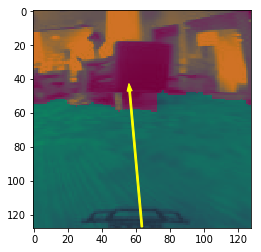

Feedback Trajectory:  (56.250848647865205, 47)


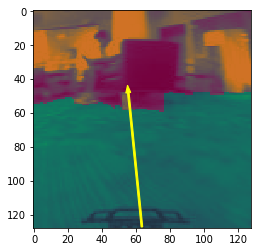

Feedback Trajectory:  (55.48266364821463, 48)


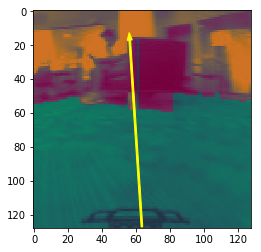

Feedback Trajectory:  (56.3211768617574, 17)


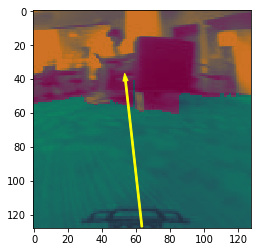

Feedback Trajectory:  (53.83469003517278, 41)


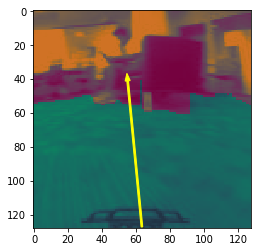

Feedback Trajectory:  (55.10207628448878, 41)


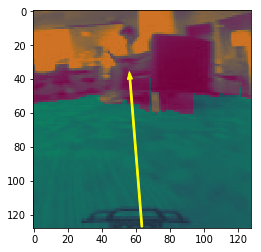

Feedback Trajectory:  (56.451340297701485, 40)


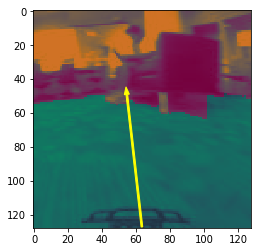

Feedback Trajectory:  (54.6154228814527, 49)


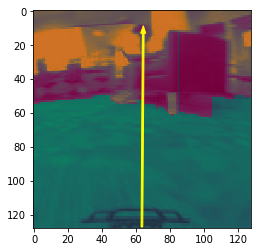

Feedback Trajectory:  (64.27662474061918, 13)


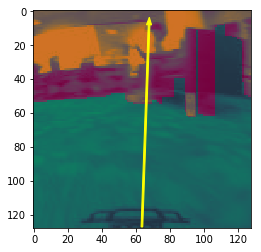

Feedback Trajectory:  (67.69046449961283, 8)


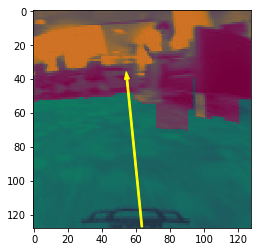

Feedback Trajectory:  (54.703409349845515, 40)


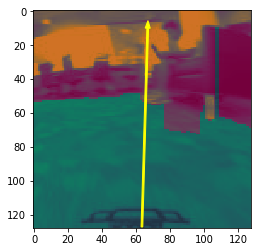

Feedback Trajectory:  (66.91602376038128, 10)


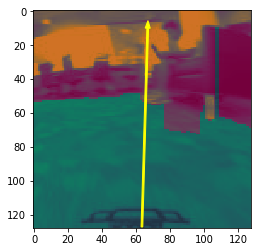

Feedback Trajectory:  (66.91602376038128, 10)


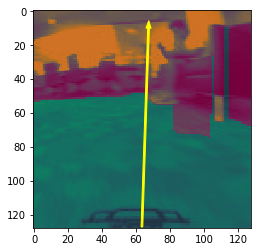

Feedback Trajectory:  (67.39384329942305, 10)


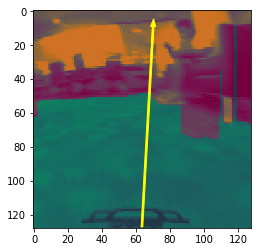

Feedback Trajectory:  (70.12019823458778, 9)


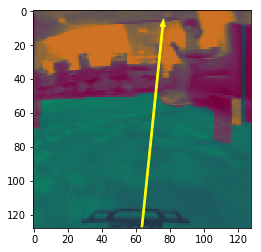

Feedback Trajectory:  (75.7281097648226, 9)


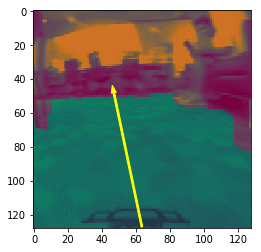

Feedback Trajectory:  (46.979707157920785, 48)


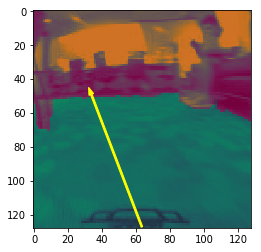

Feedback Trajectory:  (33.712314632934536, 49)


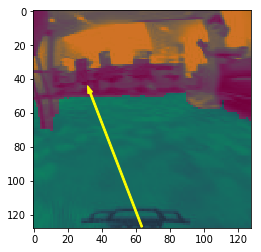

Feedback Trajectory:  (33.065921276181186, 48)


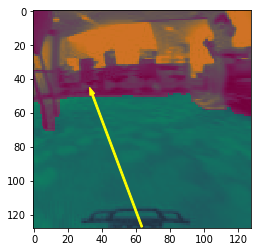

Feedback Trajectory:  (34.28914343111931, 49)


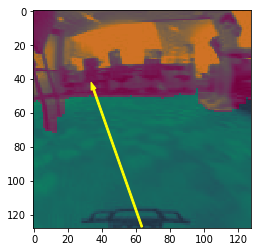

Feedback Trajectory:  (35.031930607940616, 46)


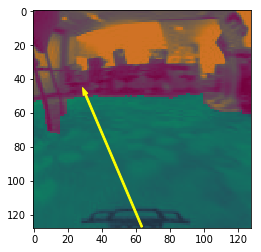

Feedback Trajectory:  (30.276533228526837, 49)


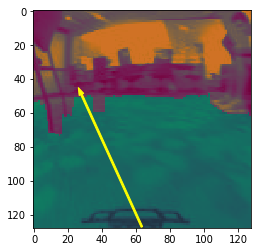

Feedback Trajectory:  (27.90261033929058, 49)


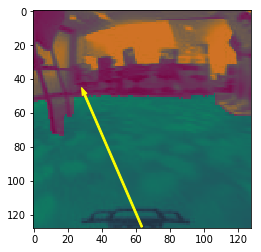

Feedback Trajectory:  (29.747046755478838, 49)


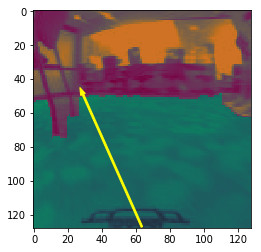

Feedback Trajectory:  (28.793257754589295, 49)


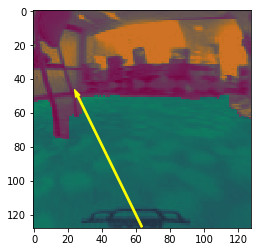

Feedback Trajectory:  (25.739355316573445, 50)


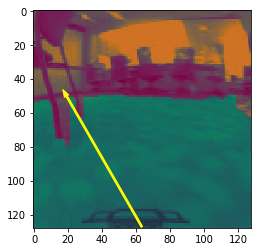

Feedback Trajectory:  (19.160636987270323, 50)


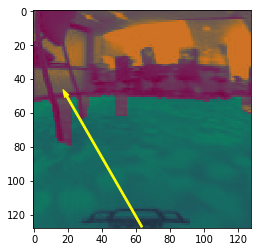

Feedback Trajectory:  (19.21997729047977, 50)


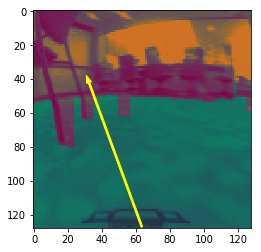

Feedback Trajectory:  (32.3375886535777, 42)


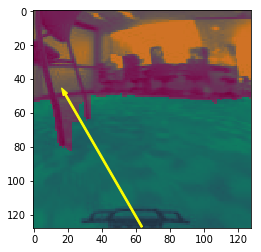

Feedback Trajectory:  (18.434771368425555, 49)


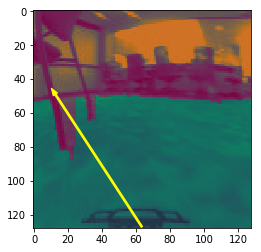

Feedback Trajectory:  (12.577857516483249, 49)


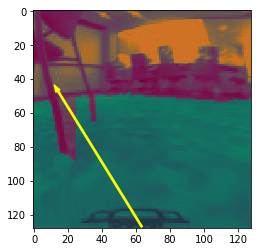

Feedback Trajectory:  (14.084985991118755, 47)


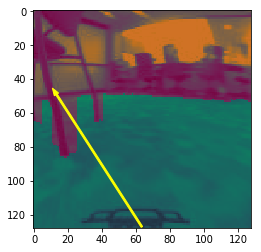

Feedback Trajectory:  (13.198213058983146, 49)


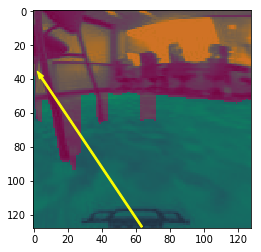

Feedback Trajectory:  (4.357229577921338, 39)


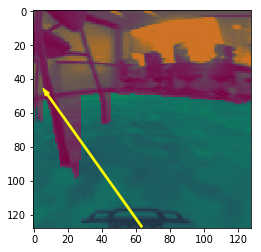

Feedback Trajectory:  (7.854704821804457, 49)


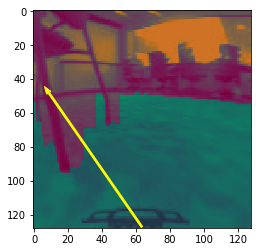

Feedback Trajectory:  (8.670296078551491, 48)


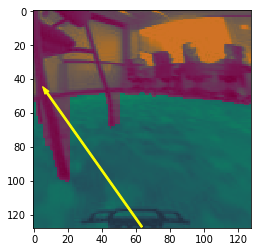

Feedback Trajectory:  (7.603087979213057, 48)


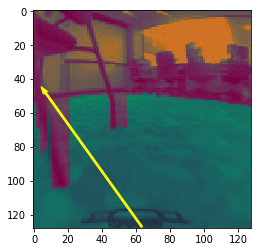

Feedback Trajectory:  (6.719318597504855, 48)


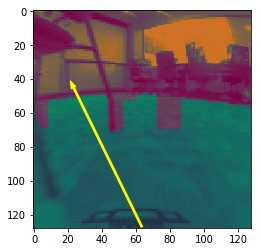

Feedback Trajectory:  (23.283311043268483, 45)


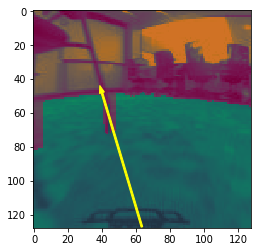

Feedback Trajectory:  (39.96584846611012, 48)


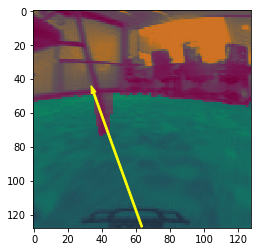

Feedback Trajectory:  (35.07530129134083, 48)


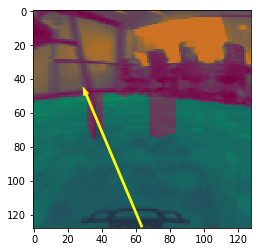

Feedback Trajectory:  (30.66293920570681, 49)


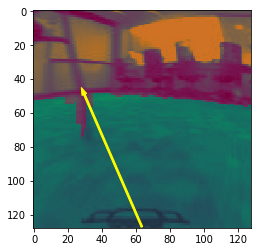

Feedback Trajectory:  (29.599931035665055, 49)


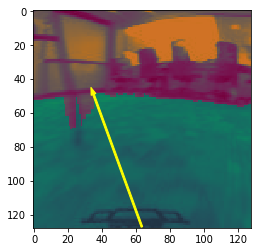

Feedback Trajectory:  (35.00462761813325, 49)


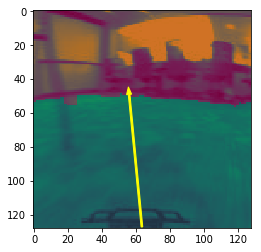

Feedback Trajectory:  (55.9627671037113, 49)


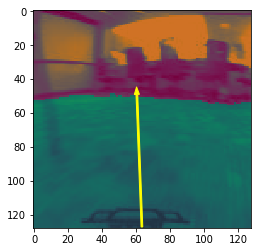

Feedback Trajectory:  (60.528201230161514, 49)


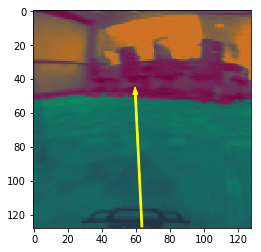

Feedback Trajectory:  (59.64629820760702, 49)


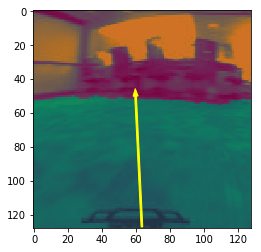

Feedback Trajectory:  (59.77413697362098, 50)


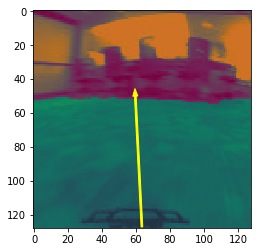

Feedback Trajectory:  (59.61511358683359, 50)


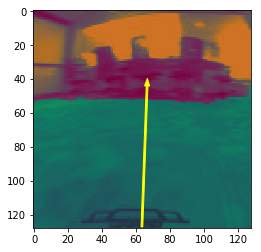

Feedback Trajectory:  (66.54735982190837, 44)


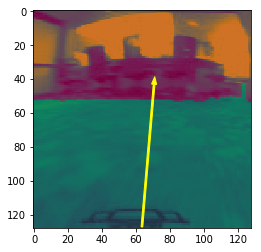

Feedback Trajectory:  (70.66868346179398, 43)


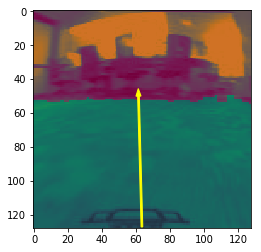

Feedback Trajectory:  (61.48240588286087, 50)


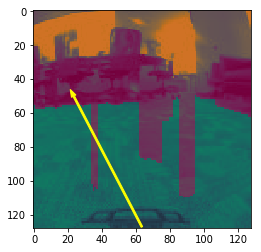

Feedback Trajectory:  (23.34583630976435, 50)


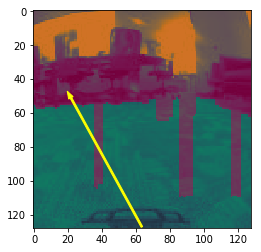

Feedback Trajectory:  (21.694538215389375, 51)


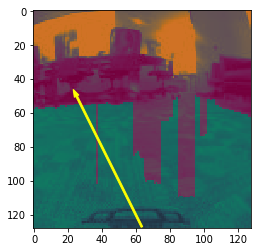

Feedback Trajectory:  (25.045821845781457, 50)


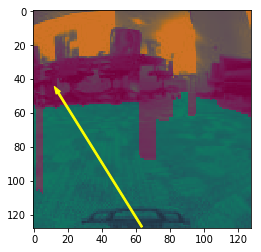

Feedback Trajectory:  (14.247197067037916, 48)


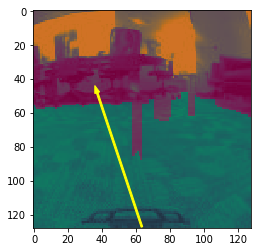

Feedback Trajectory:  (37.177218002591154, 48)


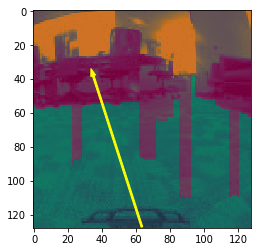

Feedback Trajectory:  (34.843741348186406, 38)


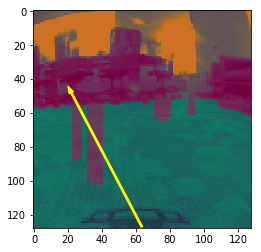

Feedback Trajectory:  (21.93914177365917, 48)


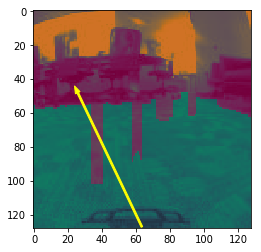

Feedback Trajectory:  (25.728682059367546, 48)


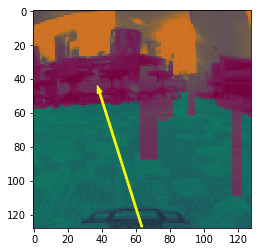

Feedback Trajectory:  (38.59196806090771, 48)


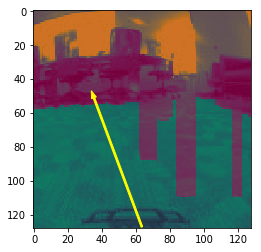

Feedback Trajectory:  (35.25175144533602, 51)


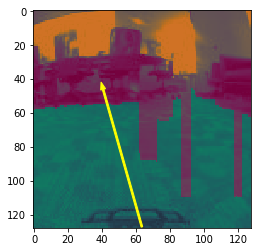

Feedback Trajectory:  (40.65835044357009, 46)


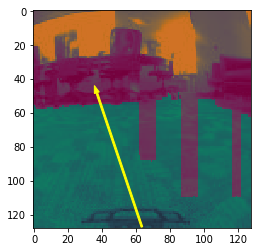

Feedback Trajectory:  (36.93514424737745, 48)


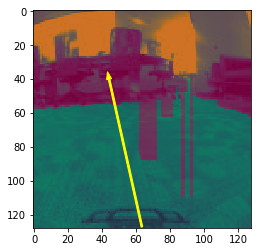

Feedback Trajectory:  (44.18271883430001, 40)


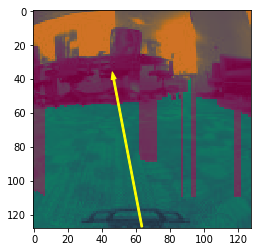

Feedback Trajectory:  (46.869604506654504, 40)


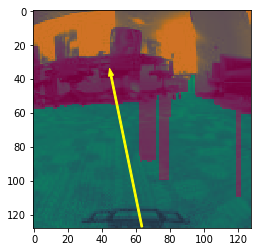

Feedback Trajectory:  (45.32626123308484, 38)


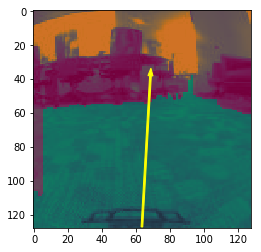

Feedback Trajectory:  (68.53406072801354, 38)


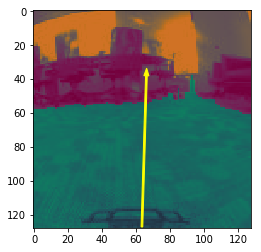

Feedback Trajectory:  (66.14105508643742, 38)


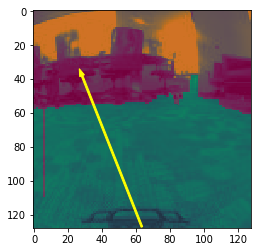

Feedback Trajectory:  (28.264269256658665, 38)


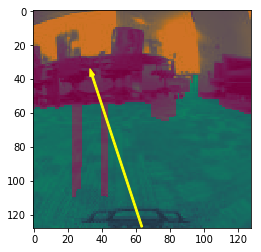

Feedback Trajectory:  (34.249466278465775, 38)


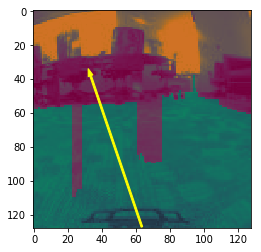

Feedback Trajectory:  (33.293739234395254, 38)


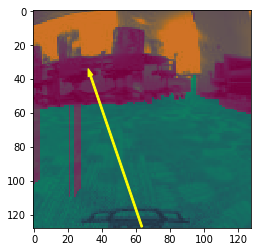

Feedback Trajectory:  (33.248119346548684, 38)


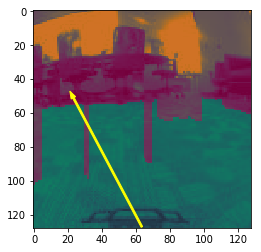

Feedback Trajectory:  (23.160460398464366, 51)


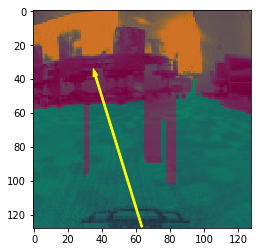

Feedback Trajectory:  (36.14710651295936, 38)


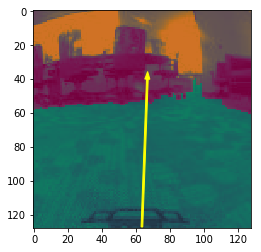

Feedback Trajectory:  (66.69626400206265, 40)


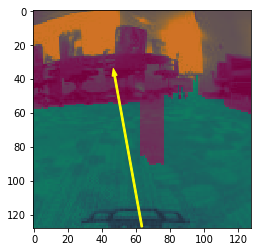

Feedback Trajectory:  (47.43181220477514, 38)


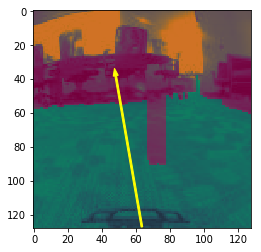

Feedback Trajectory:  (48.0875345092961, 38)


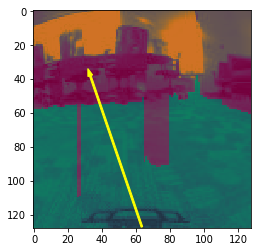

Feedback Trajectory:  (33.11254279362692, 38)


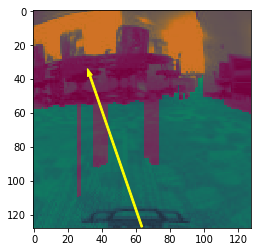

Feedback Trajectory:  (32.88185395101432, 38)


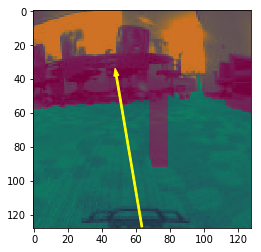

Feedback Trajectory:  (48.43889795083908, 38)


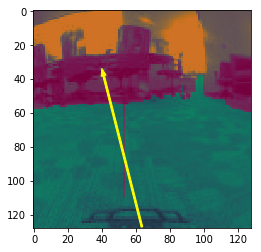

Feedback Trajectory:  (40.97407649939601, 38)


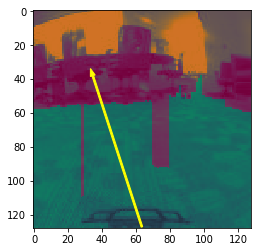

Feedback Trajectory:  (34.576426907025365, 38)


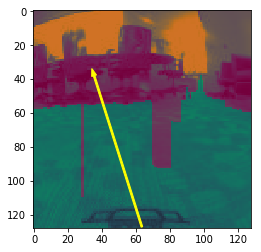

Feedback Trajectory:  (35.35014662017307, 38)


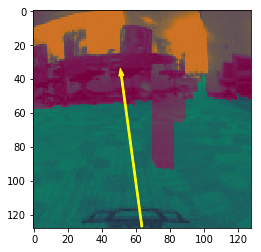

Feedback Trajectory:  (51.390978358018145, 38)


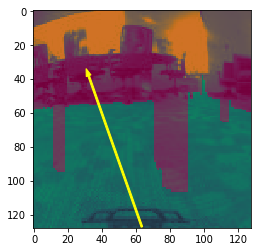

Feedback Trajectory:  (32.13621164887017, 38)


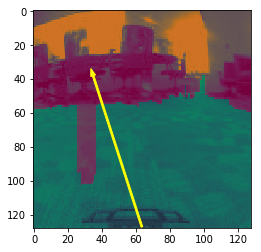

Feedback Trajectory:  (34.79560530437592, 38)


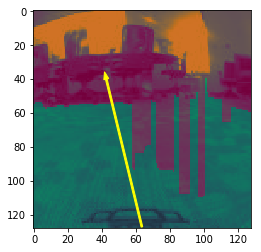

Feedback Trajectory:  (42.52781703403067, 40)


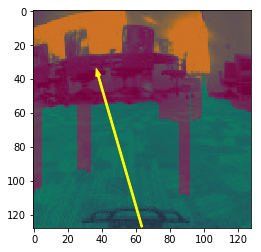

Feedback Trajectory:  (37.80964568730072, 38)


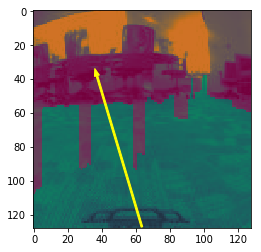

Feedback Trajectory:  (37.01482460932513, 38)


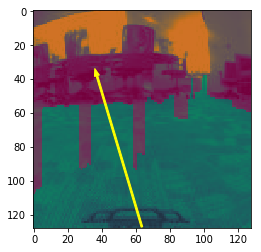

Feedback Trajectory:  (37.01482460932513, 38)


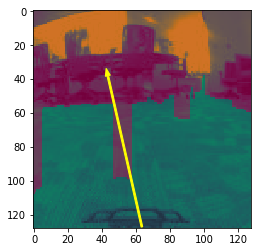

Feedback Trajectory:  (43.433478526388605, 38)


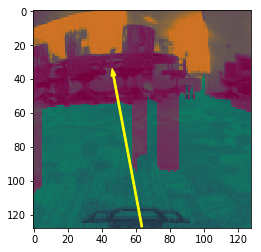

Feedback Trajectory:  (46.7649858850687, 38)


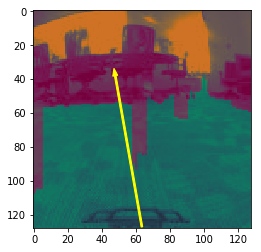

Feedback Trajectory:  (47.80672624311605, 38)


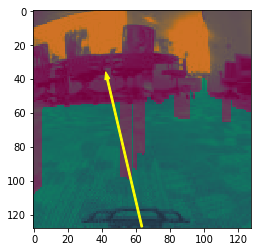

Feedback Trajectory:  (43.15208282978942, 40)


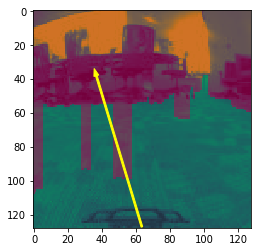

Feedback Trajectory:  (36.6749750417142, 38)


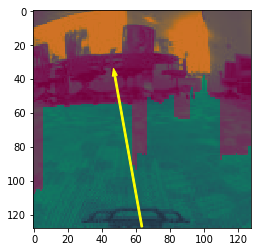

Feedback Trajectory:  (47.53559224382278, 38)


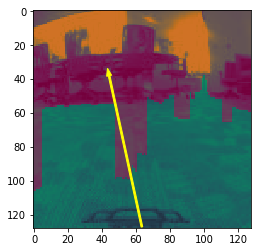

Feedback Trajectory:  (44.19867270584463, 38)


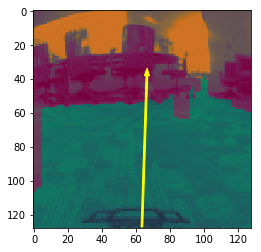

Feedback Trajectory:  (66.43673924427137, 38)


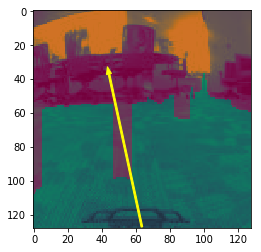

Feedback Trajectory:  (44.116062822914486, 37)


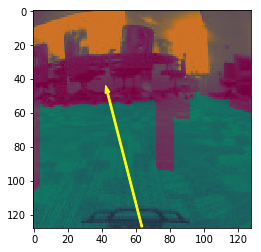

Feedback Trajectory:  (43.24302003386233, 48)


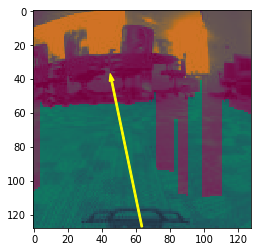

Feedback Trajectory:  (45.684414441577616, 41)


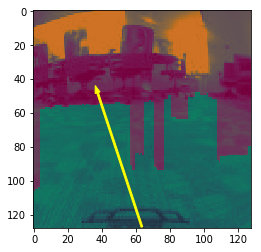

Feedback Trajectory:  (37.41674563778951, 48)


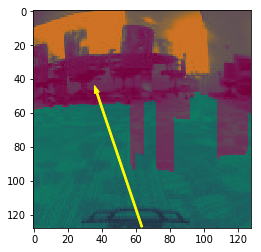

Feedback Trajectory:  (36.97535851334887, 48)


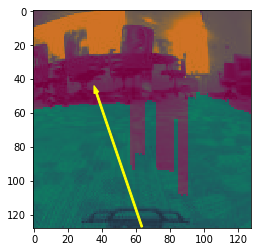

Feedback Trajectory:  (36.69243957335367, 48)


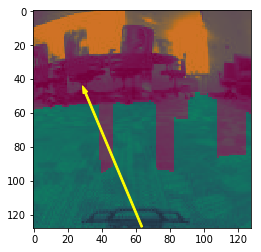

Feedback Trajectory:  (30.227769696830784, 48)


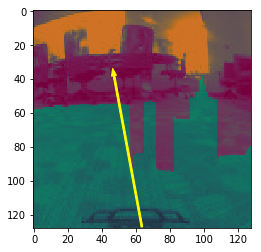

Feedback Trajectory:  (47.07430022831543, 38)


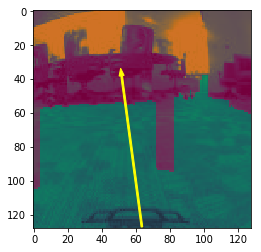

Feedback Trajectory:  (51.558921413161755, 38)


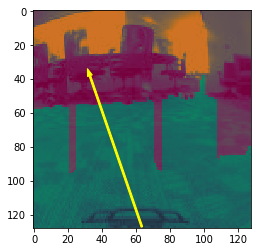

Feedback Trajectory:  (32.869793144596215, 38)


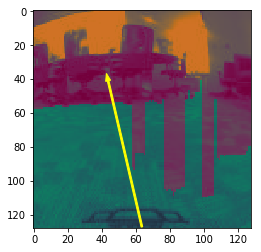

Feedback Trajectory:  (43.60713550601542, 41)


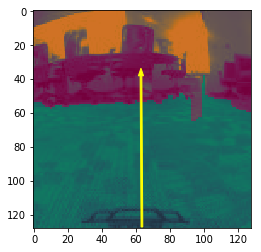

Feedback Trajectory:  (62.9477153168887, 38)


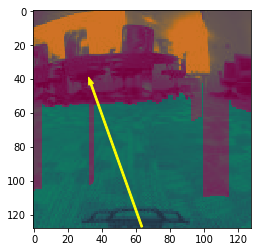

Feedback Trajectory:  (33.57719442381031, 43)


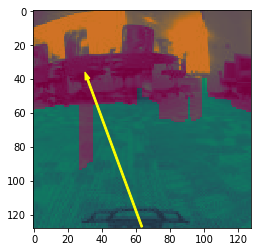

Feedback Trajectory:  (31.4718961105201, 40)


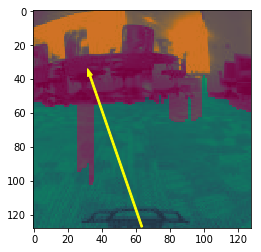

Feedback Trajectory:  (32.9235329054095, 38)


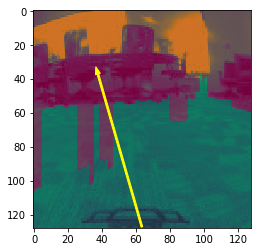

Feedback Trajectory:  (37.59022944161159, 37)


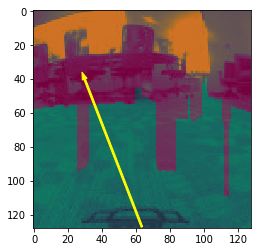

Feedback Trajectory:  (29.808312624762284, 40)


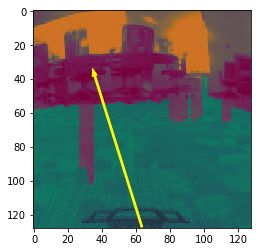

Feedback Trajectory:  (35.72267520891538, 38)


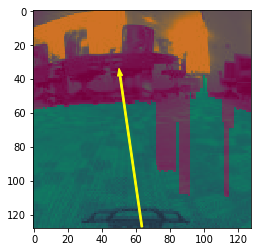

Feedback Trajectory:  (50.625262770656676, 38)


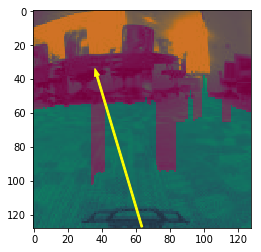

Feedback Trajectory:  (37.055317214307856, 38)


In [184]:
for i in np.arange(len(mask_list)):
    mask = mask_list[i]
    img = img_list[i]
    feedback_trajectory, feedback_center = get_trajectory(mask, 1.05)
    x, y, dx, dy = get_arrow_info(feedback_trajectory, feedback_center)
    fig = plt.figure()
    plt.arrow(x, y, dx, dy, width = 1, color = "yellow")
    plt.imshow(mask, cmap = "RdYlGn",  interpolation='none')
    plt.imshow(img, alpha = 0.5)
    plt.show()
    fig.savefig("frame_" + str(i) + ".png")

    print("Feedback Trajectory: ", feedback_trajectory)

# Everything beyond here was extra stuff I tried

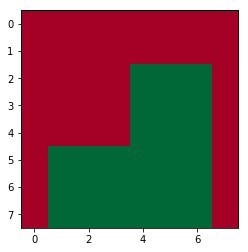

In [26]:
IMAGE_DIM = 8
c = np.zeros((8, 8))
for i in np.arange(2, 8):
    c[i][4] = 1
    c[i][5] = 1
    c[i][5] = 1
    c[i][6] = 1

c[5][1] = 1
c[6][1] = 1
c[7][1] = 1
c[5][2] = 1
c[6][2] = 1
c[7][2] = 1
c[5][3] = 1
c[6][3] = 1
c[7][3] = 1
      
plt.imshow(c, cmap = "RdYlGn",  interpolation='none')

In [18]:
trajectory, center = get_trajectory(c, 1.25)
print(trajectory)

(4.709441583104, 2)


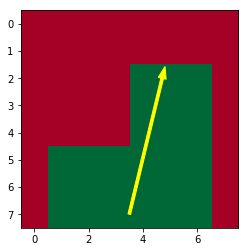

In [19]:
x, y, dx, dy = get_arrow_info(trajectory, center)
plt.figure()
prev = plt.arrow(x, y, dx, dy, width = 0.1, color = "yellow")
plt.imshow(c, cmap = "RdYlGn",  interpolation='none')
plt.show()

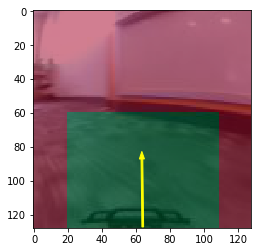

In [20]:
b = np.zeros((128, 128))
left_wall = 20
right_wall = 20
sky = 60
for i in np.arange(128):
    for j in np.arange(128):
        if j < left_wall or j > len(b[0]) - right_wall or i < sky:
            b[i][j] = 0
        else:
            b[i][j] = 1
            
# find trajectory given "good" box (TEMPORARY)
trajectory = (left_wall + (len(b[0]) - right_wall)) / 2

# find trajectory given "good" box method 2
left = 0
for i in np.arange(128):
    if not b[127][i]:
        left = i
        break
        
right = 0
for i in np.arange(127, -1, -1):
    if not b[127][i]:
        right = i
        break

trajectory = (right + left) / 2
center = len(b[0]) / 2
dx = trajectory - center

plt.figure()
prev = plt.arrow(center, len(b) - 1, dx, -40, width = 1, color = "yellow")
plt.imshow(b, cmap = "RdYlGn",  interpolation='none')
plt.imshow(img1, alpha = 0.5)
plt.show()

In [21]:
def convert_to_concentration_mat(img):
    mat = np.zeros((len(img), len(img[0])))
    left_bottom_boundary = 0
    right_bottom_boundary = 0
    
    # start from left
    for i in np.arange(len(mat)):
        for j in np.arange(len(mat[i])):
            if img[i][j] == 1:
                mat[i][j] = 1
                if i == len(mat) - 1:
                    left_bottom_boundary = j
                break
                
    # start from right
    for i in np.arange(len(mat) - 1, -1, -1):
        for j in np.arange(len(mat[i]) - 1, -1, -1):
            if img[i][j] == 1:
                mat[i][j] = 1
                if i == len(mat) - 1:
                    right_bottom_boundary = j
                break
                
    # start from top
    for i in np.arange(len(mat)):
        for j in np.arange(len(mat[i])):
            if img[j][i] == 1:
                mat[j][i] = 1
                break
                
    # start from bottom
    for j in np.arange(left_bottom_boundary, right_bottom_boundary + 1):
        mat[len(mat) - 1][j] = 1
                
    return mat

In [22]:
x = convert_to_concentration_mat(c)
print(x)

[[0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 1. 1. 0.]
 [0. 0. 0. 0. 1. 0. 1. 0.]
 [0. 0. 0. 0. 1. 0. 1. 0.]
 [0. 1. 1. 1. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 1. 0.]
 [0. 1. 1. 1. 1. 1. 1. 0.]]


## Below is DonkeyCar's implementation of a PID controller. Instead of tracking how the error has changed, it tracks how the feedback has changed, so its derivative term is inaccurate.

In [23]:
# -*- coding: utf-8 -*-

import time

class DonkeyPIDController:
    """ Performs a PID computation and returns a control value.
        This is based on the elapsed time (dt) and the current value of the process variable
        (i.e. the thing we're measuring and trying to change).
        https://github.com/chrisspen/pid_controller/blob/master/pid_controller/pid.py
    """

    def __init__(self, p=0, i=0, d=0, debug=False):

        # initialize gains
        self.Kp = p
        self.Ki = i
        self.Kd = d

        # The value the controller is trying to get the system to achieve.
        self.target = 0

        # initialize delta t variables
        self.prev_tm = time.time()
        self.prev_feedback = 0
        self.error = None

        # initialize the output
        self.alpha = 0

        # debug flag (set to True for console output)
        self.debug = debug

    def run(self, target_value, feedback):
        curr_tm = time.time()

        self.target = target_value
        error = self.error = self.target - feedback

        # Calculate time differential.
        dt = curr_tm - self.prev_tm

        # Initialize output variable.
        curr_alpha = 0

        # Add proportional component.
        p = self.Kp * error
        curr_alpha += p

        # Add integral component.
        i = self.Ki * (error * dt)
        curr_alpha += i

        # Add differential component (avoiding divide-by-zero).
        if dt > 0:
            d = self.Kd * ((feedback - self.prev_feedback) / float(dt))
            curr_alpha += d
            
        # Maintain memory for next loop.
        self.prev_tm = curr_tm
        self.prev_feedback = feedback

        # Update the output
        self.alpha = curr_alpha

        if (self.debug):
#             print('PID target value:', round(target_value, 4))
#             print('PID feedback value:', round(feedback, 4))
#             print('PID output:', round(curr_alpha, 4))
            print('p:', p)
            print('i:', i)
            print('d:', d)

        return curr_alpha


In [24]:
pid = DonkeyPIDController(1.2, 1, .001, debug = True)
pid.run(target, feedback)

p: 0.0703125
i: 6.970949470996857e-06
d: 1.3461803607214429


1.4164998316709139

## This is the one I actually used as a reference to write my own

In [25]:
class PID:
    """PID Controller
    """

    def __init__(self, P=0.2, I=0.0, D=0.0):

        self.Kp = P
        self.Ki = I
        self.Kd = D

        self.sample_time = 0.00
        self.current_time = time.time()
        self.last_time = self.current_time

        self.clear()

    def clear(self):
        """Clears PID computations and coefficients"""
        self.SetPoint = 0.0

        self.PTerm = 0.0
        self.ITerm = 0.0
        self.DTerm = 0.0
        self.last_error = 0.0

        # Windup Guard
        self.int_error = 0.0
        self.windup_guard = 20.0

        self.output = 0.0

    def update(self, feedback_value):
        """Calculates PID value for given reference feedback
        .. math::
            u(t) = K_p e(t) + K_i \int_{0}^{t} e(t)dt + K_d {de}/{dt}
        .. figure:: images/pid_1.png
           :align:   center
           Test PID with Kp=1.2, Ki=1, Kd=0.001 (test_pid.py)
        """
        error = self.SetPoint - feedback_value

        self.current_time = time.time()
        delta_time = self.current_time - self.last_time
        delta_error = error - self.last_error

        if (delta_time >= self.sample_time):
            self.PTerm = self.Kp * error
            self.ITerm += error * delta_time

            if (self.ITerm < -self.windup_guard):
                self.ITerm = -self.windup_guard
            elif (self.ITerm > self.windup_guard):
                self.ITerm = self.windup_guard

            self.DTerm = 0.0
            if delta_time > 0:
                self.DTerm = delta_error / delta_time

            # Remember last time and last error for next calculation
            self.last_time = self.current_time
            self.last_error = error

            self.output = self.PTerm + (self.Ki * self.ITerm) + (self.Kd * self.DTerm)